In [1]:

#Read in the packages to use
import numpy as np
import pandas as pd
import math
import datetime
import os
import pathlib
import matplotlib.pyplot as plt
import earthpy as et
import pandas as pd
import pickle
import random                                                        #for test city selection

#for displaying the cities on map
import cartopy
import cartopy.crs as ccrs
import matplotlib as mpl
from matplotlib.ticker import ScalarFormatter
import matplotlib.ticker as ticker                                   #for setting axes ticks to whole numbers

#for plotting
from matplotlib import ticker 
from matplotlib.ticker import MaxNLocator                             #to keep whole numbers on the x-axis
from matplotlib.lines import Line2D                                   #for manual legend creation

# for normalising
from sklearn.preprocessing import StandardScaler    

#define the overpass time 
overpass_time = '13:30'

#import math
#Read in the data
#read in the city info table
#os.chdir(os.path.join(et.io.HOME, 'Documents', 'Python_Scripts', 'PROJECT', 'CITY_ADD_2022_09'))
#CITY_COUNTRY_lat_lon = pd.read_excel('CITY_COUNTRY_lat_lon.xlsx', index_col=None)
os.chdir(os.path.join(et.io.HOME, 'Documents', 'Python_Scripts', 'PROJECT', 'MEAN_SUHI'))
CITY_COUNTRY_lat_lon = pd.read_excel('CITY_COUNTRY_lat_lon_final.xlsx', index_col=None)

#read the table with all variables in as pickle
os.chdir(os.path.join(et.io.HOME, 'Documents', 'Python_Scripts', 'PROJECT','UHI_Project_Pickle_Files','All_cities'))   
with open('aqua_all_monthly_data_df2.pkl', 'rb') as f:
    all_monthly_data_df = pickle.load(f)
    
all_monthly_data_df = all_monthly_data_df[(all_monthly_data_df['Overpass'] == overpass_time)].reset_index(drop = True)
    

# get the climate model projections
os.chdir(os.path.join(et.io.HOME, 'Documents', 'Python_Scripts', 'PROJECT','Climate_Model_Projections'))   
with open('Climate_Proj_df.pkl', 'rb') as f:
    Climate_Proj_df = pickle.load(f)

# get the lai projections
os.chdir(os.path.join(et.io.HOME, 'Documents', 'Python_Scripts', 'PROJECT','Climate_Model_Projections'))   
with open('LAI_Proj_df.pkl', 'rb') as f:
    LAI_Proj_df = pickle.load(f)

#change the tp to m/day as this is the form it in input into the rerf model    
Climate_Proj_df['PR_Proj']   = Climate_Proj_df['PR_Proj'] /1000
Climate_Proj_df['PR_Preind']   = Climate_Proj_df['PR_Preind'] /1000
Climate_Proj_df['PR_2002_2020']   = Climate_Proj_df['PR_2002_2020'] /1000
Climate_Proj_df['PR_Proj_1deg']   = Climate_Proj_df['PR_Proj_1deg'] /1000

LAI_Proj_df['PR_Proj']   = LAI_Proj_df['PR_Proj'] /1000
LAI_Proj_df['PR_Preind']   = LAI_Proj_df['PR_Preind'] /1000
LAI_Proj_df['PR_2002_2020']   = LAI_Proj_df['PR_2002_2020'] /1000
LAI_Proj_df['PR_Proj_1deg']   = LAI_Proj_df['PR_Proj_1deg'] /1000

##################### remove this once the LAI is run again to sort in jasmin
LAI_Proj_df['PR_Preind'] = 24*60*60*LAI_Proj_df['PR_Preind']
LAI_Proj_df['PR_2002_2020'] = 24*60*60*LAI_Proj_df['PR_2002_2020']
LAI_Proj_df['PR_Proj'] = 24*60*60*LAI_Proj_df['PR_Proj'] 
LAI_Proj_df['PR_Proj_1deg'] = 24*60*60*LAI_Proj_df['PR_Proj']


# remove the error in the canesm5 lon values, i made this is jasmin
Climate_Proj_df.loc[Climate_Proj_df.Model =='CanESM5','Lon'] = LAI_Proj_df[LAI_Proj_df.Model =='CanESM5'].Lon.values

# Preindustrial to 2 degrees warming changes
Climate_Proj_df['RH_Change'] = Climate_Proj_df['RH_Proj'] - Climate_Proj_df['RH_Preind']
Climate_Proj_df['TP_Change'] = Climate_Proj_df['PR_Proj'] - Climate_Proj_df['PR_Preind']    

LAI_Proj_df['LAI_Change'] = (LAI_Proj_df['LAI_Proj'] - LAI_Proj_df['LAI_Preind']).values
LAI_Proj_df['RH_Change'] = (LAI_Proj_df['RH_Proj'] - LAI_Proj_df['RH_Preind']).values.astype(float)
LAI_Proj_df['TP_Change'] = (LAI_Proj_df['PR_Proj'] - LAI_Proj_df['PR_Preind']).values.astype(float)
LAI_Proj_df['LAI_fract_change'] = (LAI_Proj_df['LAI_Change'] / LAI_Proj_df['LAI_Proj']).values.astype(float)

# ESM models with BCC removed as there is not RH projections/ historical
LAI_Proj_df2 = LAI_Proj_df[LAI_Proj_df.Model != 'BCC-CSM2-MR'].reset_index(drop = True).copy()

# Additional variables
# add evi difference variable
all_monthly_data_df['EVI_D'] = all_monthly_data_df['EVI_U'] - all_monthly_data_df['EVI_R'] 

all_monthly_data_df['LOG_AREA'] = np.log10(all_monthly_data_df.Monthly_Area.values.astype(float))
all_monthly_data_df['LOG_ROUGHNESS_LENGTH_R'] = np.log10(all_monthly_data_df.ROUGHNESS_LENGTH_R.values.astype(float))

# elevation diff
all_monthly_data_df['ELEVATION_D'] = all_monthly_data_df['ELEVATION_U'] - all_monthly_data_df['ELEVATION_R']
all_monthly_data_df['STD_ELEVATION_D'] = all_monthly_data_df['STD_ELEVATION_U'] - all_monthly_data_df['STD_ELEVATION_R']
#add in albedo diff
all_monthly_data_df['WSA_D'] = all_monthly_data_df['WSA_U'] - all_monthly_data_df['WSA_R']
all_monthly_data_df['BSA_D'] = all_monthly_data_df['BSA_U'] - all_monthly_data_df['BSA_R']

# Add in SSR variable with the seasonality removed (SSR - SSR_month_mean)
SSR_seasonal_cycle = all_monthly_data_df[all_monthly_data_df.Overpass == '13:30'].groupby(['CITY_COUNTRY','month']
                                    ).mean(numeric_only=True).reset_index()[['CITY_COUNTRY','month','SSR']]
SSR_seasonal_cycle = SSR_seasonal_cycle.rename(columns={"SSR": "MONTH_MEAN_SSR"})
all_monthly_data_df = pd.merge(all_monthly_data_df, SSR_seasonal_cycle, how = 'left', on = ['CITY_COUNTRY','month'])
all_monthly_data_df['SSR_NO_SEASON'] = all_monthly_data_df['SSR'] - all_monthly_data_df['MONTH_MEAN_SSR']

# EVI seasonal cycle
EVI_seasonal_cycle = all_monthly_data_df[all_monthly_data_df.Overpass == '13:30'].groupby(['CITY_COUNTRY','month']
                    ).mean(numeric_only=True).reset_index()[['CITY_COUNTRY','month','EVI_R','EVI_U','EVI_D']]
EVI_seasonal_cycle = EVI_seasonal_cycle.rename(columns={"EVI_R": "MONTH_MEAN_EVI_R","EVI_U": "MONTH_MEAN_EVI_U",
                                                       "EVI_D": "MONTH_MEAN_EVI_D",})

#decide on the target variable
#target_variable = 'SUHI_PEAK_GSA'
target_variable = 'SUHI_MEAN'

# Chosen variables from RR permuations, SUHI_MEAN
predictor_variables =  ['EVI_U', 'EVI_D', 'LOG_AREA',  'WSA_D', 'ELEVATION_D', 'RH', 'TP', 'STD_ELEVATION_U']

#clean the data - first remove columns which are not the target or predictor variables, then remove nans
variables = predictor_variables.copy()
variables.append(target_variable)
variables.append('Overpass')
variables.append('month')
variables.append('year')
variables.append('CITY_COUNTRY')
variables.append('City')
variables.append('EVI_R')
variables.append('T2M')
all_monthly_data_df2 = all_monthly_data_df[variables]
all_monthly_data_df2 = all_monthly_data_df2.dropna().reset_index(drop = True)

###########################################################
################### TEST TRAIN ############################
###########################################################

#test_train_split = 'early_late'
test_train_split = 'odd_even'

#create training and test datasets

data_first_yrs = all_monthly_data_df2[((all_monthly_data_df2['year'] <=2011 ) 
                                    & (all_monthly_data_df2['Overpass'] == overpass_time))].copy()
data_last_yrs = all_monthly_data_df2[((all_monthly_data_df2['year'] > 2011)
                                  & (all_monthly_data_df2['Overpass'] == overpass_time))].copy()


all_yrs = [2002, 2003,2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019,
                 2020]
odd_yrs = [2003, 2005, 2007, 2009, 2011,  2013,  2015,  2017,  2019]

data_odd_yrs = all_monthly_data_df2[((all_monthly_data_df2['year'].isin(odd_yrs)) 
                                    & (all_monthly_data_df2['Overpass'] == overpass_time))].copy()
data_even_yrs = all_monthly_data_df2[(~(all_monthly_data_df2['year'].isin(odd_yrs))
                                  & (all_monthly_data_df2['Overpass'] == overpass_time))].copy()

if test_train_split == 'early_late':
    training_data = data_first_yrs
    test_data = data_last_yrs    
    train_test_folder = 'Early_Late'
    
if test_train_split == 'odd_even':
    training_data = data_odd_yrs
    test_data = data_even_yrs      
    train_test_folder = 'Odd_Even'
    
#split the data into predictors and target
X_train = training_data[predictor_variables]       #predictors
y_train = training_data[target_variable]           #target

X_test = test_data[predictor_variables]            #predictors
y_test = test_data[target_variable]                #target

# all data, so predictions can be added into the observations dataset
X_all_data = all_monthly_data_df2[predictor_variables]

#create normalised datasets
scaler = StandardScaler()
# train test yvals
y_train_norm = pd.DataFrame(scaler.fit_transform(y_train.values.reshape(-1,1)), columns = [target_variable]) #fit and transform
y_test_norm = pd.DataFrame(scaler.transform(y_test.values.reshape(-1, 1)), columns = [target_variable]) #transform only

# for other models
X_train_norm = pd.DataFrame(scaler.fit_transform(X_train.values)
                               , columns = predictor_variables) #fit and transform
X_test_norm = pd.DataFrame(scaler.transform(X_test.values)
                               , columns = predictor_variables) #transform only
X_all_data_norm = pd.DataFrame(scaler.transform(X_all_data.values)
                               , columns = predictor_variables) #transform only



In [2]:
CITY_COUNTRY_lat_lon.CITY_COUNTRY.values

array(['HUAMBO_ANGOLA', 'ANAPOLIS_BRAZIL', 'FRANCA_BRAZIL',
       'PIRACICABA_BRAZIL', 'RIBEIRAO_BRAZIL',
       'SAO_JOSE_DO_RIO_PRETO_BRAZIL', 'LINQING_CHINA', 'AKOLA_INDIA',
       'HISAR_INDIA', 'PARBHANI_INDIA', 'BULAWAYO_ZIMBABWE',
       'MALANJE_ANGOLA', 'PARAKOU_BENIN', 'CAMPO_GRANDE_BRAZIL',
       'CASCAVEL_BRAZIL', 'BOBO_DIOULASSO_BURKINA_FASO', 'ALWAR_INDIA',
       'BATHINDA_INDIA', 'BIKANER_INDIA', 'MUZAFFARNAGAR_INDIA',
       'PATIALA_INDIA', 'DIWANIYAH_IRAQ', 'SIKASSO_MALI', 'ZINDER_NIGER',
       'GOMBE_NIGERIA', 'OGBOMOSHO_NIGERIA', 'POTISKUM_NIGERIA',
       'SAKI_NIGERIA', 'BURAYDAH_SAUDI_ARABIA',
       'HAFAR_AL_BATIN_SAUDI_ARABIA', 'TABUK_SAUDI_ARABIA', 'NYALA_SUDAN',
       'BLOEMFONTEIN_SOUTH_AFRICA', 'CARUARU_BRAZIL',
       'MONTES_CLAROS_BRAZIL', 'UBERABA_BRAZIL', 'UBERLANDIA_BRAZIL',
       'VITORIA_DA_CONQUISTA_BRAZIL', 'KIRKUK_IRAQ', 'ZACATECAS_MEXICO',
       'MARRARECH_MOROCCO', 'HA_IL_SAUDI_ARABIA', 'LAMPANG_THAILAND',
       'EL_DJELFA_ALGERIA', 'C

In [3]:
print('Annual RH Change Range (%):',
      Climate_Proj_df.groupby(['CITY_COUNTRY','Model']).mean(numeric_only = True).RH_Change.min(),
      Climate_Proj_df.groupby(['CITY_COUNTRY','Model']).mean(numeric_only = True).RH_Change.max())

print('Annual TP Change Range (mm/day):',
      1000*Climate_Proj_df.groupby(['CITY_COUNTRY','Model']).mean(numeric_only = True).TP_Change.min(),
      1000*Climate_Proj_df.groupby(['CITY_COUNTRY','Model']).mean(numeric_only = True).TP_Change.max())

Annual RH Change Range (%): -12.525362968444824 25.575136184692383
Annual TP Change Range (mm/day): -1.4040532354556488 1.6074100458354224


In [4]:
annual_changes = Climate_Proj_df.groupby(['CITY_COUNTRY','Model']).mean(numeric_only = True).reset_index()

In [5]:
annual_changes[annual_changes.RH_Change > 15.5]

,CITY_COUNTRY,Model,Lat,Lon,RH_Preind,RH_2002_2020,RH_Proj,RH_Proj_1deg,PR_Preind,PR_2002_2020,PR_Proj,PR_Proj_1deg,RH_Change,TP_Change
21,ALWAR_INDIA,GISS-E2-1-G,27.56246,76.625000,25.224089,42.133991,43.928589,43.057648,0.000120,0.000179,0.000200,0.000185,18.704504,0.000080
119,BAHAWALPUR_PAKISTAN,GISS-E2-1-G,29.40000,71.683330,23.679932,37.529202,39.335312,37.801167,0.000128,0.000195,0.000336,0.000235,15.655380,0.000208
133,BATHINDA_INDIA,GISS-E2-1-G,30.20000,74.950000,22.730591,46.233364,48.305729,47.038372,0.000223,0.000296,0.000422,0.000334,25.575136,0.000199
175,BIKANER_INDIA,GISS-E2-1-G,28.01667,73.300000,26.948164,48.437077,50.373493,48.954254,0.000171,0.000271,0.000433,0.000301,23.425331,0.000263
553,HISAR_INDIA,GISS-E2-1-G,29.16667,75.716670,22.730591,46.233364,48.305729,47.038372,0.000223,0.000296,0.000422,0.000334,25.575136,0.000199
623,KASUR_PAKISTAN,GISS-E2-1-G,31.11500,74.454722,25.819376,41.665367,43.670300,42.202568,0.000412,0.000668,0.000927,0.000769,17.850924,0.000514
819,MATHURA_INDIA,GISS-E2-1-G,27.50000,77.683330,22.259605,42.318157,44.452652,43.309254,0.000248,0.000296,0.000390,0.000299,22.193047,0.000142
1001,PATIALA_INDIA,GISS-E2-1-G,30.32667,76.400280,22.730591,46.233364,48.305729,47.038372,0.000223,0.000296,0.000422,0.000334,25.575136,0.000199
1099,ROHTAK_INDIA,GISS-E2-1-G,28.90000,76.566667,22.730591,46.233364,48.305729,47.038372,0.000223,0.000296,0.000422,0.000334,25.575136,0.000199
1183,SHAHJAHANPUR_INDIA,GISS-E2-1-G,27.88333,79.916670,22.259605,42.318157,44.452652,43.309254,0.000248,0.000296,0.000390,0.000299,22.193047,0.000142


In [6]:
LAI_Proj_df3[(LAI_Proj_df3.CITY_COUNTRY == 'KANDAHAR_AFGHANISTAN')&
            (LAI_Proj_df3.Model == 'CanESM5')]#.MONTH_MEAN_EVI_D

NameError: name 'LAI_Proj_df3' is not defined

In [ ]:
LAI_Proj_df3[(LAI_Proj_df3.CITY_COUNTRY == 'BIKANER_INDIA')&
            (LAI_Proj_df3.Model == 'CanESM5')]#.MONTH_MEAN_EVI_D

In [ ]:
#Bikaner - neg EVI_D in month 2
#KANDAHAR_AFGHANISTAN always positive EVI_D

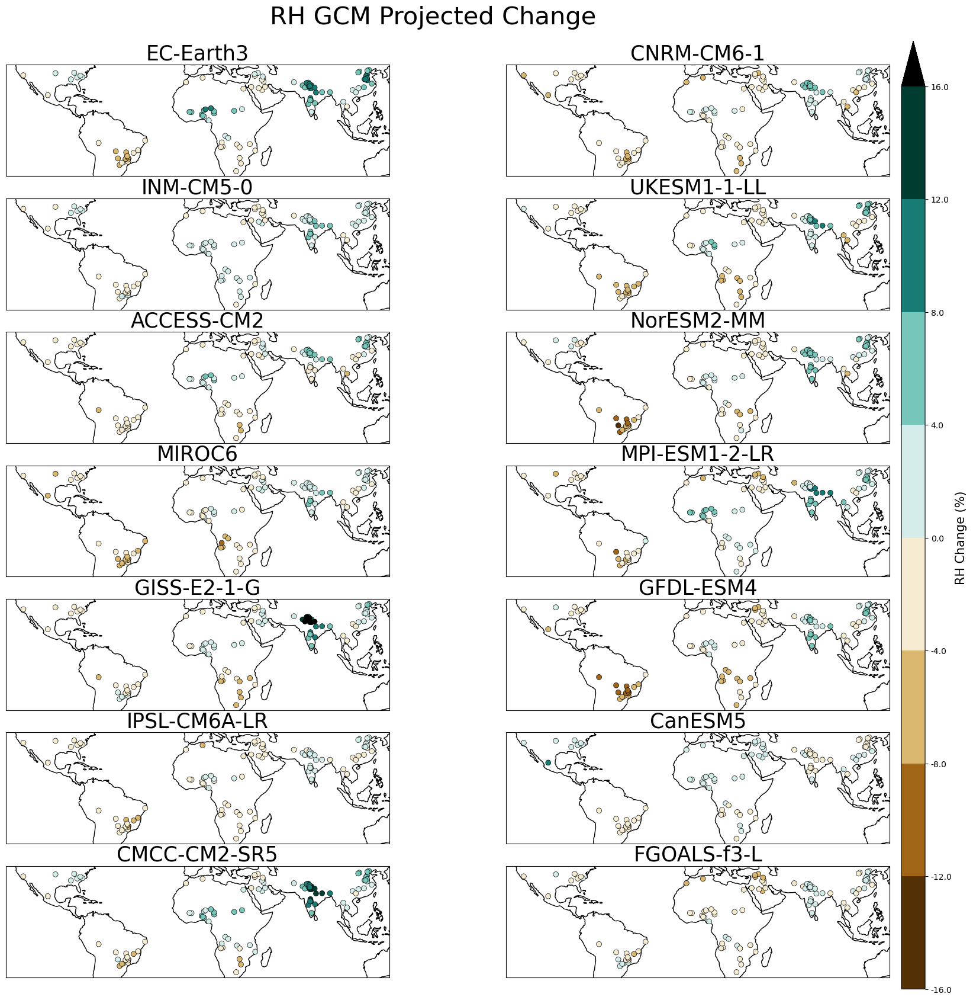

In [8]:
################################################################
######## CHANGES FOR EACH CLIMATE MODEL ########################
################################################################

climate_var = 'RH'
climate_var_units = '%'

#plt.rc('font', size=15)          # controls default text sizes
plt.rc('axes', titlesize=25)     # fontsize of the axes title
plt.rc('axes', labelsize=15)    # fontsize of the x and y labels
#plt.rc('xtick', labelsize=15)    # fontsize of the tick labels
#plt.rc('ytick', labelsize=15)    # fontsize of the tick labels
#plt.rc('legend', fontsize=20)    # legend fontsize
plt.rc('figure', titlesize=20)  # fontsize of the figure title

# create the colormap
scale_min = -16
scale_max = 16
cmap = plt.cm.BrBG  # define the colormap
# extract all colors from the .bwr map
cmaplist = [cmap(i) for i in range(cmap.N)]

# create the new map
cmap = mpl.colors.LinearSegmentedColormap.from_list(
    'Custom cmap', cmaplist, cmap.N)

cmap.set_over(color = 'black')

bounds = np.linspace(scale_min, scale_max, 9)
norm = mpl.colors.BoundaryNorm(bounds, cmap.N)


#create the axes
fig, axes = plt.subplots(7,2 ,figsize=(20,20), subplot_kw={"projection": ccrs.PlateCarree()})

plt.suptitle('{} GCM Projected Change'.format(climate_var), y = 0.93, fontsize = 30)

row_num = 0
col_num = 0
min_change = []
max_change = []
model_annual_change_df = pd.DataFrame()

for model in list(set(Climate_Proj_df.Model)):
    
    model_df = Climate_Proj_df[Climate_Proj_df.Model == model].copy()
     
    df = model_df.groupby(['CITY_COUNTRY']).mean(numeric_only = True).reset_index()
    CITY_COUNTRY_list = df.CITY_COUNTRY.values
    city_lats = df.Lat.values
    city_lons = df.Lon.values
    VAR_CHANGE = df['{}_Change'.format(climate_var)].values
    
    axes[row_num,col_num].coastlines()
    im = axes[row_num,col_num].scatter(city_lons, city_lats, zorder=5, c=VAR_CHANGE, linewidths = 0.5,
                                        s =40,edgecolor = 'black',cmap= cmap, norm = norm)
    
    
    axes[row_num,col_num].set(title = model)  
    
    model_annual_df = pd.DataFrame({'CITY_COUNTRY': CITY_COUNTRY_list, 'Lat':city_lats, 'Lon':city_lons,
                                   'Annual_Mean_{}_change'.format(climate_var): VAR_CHANGE})
    model_annual_df['Model'] = model
    model_annual_change_df = pd.concat([model_annual_change_df, model_annual_df])
    # move the col and row nums on for the next plot
    if col_num == 1:
        col_num = 0
        row_num = row_num + 1
    
    elif col_num == 0:
        col_num = 1

#get size and extent of axes:
axpos = axes[1,1].get_position()
pos_x = axpos.x0 + axpos.width +0.01  #+ 0.25*axpos.width
pos_y = 0.1
cax_width = 0.02
cax_height = 0.8 #2*axpos.height
#create new axes where the colorbar should go.
#it should be next to the original axes and have the same height
pos_cax = fig.add_axes([pos_x,pos_y,cax_width,cax_height])

fig.colorbar(im, cax = pos_cax,  label = 'RH Change (%)', cmap= cmap, norm=norm
            ,spacing='proportional', ticks=bounds, boundaries=bounds, format='%.1f', extend = 'max')   

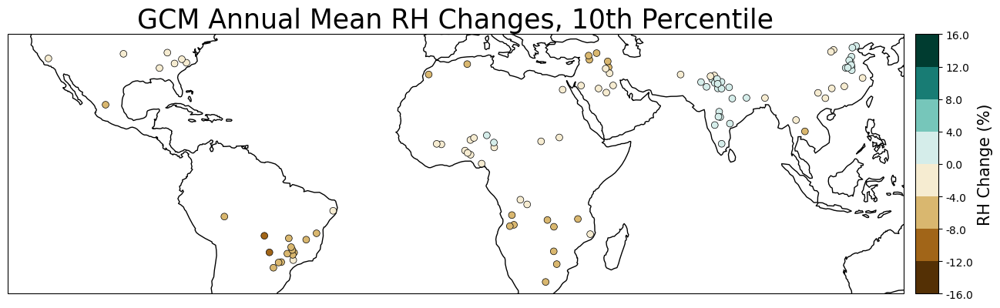

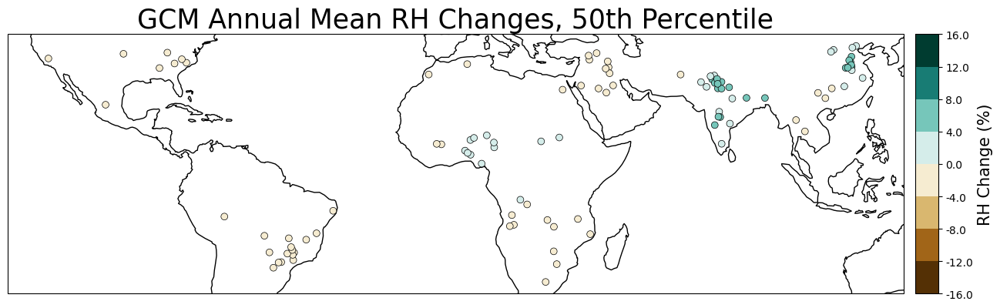

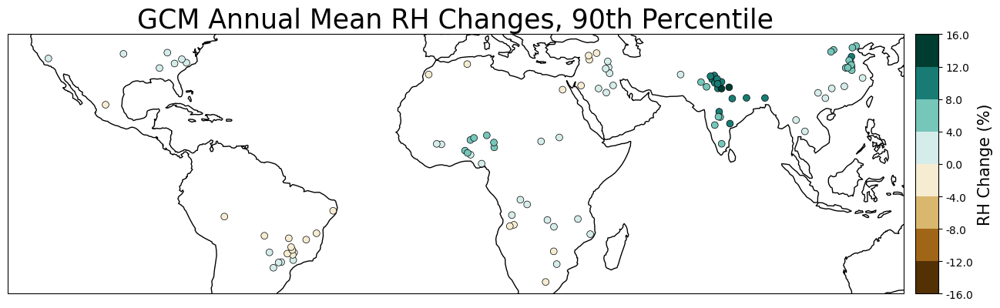

In [9]:
############################################################################
######## MODEL SPREAD: 10th, 50th, 90th Percentiles ########################
############################################################################

# get the median, 10th and 90th percentile changes
spread_df = pd.DataFrame ()
for i in range(len(CITY_COUNTRY_list)):
    CITY_COUNTRY = CITY_COUNTRY_list[i]
    var_changes = (model_annual_change_df[model_annual_change_df['CITY_COUNTRY'] == CITY_COUNTRY].
                Annual_Mean_RH_change)
    lat = (model_annual_change_df[model_annual_change_df['CITY_COUNTRY'] == CITY_COUNTRY].Lat.values[0])
    lon = (model_annual_change_df[model_annual_change_df['CITY_COUNTRY'] == CITY_COUNTRY].Lon.values[0])

    df = pd.DataFrame({'CITY_COUNTRY': [CITY_COUNTRY], 'Lat':[lat], 'Lon':[lon], 
              'median_var_change':[np.percentile(var_changes, 50)],
              'ten_percentile_var_change':[np.percentile(var_changes, 10)],
              'ninety_percentile_var_change':[np.percentile(var_changes, 90)]}, index = [i])

    spread_df = pd.concat([spread_df, df])

# create the colormap
scale_min = -16
scale_max = 16
cmap = plt.cm.BrBG  # define the colormap
# extract all colors from the .bwr map
cmaplist = [cmap(i) for i in range(cmap.N)]

# create the new map
cmap = mpl.colors.LinearSegmentedColormap.from_list(
    'Custom cmap', cmaplist, cmap.N)

cmap.set_over(color = 'black')

bounds = np.linspace(scale_min, scale_max, 9)
norm = mpl.colors.BoundaryNorm(bounds, cmap.N)

city_lats = spread_df.Lat.values
city_lons = spread_df.Lon.values
median_var_change = spread_df.median_var_change.values
ten_percentile_var_change = spread_df.ten_percentile_var_change.values
ninety_percentile_var_change = spread_df.ninety_percentile_var_change.values

####################################
fig = plt.figure(figsize=(15,10))
ax = plt.axes(projection=ccrs.PlateCarree(), title='GCM Annual Mean {} Changes, 10th Percentile'.format(climate_var))
ax.coastlines()

im = ax.scatter(city_lons, city_lats, zorder=5, c=ten_percentile_var_change, linewidths = 0.5, s =40,edgecolor = 'black',
               cmap= cmap, norm=norm)

#get size and extent of axes:
axpos = ax.get_position()
pos_x = axpos.x0 + axpos.width + 0.01 #+ 0.25*axpos.width
pos_y = axpos.y0  
cax_width = 0.02
cax_height = axpos.height
#create new axes where the colorbar should go.
#it should be next to the original axes and have the same height
pos_cax = fig.add_axes([pos_x,pos_y,cax_width,cax_height])

plt.colorbar(im, cax=pos_cax, label = '{} Change ({})'.format(climate_var, climate_var_units), cmap= cmap, norm=norm
            ,spacing='proportional', ticks=bounds, boundaries=bounds, format='%0.1f')

#save figure as png
os.chdir(os.path.join(et.io.HOME, 'Documents', 'Python_Scripts', 'PROJECT','Chapter_6','climate_projection_plots'))   
plt.savefig('{}_change_10_percentile.png'.format(climate_var), bbox_inches = 'tight')
####################################

fig = plt.figure(figsize=(15,10))
ax = plt.axes(projection=ccrs.PlateCarree(), title='GCM Annual Mean {} Changes, 50th Percentile'.format(climate_var))
ax.coastlines()

im = ax.scatter(city_lons, city_lats, zorder=5, c=median_var_change, linewidths = 0.5, s =40,edgecolor = 'black',
               cmap= cmap, norm=norm)

#get size and extent of axes:
axpos = ax.get_position()
pos_x = axpos.x0 + axpos.width + 0.01 #+ 0.25*axpos.width
pos_y = axpos.y0  
cax_width = 0.02
cax_height = axpos.height
#create new axes where the colorbar should go.
#it should be next to the original axes and have the same height
pos_cax = fig.add_axes([pos_x,pos_y,cax_width,cax_height])

plt.colorbar(im, cax=pos_cax, label = '{} Change ({})'.format(climate_var, climate_var_units), cmap= cmap, norm=norm
            ,spacing='proportional', ticks=bounds, boundaries=bounds, format='%0.1f')

#save figure as png
os.chdir(os.path.join(et.io.HOME, 'Documents', 'Python_Scripts', 'PROJECT','Chapter_6','climate_projection_plots'))   
plt.savefig('{}_change_50_percentile.png'.format(climate_var), bbox_inches = 'tight')
####################################

fig = plt.figure(figsize=(15,10))
ax = plt.axes(projection=ccrs.PlateCarree(), title='GCM Annual Mean {} Changes, 90th Percentile'.format(climate_var))
ax.coastlines()

im = ax.scatter(city_lons, city_lats, zorder=5, c=ninety_percentile_var_change, linewidths = 0.5, s =40,edgecolor = 'black',
               cmap= cmap, norm=norm)

#get size and extent of axes:
axpos = ax.get_position()
pos_x = axpos.x0 + axpos.width + 0.01 #+ 0.25*axpos.width
pos_y = axpos.y0  
cax_width = 0.02
cax_height = axpos.height
#create new axes where the colorbar should go.
#it should be next to the original axes and have the same height
pos_cax = fig.add_axes([pos_x,pos_y,cax_width,cax_height])

plt.colorbar(im, cax=pos_cax, label = '{} Change ({})'.format(climate_var, climate_var_units), cmap= cmap, norm=norm
            ,spacing='proportional', ticks=bounds, boundaries=bounds, format='%0.1f')

#save figure as png
os.chdir(os.path.join(et.io.HOME, 'Documents', 'Python_Scripts', 'PROJECT','Chapter_6','climate_projection_plots'))   
plt.savefig('{}_change_90_percentile.png'.format(climate_var), bbox_inches = 'tight')

In [10]:
spread_df.ten_percentile_var_change.min(), spread_df.ninety_percentile_var_change.max()

(-8.851011991500854, 13.861389255523687)

In [11]:
spread_df[spread_df.ninety_percentile_var_change > 13]

,CITY_COUNTRY,Lat,Lon,median_var_change,ten_percentile_var_change,ninety_percentile_var_change
58,MATHURA_INDIA,27.50000,77.68333,5.661558,1.173425,13.861389
84,SHAHJAHANPUR_INDIA,27.88333,79.91667,5.661558,1.173425,13.861389


In [12]:
# create a df with the annual range for each model
annual_range_df = pd.DataFrame()

for model in list(set(Climate_Proj_df.Model)):
    
    model_df = Climate_Proj_df[Climate_Proj_df.Model == model].copy()
    
    for i in range(len(CITY_COUNTRY_list)):
        CITY_COUNTRY = CITY_COUNTRY_list[i]
        lat = Climate_Proj_df[Climate_Proj_df.CITY_COUNTRY == CITY_COUNTRY].Lat.values[0]
        lon = Climate_Proj_df[Climate_Proj_df.CITY_COUNTRY == CITY_COUNTRY].Lon.values[0]
        rh_annual_range = (model_df[model_df.CITY_COUNTRY == CITY_COUNTRY].RH_Change.max() 
                 - model_df[model_df.CITY_COUNTRY == CITY_COUNTRY].RH_Change.min())

        tp_annual_range = (model_df[model_df.CITY_COUNTRY == CITY_COUNTRY].TP_Change.max() 
                 - model_df[model_df.CITY_COUNTRY == CITY_COUNTRY].TP_Change.min())
        
        df = pd.DataFrame({'CITY_COUNTRY': [CITY_COUNTRY], 'Lat':[lat], 'Lon':[lon], 
              'RH_Annual_Range':[rh_annual_range],'TP_Annual_Range':[tp_annual_range]},index = [i])
        
        df['Model'] = model
        
        annual_range_df = pd.concat([annual_range_df, df])
        
        
# get the median, 10th and 90th percentile for monthly ranges
percentiles_annual_range_df = pd.DataFrame()

for i in range(len(CITY_COUNTRY_list)):
    CITY_COUNTRY = CITY_COUNTRY_list[i]
    rh_var_changes = (annual_range_df[annual_range_df['CITY_COUNTRY'] == CITY_COUNTRY].
                RH_Annual_Range)
    tp_var_changes = (annual_range_df[annual_range_df['CITY_COUNTRY'] == CITY_COUNTRY].
                TP_Annual_Range)
    lat = (annual_range_df[annual_range_df['CITY_COUNTRY'] == CITY_COUNTRY].Lat.values[0])
    lon = (annual_range_df[annual_range_df['CITY_COUNTRY'] == CITY_COUNTRY].Lon.values[0])

    df = pd.DataFrame({'CITY_COUNTRY': [CITY_COUNTRY], 'Lat':[lat], 'Lon':[lon], 
              'median_rh_annual_change_range':[np.percentile(rh_var_changes, 50)],
              'ten_percentile_rh_annual_change_range':[np.percentile(rh_var_changes, 10)],
              'ninety_percentile_rh_annual_change_range':[np.percentile(rh_var_changes, 90)],
              'median_tp_annual_change_range':[np.percentile(tp_var_changes, 50)],
              'ten_percentile_tp_annual_change_range':[np.percentile(tp_var_changes, 10)],
              'ninety_percentile_tp_annual_change_range':[np.percentile(tp_var_changes, 90)]  
                      }, index = [i])

    percentiles_annual_range_df = pd.concat([percentiles_annual_range_df, df])


In [13]:
percentiles_annual_range_df

,CITY_COUNTRY,Lat,Lon,median_rh_annual_change_range,ten_percentile_rh_annual_change_range,ninety_percentile_rh_annual_change_range,median_tp_annual_change_range,ten_percentile_tp_annual_change_range,ninety_percentile_tp_annual_change_range
0,AKOLA_INDIA,20.733330,77.000000,9.767216,5.698873,18.104515,0.002649,0.000895,0.003416
1,ALWAR_INDIA,27.562460,76.625000,13.447297,9.141044,19.850263,0.001053,0.000487,0.002068
2,AL_OBEID_SUDAN,13.184167,30.216667,9.169180,3.952466,13.989155,0.001067,0.000382,0.001371
3,AL_RAQQA_SYRIA,35.950000,39.016670,7.192654,3.378769,9.820460,0.000414,0.000271,0.000549
4,ANAPOLIS_BRAZIL,-16.326670,-48.952780,11.191780,5.717167,16.932236,0.003330,0.002183,0.004267
...,...,...,...,...,...,...,...,...,...
99,YULIN_SHAANXI_CHINA,38.283840,109.731486,9.971323,6.072725,15.311057,0.001299,0.000888,0.002246
100,ZACATECAS_MEXICO,22.775590,-102.572180,7.915531,5.053861,11.164637,0.001576,0.001163,0.002404
101,ZHOUKOU_CHINA,33.617368,114.646126,7.620411,4.330161,13.687863,0.001539,0.000898,0.002188
102,ZHUOZHOU_CHINA,39.484559,115.978268,7.925037,5.165741,10.868064,0.001408,0.000689,0.001742


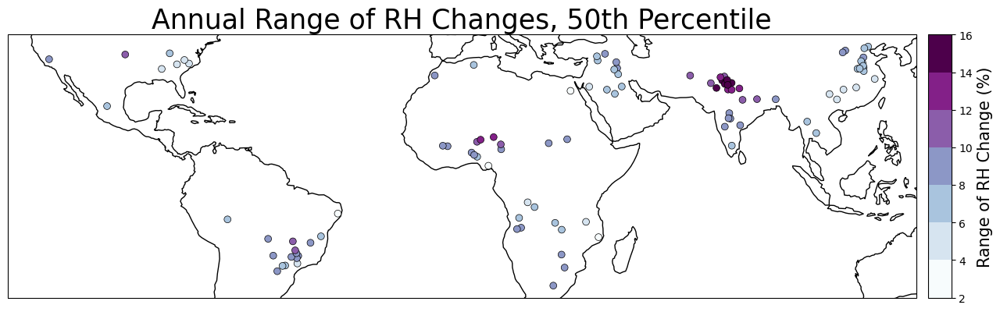

In [14]:
# create the colormap
scale_min = 2
scale_max = 16
cmap = plt.cm.BuPu  # define the colormap
# extract all colors from the .bwr map
cmaplist = [cmap(i) for i in range(cmap.N)]

# create the new map
cmap = mpl.colors.LinearSegmentedColormap.from_list(
    'Custom cmap', cmaplist, cmap.N)

cmap.set_over(color = 'black')

bounds = np.linspace(scale_min, scale_max, 8)
norm = mpl.colors.BoundaryNorm(bounds, cmap.N)

city_lats = percentiles_annual_range_df.Lat.values
city_lons = percentiles_annual_range_df.Lon.values
median_var_change = percentiles_annual_range_df.median_rh_annual_change_range.values
ten_percentile_var_change = percentiles_annual_range_df.ten_percentile_rh_annual_change_range.values
ninety_percentile_var_change = percentiles_annual_range_df.ninety_percentile_rh_annual_change_range.values

####################################
fig = plt.figure(figsize=(15,10))
ax = plt.axes(projection=ccrs.PlateCarree(), title='Annual Range of RH Changes, 50th Percentile')
ax.coastlines()

im = ax.scatter(city_lons, city_lats, zorder=5, c=median_var_change, linewidths = 0.5, s =40,edgecolor = 'black',
               cmap= cmap, norm=norm)

#get size and extent of axes:
axpos = ax.get_position()
pos_x = axpos.x0 + axpos.width + 0.01 #+ 0.25*axpos.width
pos_y = axpos.y0  
cax_width = 0.02
cax_height = axpos.height
#create new axes where the colorbar should go.
#it should be next to the original axes and have the same height
pos_cax = fig.add_axes([pos_x,pos_y,cax_width,cax_height])

plt.colorbar(im, cax=pos_cax, label = 'Range of {} Change ({})'.format(climate_var, climate_var_units), cmap= cmap, norm=norm
            ,spacing='proportional', ticks=bounds, boundaries=bounds, format='%1i')

#save figure as png
os.chdir(os.path.join(et.io.HOME, 'Documents', 'Python_Scripts', 'PROJECT','Chapter_6','climate_projection_plots'))   
plt.savefig('annual_range_{}_change_50_percentile.png'.format(climate_var), bbox_inches = 'tight')


In [15]:
median_var_change.min(), median_var_change.max()

(3.322704315185547, 15.992627143859863)

In [16]:
(Climate_Proj_df[Climate_Proj_df['CITY_COUNTRY'] == CITY_COUNTRY].RH_Change)

276      0.138748
277      0.445908
278      0.424561
279      0.344765
280      0.096817
           ...   
16507    2.107544
16508    2.218925
16509    4.167309
16510    1.940239
16511    0.280045
Name: RH_Change, Length: 168, dtype: float32

In [17]:
Climate_Proj_df

,CITY_COUNTRY,City,Lat,Lon,Model,Month,RH_Preind,RH_2002_2020,RH_Proj,RH_Proj_1deg,PR_Preind,PR_2002_2020,PR_Proj,PR_Proj_1deg,RH_Change,TP_Change
0,HUAMBO_ANGOLA,Huambo,-12.776110,15.739170,CanESM5,1,94.596405,94.179825,94.420326,94.399277,0.011067,0.010471,0.009789,0.010816,-0.176079,-0.001277
1,HUAMBO_ANGOLA,Huambo,-12.776110,15.739170,CanESM5,2,94.333801,94.252075,94.202370,94.122391,0.010655,0.010410,0.010067,0.009819,-0.131432,-0.000588
2,HUAMBO_ANGOLA,Huambo,-12.776110,15.739170,CanESM5,3,93.955772,93.773483,93.765587,93.570953,0.011271,0.011325,0.011736,0.010793,-0.190186,0.000466
3,HUAMBO_ANGOLA,Huambo,-12.776110,15.739170,CanESM5,4,93.597725,93.680397,93.530228,93.579697,0.007989,0.005856,0.005542,0.006786,-0.067497,-0.002447
4,HUAMBO_ANGOLA,Huambo,-12.776110,15.739170,CanESM5,5,93.175369,92.925613,93.084717,93.226906,0.000949,0.000892,0.000330,0.001080,-0.090652,-0.000620
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
17467,GREENVILLE_USA,Greenville,34.849805,277.602666,GFDL-ESM4,8,86.257561,83.028168,82.039330,83.488022,0.004652,0.003232,0.003762,0.003863,-4.218231,-0.000890
17468,GREENVILLE_USA,Greenville,34.849805,277.602666,GFDL-ESM4,9,86.509613,83.966080,81.688248,83.390167,0.003801,0.004092,0.003292,0.003051,-4.821365,-0.000508
17469,GREENVILLE_USA,Greenville,34.849805,277.602666,GFDL-ESM4,10,86.902245,84.993706,83.946121,85.364166,0.003470,0.003881,0.003509,0.003904,-2.956123,0.000039
17470,GREENVILLE_USA,Greenville,34.849805,277.602666,GFDL-ESM4,11,87.651474,86.864403,86.423767,86.964706,0.004136,0.003172,0.004651,0.004139,-1.227707,0.000515


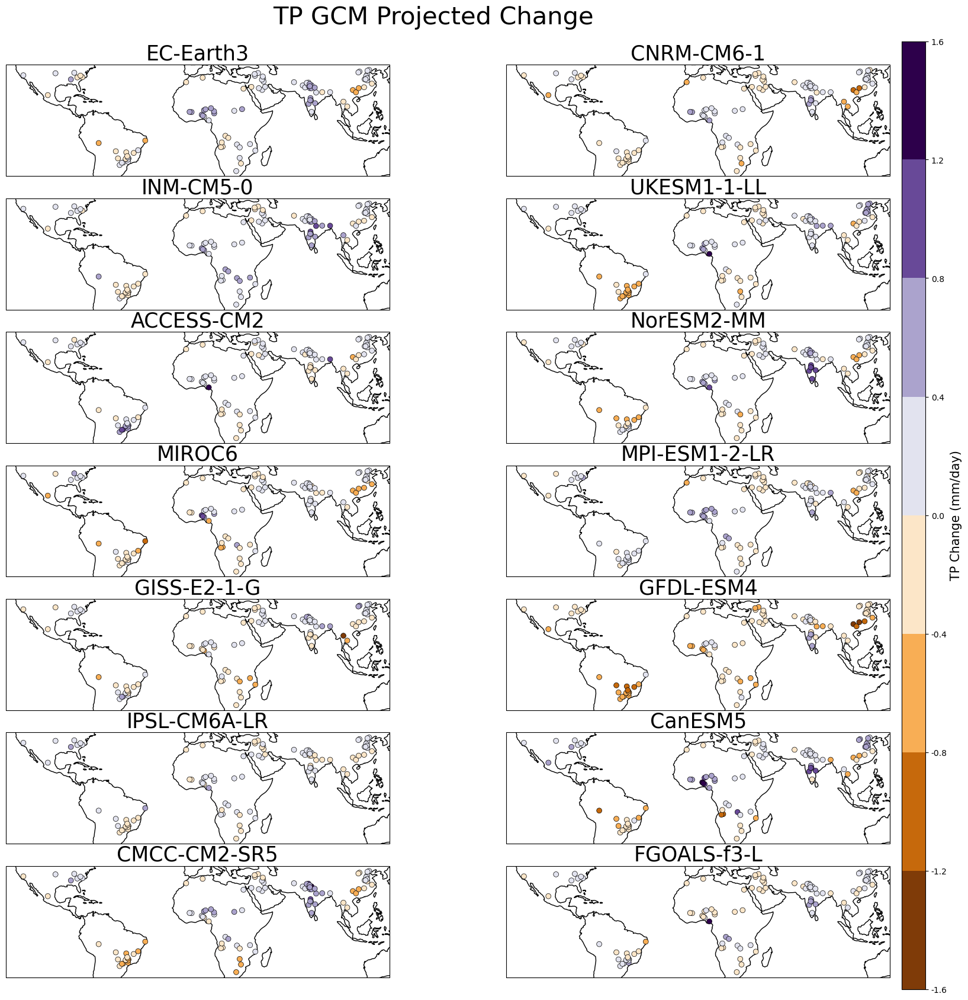

In [18]:
################################################################
######## CHANGES FOR EACH CLIMATE MODEL ########################
################################################################

climate_var = 'TP'
climate_var_units = 'mm/day'
# create the colormap
scale_min = -1.6
scale_max = 1.6
cmap = plt.cm.PuOr  # define the colormap
# extract all colors from the .bwr map
cmaplist = [cmap(i) for i in range(cmap.N)]

# create the new map
cmap = mpl.colors.LinearSegmentedColormap.from_list(
    'Custom cmap', cmaplist, cmap.N)

#cmap.set_over(color = 'black')

bounds = np.linspace(scale_min, scale_max, 9)
norm = mpl.colors.BoundaryNorm(bounds, cmap.N)

#create the axes
fig, axes = plt.subplots(7,2 ,figsize=(20,20), subplot_kw={"projection": ccrs.PlateCarree()})

plt.suptitle('{} GCM Projected Change'.format(climate_var), y = 0.93, fontsize = 30)

row_num = 0
col_num = 0
min_change = []
max_change = []
model_annual_change_df = pd.DataFrame()

for model in list(set(Climate_Proj_df.Model)):
    
    model_df = Climate_Proj_df[Climate_Proj_df.Model == model].copy()
     
    df = model_df.groupby(['CITY_COUNTRY']).mean(numeric_only = True).reset_index()
    #CITY_COUNTRY_list = df.CITY_COUNTRY.values
    city_lats = df.Lat.values
    city_lons = df.Lon.values
    VAR_CHANGE = 1000*df['{}_Change'.format(climate_var)].values
    CITY_COUNTRY_list = df.CITY_COUNTRY.values
    
    
    axes[row_num,col_num].coastlines()
    im = axes[row_num,col_num].scatter(city_lons, city_lats, zorder=5, c=VAR_CHANGE, linewidths = 0.5,
                                        s =40,edgecolor = 'black',cmap= cmap, norm = norm)
    
    
    axes[row_num,col_num].set(title = model)   
    
    model_annual_df = pd.DataFrame({'CITY_COUNTRY': CITY_COUNTRY_list, 'Lat':city_lats, 'Lon':city_lons,
                                   'Annual_Mean_{}_change'.format(climate_var): VAR_CHANGE})
    model_annual_df['Model'] = model
    model_annual_change_df = pd.concat([model_annual_change_df, model_annual_df])
    
    
    # move the col and row nums on for the next plot
    if col_num == 1:
        col_num = 0
        row_num = row_num + 1
    
    elif col_num == 0:
        col_num = 1

#get size and extent of axes:
axpos = axes[1,1].get_position()
pos_x = axpos.x0 + axpos.width +0.01  #+ 0.25*axpos.width
pos_y = 0.1
cax_width = 0.02
cax_height = 0.8 #2*axpos.height
#create new axes where the colorbar should go.
#it should be next to the original axes and have the same height
pos_cax = fig.add_axes([pos_x,pos_y,cax_width,cax_height])

fig.colorbar(im, cax = pos_cax,  label = 'TP Change (mm/day)', cmap= cmap, norm=norm
            ,spacing='proportional', ticks=bounds, boundaries=bounds, format='%.1f')   

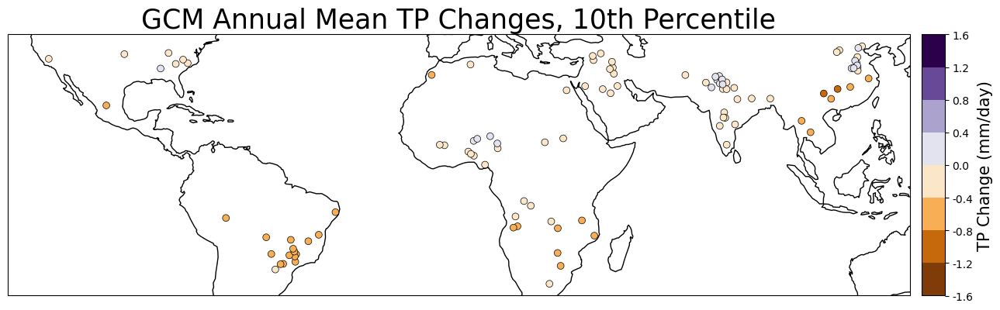

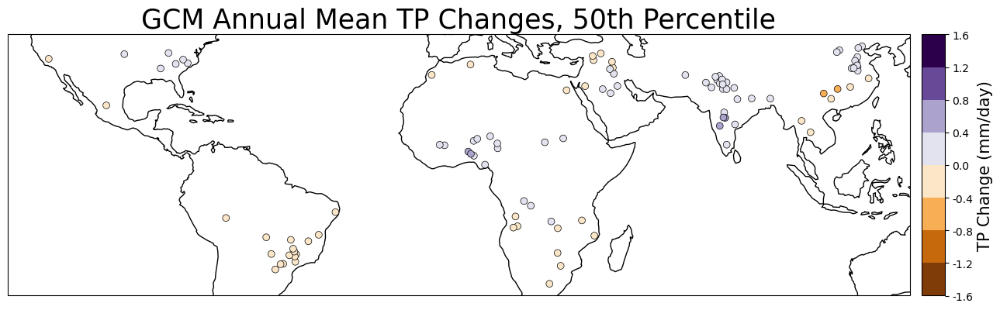

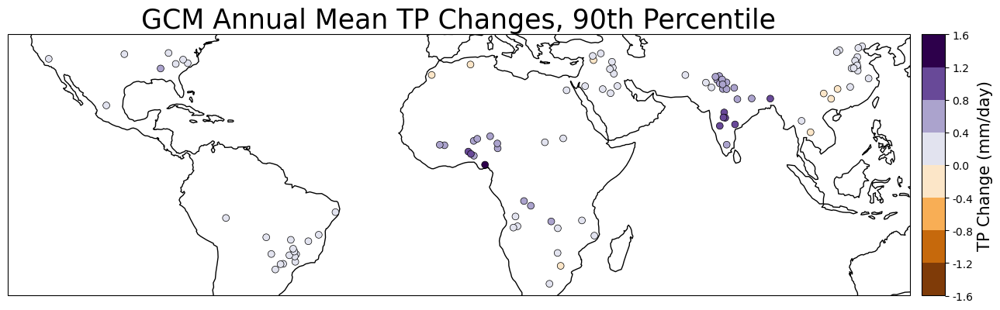

In [19]:
############################################################################
######## MODEL SPREAD: 10th, 50th, 90th Percentiles ########################
############################################################################

# get the median, 10th and 90th percentile changes
spread_df = pd.DataFrame ()
for i in range(len(CITY_COUNTRY_list)):
    CITY_COUNTRY = CITY_COUNTRY_list[i]
    var_changes = (model_annual_change_df[model_annual_change_df['CITY_COUNTRY'] == CITY_COUNTRY].
                Annual_Mean_TP_change)
    lat = (model_annual_change_df[model_annual_change_df['CITY_COUNTRY'] == CITY_COUNTRY].Lat.values[0])
    lon = (model_annual_change_df[model_annual_change_df['CITY_COUNTRY'] == CITY_COUNTRY].Lon.values[0])

    df = pd.DataFrame({'CITY_COUNTRY': [CITY_COUNTRY], 'Lat':[lat], 'Lon':[lon], 
              'median_var_change':[np.percentile(var_changes, 50)],
              'ten_percentile_var_change':[np.percentile(var_changes, 10)],
              'ninety_percentile_var_change':[np.percentile(var_changes, 90)]}, index = [i])

    spread_df = pd.concat([spread_df, df])

# create the colormap
scale_min = -1.6
scale_max = 1.6
cmap = plt.cm.PuOr  # define the colormap
# extract all colors from the .bwr map
cmaplist = [cmap(i) for i in range(cmap.N)]

# create the new map
cmap = mpl.colors.LinearSegmentedColormap.from_list(
    'Custom cmap', cmaplist, cmap.N)

bounds = np.linspace(scale_min, scale_max, 9)
norm = mpl.colors.BoundaryNorm(bounds, cmap.N)
#cmap.set_over(color = 'black')

city_lats = spread_df.Lat.values
city_lons = spread_df.Lon.values
median_var_change = spread_df.median_var_change.values
ten_percentile_var_change = spread_df.ten_percentile_var_change.values
ninety_percentile_var_change = spread_df.ninety_percentile_var_change.values

####################################
fig = plt.figure(figsize=(15,10))
ax = plt.axes(projection=ccrs.PlateCarree(), title='GCM Annual Mean {} Changes, 10th Percentile'.format(climate_var))
ax.coastlines()

im = ax.scatter(city_lons, city_lats, zorder=5, c=ten_percentile_var_change, linewidths = 0.5, s =40,edgecolor = 'black',
               cmap= cmap, norm=norm)

#get size and extent of axes:
axpos = ax.get_position()
pos_x = axpos.x0 + axpos.width + 0.01 #+ 0.25*axpos.width
pos_y = axpos.y0  
cax_width = 0.02
cax_height = axpos.height
#create new axes where the colorbar should go.
#it should be next to the original axes and have the same height
pos_cax = fig.add_axes([pos_x,pos_y,cax_width,cax_height])

plt.colorbar(im, cax=pos_cax, label = '{} Change ({})'.format(climate_var, climate_var_units), cmap= cmap, norm=norm
            ,spacing='proportional', ticks=bounds, boundaries=bounds, format='%0.1f')

#save figure as png
os.chdir(os.path.join(et.io.HOME, 'Documents', 'Python_Scripts', 'PROJECT','Chapter_6','climate_projection_plots'))   
plt.savefig('{}_change_10_percentile.png'.format(climate_var), bbox_inches = 'tight')
####################################

fig = plt.figure(figsize=(15,10))
ax = plt.axes(projection=ccrs.PlateCarree(), title='GCM Annual Mean {} Changes, 50th Percentile'.format(climate_var))
ax.coastlines()

im = ax.scatter(city_lons, city_lats, zorder=5, c=median_var_change, linewidths = 0.5, s =40,edgecolor = 'black',
               cmap= cmap, norm=norm)

#get size and extent of axes:
axpos = ax.get_position()
pos_x = axpos.x0 + axpos.width + 0.01 #+ 0.25*axpos.width
pos_y = axpos.y0  
cax_width = 0.02
cax_height = axpos.height
#create new axes where the colorbar should go.
#it should be next to the original axes and have the same height
pos_cax = fig.add_axes([pos_x,pos_y,cax_width,cax_height])

plt.colorbar(im, cax=pos_cax, label = '{} Change ({})'.format(climate_var, climate_var_units), cmap= cmap, norm=norm
            ,spacing='proportional', ticks=bounds, boundaries=bounds, format='%0.1f')

#save figure as png
os.chdir(os.path.join(et.io.HOME, 'Documents', 'Python_Scripts', 'PROJECT','Chapter_6','climate_projection_plots'))   
plt.savefig('{}_change_50_percentile.png'.format(climate_var), bbox_inches = 'tight')
####################################

fig = plt.figure(figsize=(15,10))
ax = plt.axes(projection=ccrs.PlateCarree(), title='GCM Annual Mean {} Changes, 90th Percentile'.format(climate_var))
ax.coastlines()

im = ax.scatter(city_lons, city_lats, zorder=5, c=ninety_percentile_var_change, linewidths = 0.5, s =40,edgecolor = 'black',
               cmap= cmap, norm=norm)

#get size and extent of axes:
axpos = ax.get_position()
pos_x = axpos.x0 + axpos.width + 0.01 #+ 0.25*axpos.width
pos_y = axpos.y0  
cax_width = 0.02
cax_height = axpos.height
#create new axes where the colorbar should go.
#it should be next to the original axes and have the same height
pos_cax = fig.add_axes([pos_x,pos_y,cax_width,cax_height])

plt.colorbar(im, cax=pos_cax, label = '{} Change ({})'.format(climate_var, climate_var_units), cmap= cmap, norm=norm
            ,spacing='proportional', ticks=bounds, boundaries=bounds, format='%0.1f')

#save figure as png
os.chdir(os.path.join(et.io.HOME, 'Documents', 'Python_Scripts', 'PROJECT','Chapter_6','climate_projection_plots'))   
plt.savefig('{}_change_90_percentile.png'.format(climate_var), bbox_inches = 'tight')

In [20]:
spread_df.ten_percentile_var_change.min(), spread_df.ninety_percentile_var_change.max()

(-0.8767894605989567, 1.4414165006746775)

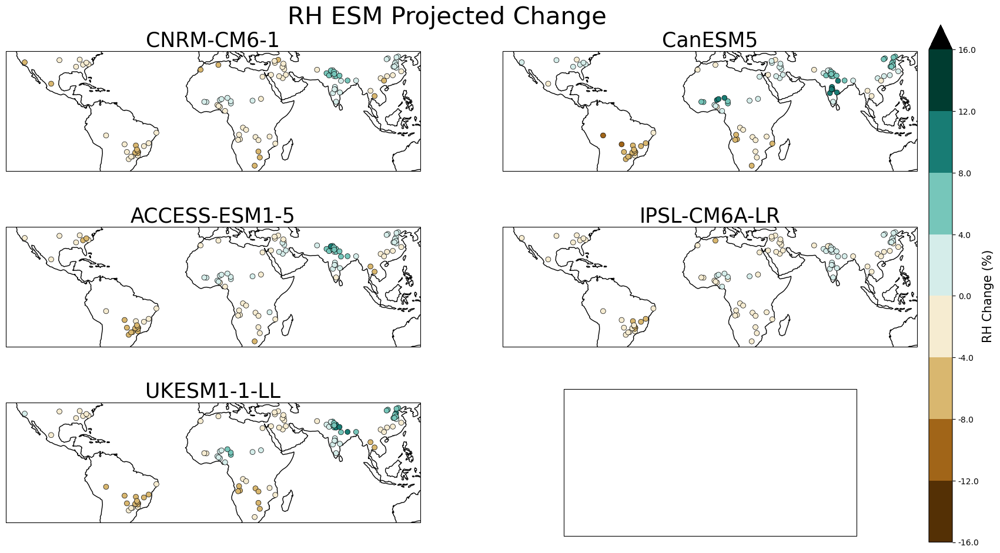

In [21]:
#####################################################################
######## CHANGES FOR EACH EARTH SYSTEM MODEL ########################
#####################################################################

climate_var = 'RH'
climate_var_units = '%'

#plt.rc('font', size=15)          # controls default text sizes
plt.rc('axes', titlesize=25)     # fontsize of the axes title
plt.rc('axes', labelsize=15)    # fontsize of the x and y labels
#plt.rc('xtick', labelsize=15)    # fontsize of the tick labels
#plt.rc('ytick', labelsize=15)    # fontsize of the tick labels
#plt.rc('legend', fontsize=20)    # legend fontsize
plt.rc('figure', titlesize=20)  # fontsize of the figure title

# create the colormap
scale_min = -16
scale_max = 16
cmap = plt.cm.BrBG  # define the colormap
# extract all colors from the .bwr map
cmaplist = [cmap(i) for i in range(cmap.N)]

# create the new map
cmap = mpl.colors.LinearSegmentedColormap.from_list(
    'Custom cmap', cmaplist, cmap.N)

cmap.set_over(color = 'black')

bounds = np.linspace(scale_min, scale_max, 9)
norm = mpl.colors.BoundaryNorm(bounds, cmap.N)


#create the axes
fig, axes = plt.subplots(3,2 ,figsize=(20,11), subplot_kw={"projection": ccrs.PlateCarree()})

plt.suptitle('{} ESM Projected Change'.format(climate_var), y = 0.93, fontsize = 30)

row_num = 0
col_num = 0
min_change = []
max_change = []
model_annual_change_df = pd.DataFrame()

for model in list(set(LAI_Proj_df2.Model)):
    
    model_df = LAI_Proj_df2[LAI_Proj_df2.Model == model].copy()
     
    df = model_df.groupby(['CITY_COUNTRY']).mean(numeric_only = True).reset_index()
    #CITY_COUNTRY_list = df.CITY_COUNTRY.values
    city_lats = df.Lat.values
    city_lons = df.Lon.values
    VAR_CHANGE = df['{}_Change'.format(climate_var)].values
    
    axes[row_num,col_num].coastlines()
    im = axes[row_num,col_num].scatter(city_lons, city_lats, zorder=5, c=VAR_CHANGE, linewidths = 0.5,
                                        s =40,edgecolor = 'black',cmap= cmap, norm = norm)
    
    
    axes[row_num,col_num].set(title = model)  
    
    model_annual_df = pd.DataFrame({'CITY_COUNTRY': CITY_COUNTRY_list, 'Lat':city_lats, 'Lon':city_lons,
                                   'Annual_Mean_{}_change'.format(climate_var): VAR_CHANGE})
    model_annual_df['Model'] = model
    model_annual_change_df = pd.concat([model_annual_change_df, model_annual_df])
    # move the col and row nums on for the next plot
    if col_num == 1:
        col_num = 0
        row_num = row_num + 1
    
    elif col_num == 0:
        col_num = 1

#get size and extent of axes:
axpos = axes[1,1].get_position()
pos_x = axpos.x0 + axpos.width +0.01  #+ 0.25*axpos.width
pos_y = 0.1
cax_width = 0.02
cax_height = 0.8 #2*axpos.height
#create new axes where the colorbar should go.
#it should be next to the original axes and have the same height
pos_cax = fig.add_axes([pos_x,pos_y,cax_width,cax_height])

fig.colorbar(im, cax = pos_cax,  label = 'RH Change (%)', cmap= cmap, norm=norm
            ,spacing='proportional', ticks=bounds, boundaries=bounds, format='%.1f', extend = 'max')   

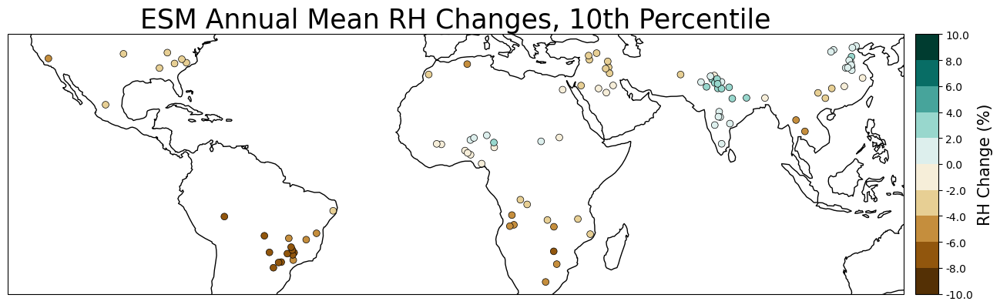

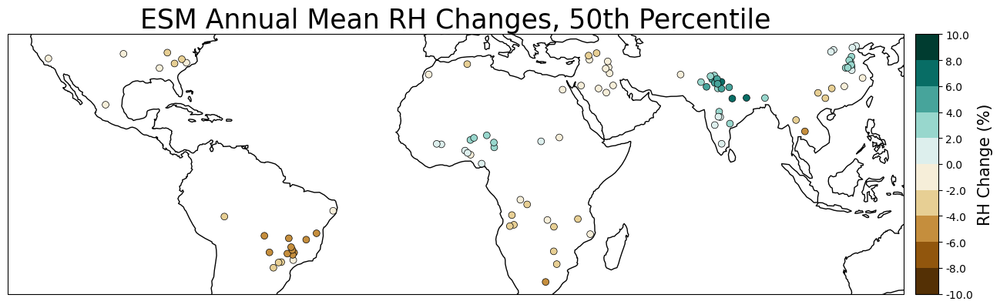

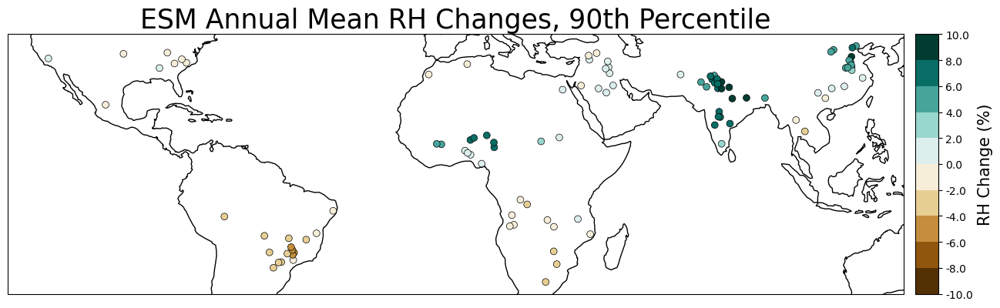

In [22]:
############################################################################
######## MODEL SPREAD: 10th, 50th, 90th Percentiles ########################
############################################################################

# get the median, 10th and 90th percentile changes
spread_df = pd.DataFrame ()
for i in range(len(CITY_COUNTRY_list)):
    CITY_COUNTRY = CITY_COUNTRY_list[i]
    var_changes = (model_annual_change_df[model_annual_change_df['CITY_COUNTRY'] == CITY_COUNTRY].
                Annual_Mean_RH_change)
    lat = (model_annual_change_df[model_annual_change_df['CITY_COUNTRY'] == CITY_COUNTRY].Lat.values[0])
    lon = (model_annual_change_df[model_annual_change_df['CITY_COUNTRY'] == CITY_COUNTRY].Lon.values[0])

    df = pd.DataFrame({'CITY_COUNTRY': [CITY_COUNTRY], 'Lat':[lat], 'Lon':[lon], 
              'median_var_change':[np.percentile(var_changes, 50)],
              'ten_percentile_var_change':[np.percentile(var_changes, 10)],
              'ninety_percentile_var_change':[np.percentile(var_changes, 90)]}, index = [i])

    spread_df = pd.concat([spread_df, df])

# create the colormap
scale_min = -10
scale_max = 10
cmap = plt.cm.BrBG  # define the colormap
# extract all colors from the .bwr map
cmaplist = [cmap(i) for i in range(cmap.N)]

# create the new map
cmap = mpl.colors.LinearSegmentedColormap.from_list(
    'Custom cmap', cmaplist, cmap.N)

bounds = np.linspace(scale_min, scale_max, 11)
norm = mpl.colors.BoundaryNorm(bounds, cmap.N)
#cmap.set_over(color = 'black')

city_lats = spread_df.Lat.values
city_lons = spread_df.Lon.values
median_var_change = spread_df.median_var_change.values
ten_percentile_var_change = spread_df.ten_percentile_var_change.values
ninety_percentile_var_change = spread_df.ninety_percentile_var_change.values

####################################
fig = plt.figure(figsize=(15,10))
ax = plt.axes(projection=ccrs.PlateCarree(), title='ESM Annual Mean {} Changes, 10th Percentile'.format(climate_var))
ax.coastlines()

im = ax.scatter(city_lons, city_lats, zorder=5, c=ten_percentile_var_change, linewidths = 0.5, s =40,edgecolor = 'black',
               cmap= cmap, norm=norm)

#get size and extent of axes:
axpos = ax.get_position()
pos_x = axpos.x0 + axpos.width + 0.01 #+ 0.25*axpos.width
pos_y = axpos.y0  
cax_width = 0.02
cax_height = axpos.height
#create new axes where the colorbar should go.
#it should be next to the original axes and have the same height
pos_cax = fig.add_axes([pos_x,pos_y,cax_width,cax_height])

plt.colorbar(im, cax=pos_cax, label = '{} Change ({})'.format(climate_var, climate_var_units), cmap= cmap, norm=norm
            ,spacing='proportional', ticks=bounds, boundaries=bounds, format='%0.1f')

#save figure as png
os.chdir(os.path.join(et.io.HOME, 'Documents', 'Python_Scripts', 'PROJECT','Chapter_6','climate_projection_plots'))   
plt.savefig('esm_{}_change_10_percentile.png'.format(climate_var), bbox_inches = 'tight')
####################################

fig = plt.figure(figsize=(15,10))
ax = plt.axes(projection=ccrs.PlateCarree(), title='ESM Annual Mean {} Changes, 50th Percentile'.format(climate_var))
ax.coastlines()

im = ax.scatter(city_lons, city_lats, zorder=5, c=median_var_change, linewidths = 0.5, s =40,edgecolor = 'black',
               cmap= cmap, norm=norm)

#get size and extent of axes:
axpos = ax.get_position()
pos_x = axpos.x0 + axpos.width + 0.01 #+ 0.25*axpos.width
pos_y = axpos.y0  
cax_width = 0.02
cax_height = axpos.height
#create new axes where the colorbar should go.
#it should be next to the original axes and have the same height
pos_cax = fig.add_axes([pos_x,pos_y,cax_width,cax_height])

plt.colorbar(im, cax=pos_cax, label = '{} Change ({})'.format(climate_var, climate_var_units), cmap= cmap, norm=norm
            ,spacing='proportional', ticks=bounds, boundaries=bounds, format='%0.1f')

#save figure as png
os.chdir(os.path.join(et.io.HOME, 'Documents', 'Python_Scripts', 'PROJECT','Chapter_6','climate_projection_plots'))   
plt.savefig('esm_{}_change_50_percentile.png'.format(climate_var), bbox_inches = 'tight')
####################################

fig = plt.figure(figsize=(15,10))
ax = plt.axes(projection=ccrs.PlateCarree(), title='ESM Annual Mean {} Changes, 90th Percentile'.format(climate_var))
ax.coastlines()

im = ax.scatter(city_lons, city_lats, zorder=5, c=ninety_percentile_var_change, linewidths = 0.5, s =40,edgecolor = 'black',
               cmap= cmap, norm=norm)

#get size and extent of axes:
axpos = ax.get_position()
pos_x = axpos.x0 + axpos.width + 0.01 #+ 0.25*axpos.width
pos_y = axpos.y0  
cax_width = 0.02
cax_height = axpos.height
#create new axes where the colorbar should go.
#it should be next to the original axes and have the same height
pos_cax = fig.add_axes([pos_x,pos_y,cax_width,cax_height])

plt.colorbar(im, cax=pos_cax, label = '{} Change ({})'.format(climate_var, climate_var_units), cmap= cmap, norm=norm
            ,spacing='proportional', ticks=bounds, boundaries=bounds, format='%0.1f')

#save figure as png
os.chdir(os.path.join(et.io.HOME, 'Documents', 'Python_Scripts', 'PROJECT','Chapter_6','climate_projection_plots'))   
plt.savefig('esm_{}_change_90_percentile.png'.format(climate_var), bbox_inches = 'tight')

In [23]:
spread_df.ten_percentile_var_change.min(), spread_df.ninety_percentile_var_change.max() 

(-7.996720441182454, 9.253482405344647)

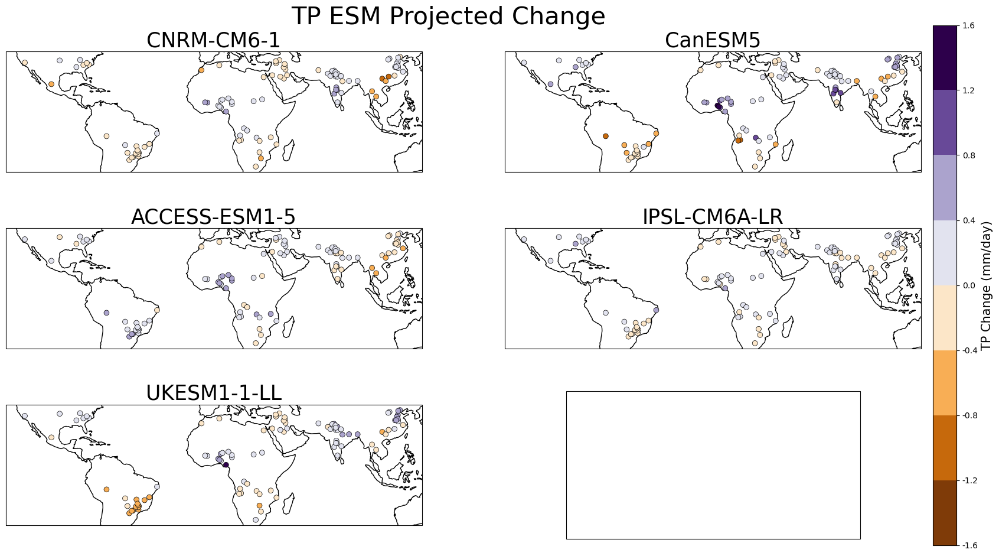

In [24]:
#####################################################################
######## CHANGES FOR EACH EARTH SYSTEM MODEL ########################
#####################################################################

climate_var = 'TP'
climate_var_units = 'mm/day'

#plt.rc('font', size=15)          # controls default text sizes
plt.rc('axes', titlesize=25)     # fontsize of the axes title
plt.rc('axes', labelsize=15)    # fontsize of the x and y labels
#plt.rc('xtick', labelsize=15)    # fontsize of the tick labels
#plt.rc('ytick', labelsize=15)    # fontsize of the tick labels
#plt.rc('legend', fontsize=20)    # legend fontsize
plt.rc('figure', titlesize=20)  # fontsize of the figure title

# create the colormap
scale_min = -1.6
scale_max = 1.6
cmap = plt.cm.PuOr  # define the colormap
# extract all colors from the .bwr map
cmaplist = [cmap(i) for i in range(cmap.N)]

# create the new map
cmap = mpl.colors.LinearSegmentedColormap.from_list(
    'Custom cmap', cmaplist, cmap.N)

cmap.set_over(color = 'black')

bounds = np.linspace(scale_min, scale_max, 9)
norm = mpl.colors.BoundaryNorm(bounds, cmap.N)


#create the axes
fig, axes = plt.subplots(3,2 ,figsize=(20,11), subplot_kw={"projection": ccrs.PlateCarree()})

plt.suptitle('{} ESM Projected Change'.format(climate_var), y = 0.93, fontsize = 30)

row_num = 0
col_num = 0
min_change = []
max_change = []
model_annual_change_df = pd.DataFrame()

for model in list(set(LAI_Proj_df2.Model)):
    
    model_df = LAI_Proj_df2[LAI_Proj_df2.Model == model].copy()
     
    df = model_df.groupby(['CITY_COUNTRY']).mean(numeric_only = True).reset_index()
    #CITY_COUNTRY_list = df.CITY_COUNTRY.values
    city_lats = df.Lat.values
    city_lons = df.Lon.values
    VAR_CHANGE = 1000*df['{}_Change'.format(climate_var)].values
    
    axes[row_num,col_num].coastlines()
    im = axes[row_num,col_num].scatter(city_lons, city_lats, zorder=5, c=VAR_CHANGE, linewidths = 0.5,
                                        s =40,edgecolor = 'black',cmap= cmap, norm = norm)
    
    
    axes[row_num,col_num].set(title = model)  
    
    model_annual_df = pd.DataFrame({'CITY_COUNTRY': CITY_COUNTRY_list, 'Lat':city_lats, 'Lon':city_lons,
                                   'Annual_Mean_{}_change'.format(climate_var): VAR_CHANGE})
    model_annual_df['Model'] = model
    model_annual_change_df = pd.concat([model_annual_change_df, model_annual_df])
    # move the col and row nums on for the next plot
    if col_num == 1:
        col_num = 0
        row_num = row_num + 1
    
    elif col_num == 0:
        col_num = 1

#get size and extent of axes:
axpos = axes[1,1].get_position()
pos_x = axpos.x0 + axpos.width +0.01  #+ 0.25*axpos.width
pos_y = 0.1
cax_width = 0.02
cax_height = 0.8 #2*axpos.height
#create new axes where the colorbar should go.
#it should be next to the original axes and have the same height
pos_cax = fig.add_axes([pos_x,pos_y,cax_width,cax_height])

fig.colorbar(im, cax = pos_cax,  label = '{} Change ({})'.format(climate_var, climate_var_units), cmap= cmap, norm=norm
            ,spacing='proportional', ticks=bounds, boundaries=bounds, format='%.1f')   

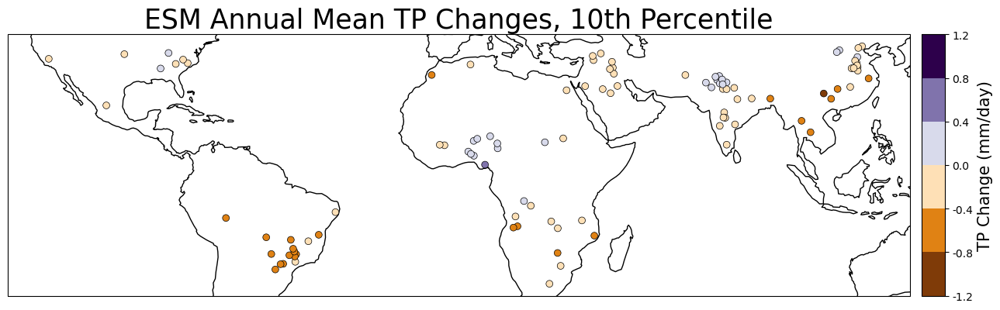

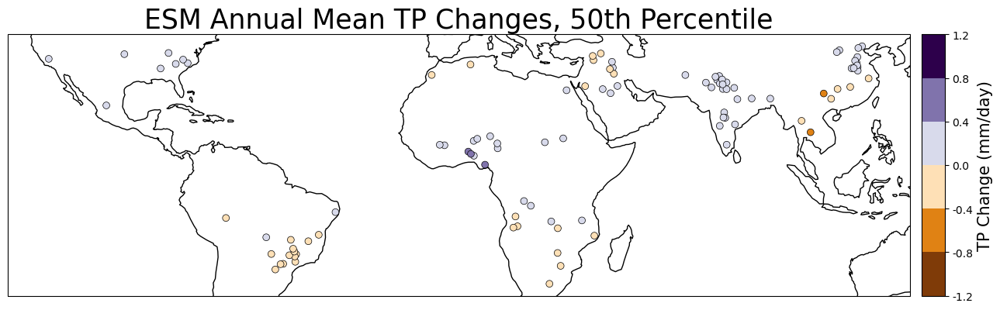

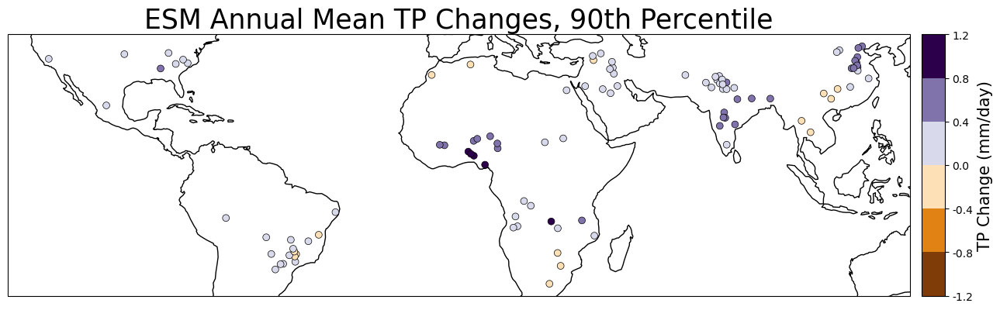

In [25]:
############################################################################
######## MODEL SPREAD: 10th, 50th, 90th Percentiles ########################
############################################################################

# get the median, 10th and 90th percentile changes
spread_df = pd.DataFrame ()
for i in range(len(CITY_COUNTRY_list)):
    CITY_COUNTRY = CITY_COUNTRY_list[i]
    var_changes = (model_annual_change_df[model_annual_change_df['CITY_COUNTRY'] == CITY_COUNTRY].
                Annual_Mean_TP_change)
    lat = (model_annual_change_df[model_annual_change_df['CITY_COUNTRY'] == CITY_COUNTRY].Lat.values[0])
    lon = (model_annual_change_df[model_annual_change_df['CITY_COUNTRY'] == CITY_COUNTRY].Lon.values[0])

    df = pd.DataFrame({'CITY_COUNTRY': [CITY_COUNTRY], 'Lat':[lat], 'Lon':[lon], 
              'median_var_change':[np.percentile(var_changes, 50)],
              'ten_percentile_var_change':[np.percentile(var_changes, 10)],
              'ninety_percentile_var_change':[np.percentile(var_changes, 90)]}, index = [i])

    spread_df = pd.concat([spread_df, df])

# create the colormap
scale_min = -1.2
scale_max = 1.2
cmap = plt.cm.PuOr  # define the colormap
# extract all colors from the .bwr map
cmaplist = [cmap(i) for i in range(cmap.N)]

# create the new map
cmap = mpl.colors.LinearSegmentedColormap.from_list(
    'Custom cmap', cmaplist, cmap.N)

bounds = np.linspace(scale_min, scale_max, 7)
norm = mpl.colors.BoundaryNorm(bounds, cmap.N)
#cmap.set_over(color = 'black')

city_lats = spread_df.Lat.values
city_lons = spread_df.Lon.values
median_var_change = spread_df.median_var_change.values
ten_percentile_var_change = spread_df.ten_percentile_var_change.values
ninety_percentile_var_change = spread_df.ninety_percentile_var_change.values

####################################
fig = plt.figure(figsize=(15,10))
ax = plt.axes(projection=ccrs.PlateCarree(), title='ESM Annual Mean {} Changes, 10th Percentile'.format(climate_var))
ax.coastlines()

im = ax.scatter(city_lons, city_lats, zorder=5, c=ten_percentile_var_change, linewidths = 0.5, s =40,edgecolor = 'black',
               cmap= cmap, norm=norm)

#get size and extent of axes:
axpos = ax.get_position()
pos_x = axpos.x0 + axpos.width + 0.01 #+ 0.25*axpos.width
pos_y = axpos.y0  
cax_width = 0.02
cax_height = axpos.height
#create new axes where the colorbar should go.
#it should be next to the original axes and have the same height
pos_cax = fig.add_axes([pos_x,pos_y,cax_width,cax_height])

plt.colorbar(im, cax=pos_cax, label = '{} Change ({})'.format(climate_var, climate_var_units), cmap= cmap, norm=norm
            ,spacing='proportional', ticks=bounds, boundaries=bounds, format='%0.1f')

#save figure as png
os.chdir(os.path.join(et.io.HOME, 'Documents', 'Python_Scripts', 'PROJECT','Chapter_6','climate_projection_plots'))   
plt.savefig('esm_{}_change_10_percentile.png'.format(climate_var), bbox_inches = 'tight')
####################################

fig = plt.figure(figsize=(15,10))
ax = plt.axes(projection=ccrs.PlateCarree(), title='ESM Annual Mean {} Changes, 50th Percentile'.format(climate_var))
ax.coastlines()

im = ax.scatter(city_lons, city_lats, zorder=5, c=median_var_change, linewidths = 0.5, s =40,edgecolor = 'black',
               cmap= cmap, norm=norm)

#get size and extent of axes:
axpos = ax.get_position()
pos_x = axpos.x0 + axpos.width + 0.01 #+ 0.25*axpos.width
pos_y = axpos.y0  
cax_width = 0.02
cax_height = axpos.height
#create new axes where the colorbar should go.
#it should be next to the original axes and have the same height
pos_cax = fig.add_axes([pos_x,pos_y,cax_width,cax_height])

plt.colorbar(im, cax=pos_cax, label = '{} Change ({})'.format(climate_var, climate_var_units), cmap= cmap, norm=norm
            ,spacing='proportional', ticks=bounds, boundaries=bounds, format='%0.1f')

#save figure as png
os.chdir(os.path.join(et.io.HOME, 'Documents', 'Python_Scripts', 'PROJECT','Chapter_6','climate_projection_plots'))   
plt.savefig('esm_{}_change_50_percentile.png'.format(climate_var), bbox_inches = 'tight')
####################################

fig = plt.figure(figsize=(15,10))
ax = plt.axes(projection=ccrs.PlateCarree(), title='ESM Annual Mean {} Changes, 90th Percentile'.format(climate_var))
ax.coastlines()

im = ax.scatter(city_lons, city_lats, zorder=5, c=ninety_percentile_var_change, linewidths = 0.5, s =40,edgecolor = 'black',
               cmap= cmap, norm=norm)

#get size and extent of axes:
axpos = ax.get_position()
pos_x = axpos.x0 + axpos.width + 0.01 #+ 0.25*axpos.width
pos_y = axpos.y0  
cax_width = 0.02
cax_height = axpos.height
#create new axes where the colorbar should go.
#it should be next to the original axes and have the same height
pos_cax = fig.add_axes([pos_x,pos_y,cax_width,cax_height])

plt.colorbar(im, cax=pos_cax, label = '{} Change ({})'.format(climate_var, climate_var_units), cmap= cmap, norm=norm
            ,spacing='proportional', ticks=bounds, boundaries=bounds, format='%0.1f')

#save figure as png
os.chdir(os.path.join(et.io.HOME, 'Documents', 'Python_Scripts', 'PROJECT','Chapter_6','climate_projection_plots'))   
plt.savefig('esm_{}_change_90_percentile.png'.format(climate_var), bbox_inches = 'tight')

In [26]:
spread_df.ten_percentile_var_change.min(), spread_df.ninety_percentile_var_change.max() 

(-0.8599155658157541, 1.228602163027972)

In [27]:
LAI_Proj_df2

,CITY_COUNTRY,City,Lat,Lon,Model,Month,LAI_Preind,LAI_2002_2020,LAI_Proj,LAI_Proj_1deg,...,RH_Proj,RH_Proj_1deg,PR_Preind,PR_2002_2020,PR_Proj,PR_Proj_1deg,LAI_Change,RH_Change,TP_Change,LAI_fract_change
0,HUAMBO_ANGOLA,Huambo,-12.776110,15.739170,CanESM5,1,2.971749,3.800678,3.737065,3.726022,...,86.444023,85.823738,0.011067,0.010471,0.009789,845.798357,0.765317,-1.997162,-0.001277,0.204791
1,HUAMBO_ANGOLA,Huambo,-12.776110,15.739170,CanESM5,2,3.705504,4.880583,4.916813,4.733503,...,84.813988,88.107399,0.010655,0.01041,0.010067,869.745886,1.211309,-3.363640,-0.000588,0.246361
2,HUAMBO_ANGOLA,Huambo,-12.776110,15.739170,CanESM5,3,4.332635,5.747438,5.955128,5.586876,...,88.641205,88.648933,0.011271,0.011325,0.011736,1014.028248,1.622492,-0.223465,0.000466,0.272453
3,HUAMBO_ANGOLA,Huambo,-12.776110,15.739170,CanESM5,4,4.739583,6.272847,6.554973,6.161581,...,85.978264,87.627708,0.007989,0.005856,0.005542,478.799793,1.815390,-2.568367,-0.002447,0.276948
4,HUAMBO_ANGOLA,Huambo,-12.776110,15.739170,CanESM5,5,4.901753,6.585481,6.798827,6.457642,...,79.145447,81.78006,0.000949,0.000892,0.00033,28.492416,1.897073,-2.764252,-0.000620,0.279030
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6235,GREENVILLE_USA,Greenville,34.849805,-82.397334,UKESM1-1-LL,8,4.135257,3.846841,3.887672,3.851831,...,69.10231,69.151237,0.005031,0.003952,0.005075,438.490712,-0.247584,-5.317375,0.000044,-0.063684
6236,GREENVILLE_USA,Greenville,34.849805,-82.397334,UKESM1-1-LL,9,4.123365,3.818346,3.865065,3.825773,...,72.110741,68.676727,0.003701,0.002296,0.00326,281.64652,-0.258300,-3.368294,-0.000441,-0.066829
6237,GREENVILLE_USA,Greenville,34.849805,-82.397334,UKESM1-1-LL,10,4.050605,3.779519,3.855743,3.780959,...,74.563423,69.900513,0.002834,0.003189,0.003165,273.415856,-0.194862,0.249611,0.000330,-0.050538
6238,GREENVILLE_USA,Greenville,34.849805,-82.397334,UKESM1-1-LL,11,3.794506,3.576815,3.710779,3.579571,...,76.884537,76.323929,0.002989,0.003082,0.003138,271.123638,-0.083728,0.276787,0.000149,-0.022563


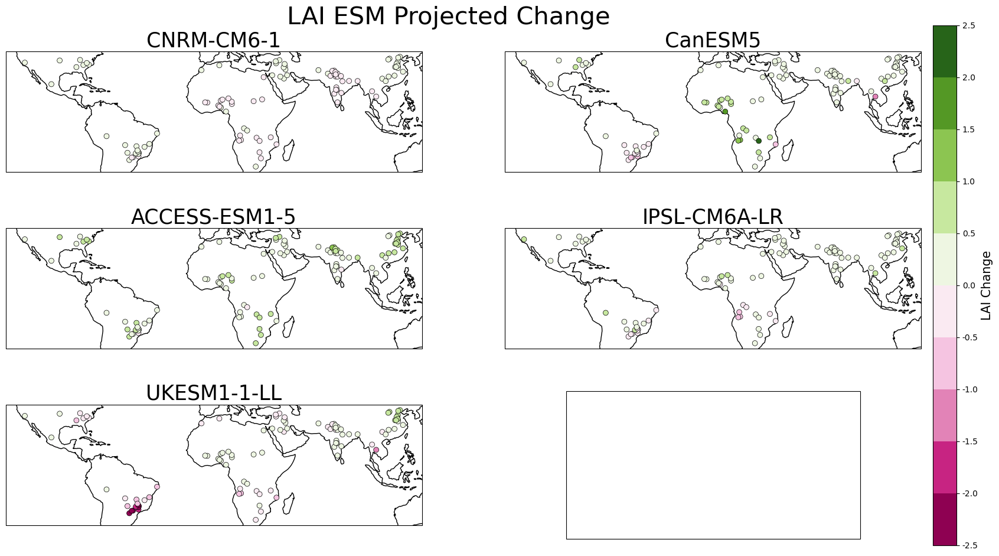

In [28]:
#####################################################################
######## CHANGES FOR EACH EARTH SYSTEM MODEL ########################
#####################################################################

climate_var = 'LAI'
climate_var_units = ''

#plt.rc('font', size=15)          # controls default text sizes
plt.rc('axes', titlesize=25)     # fontsize of the axes title
plt.rc('axes', labelsize=15)    # fontsize of the x and y labels
#plt.rc('xtick', labelsize=15)    # fontsize of the tick labels
#plt.rc('ytick', labelsize=15)    # fontsize of the tick labels
#plt.rc('legend', fontsize=20)    # legend fontsize
plt.rc('figure', titlesize=20)  # fontsize of the figure title

# create the colormap
scale_min = -2.5
scale_max = 2.5
cmap = plt.cm.PiYG  # define the colormap
# extract all colors from the .bwr map
cmaplist = [cmap(i) for i in range(cmap.N)]

# create the new map
cmap = mpl.colors.LinearSegmentedColormap.from_list(
    'Custom cmap', cmaplist, cmap.N)

cmap.set_over(color = 'black')

bounds = np.linspace(scale_min, scale_max, 11)
norm = mpl.colors.BoundaryNorm(bounds, cmap.N)


#create the axes
fig, axes = plt.subplots(3,2 ,figsize=(20,11), subplot_kw={"projection": ccrs.PlateCarree()})

plt.suptitle('{} ESM Projected Change'.format(climate_var), y = 0.93, fontsize = 30)

row_num = 0
col_num = 0
min_change = []
max_change = []
model_annual_change_df = pd.DataFrame()

for model in list(set(LAI_Proj_df2.Model)):
    
    model_df = LAI_Proj_df2[LAI_Proj_df2.Model == model].copy()
     
    df = model_df.groupby(['CITY_COUNTRY']).mean(numeric_only = True).reset_index()
    #CITY_COUNTRY_list = df.CITY_COUNTRY.values
    city_lats = df.Lat.values
    city_lons = df.Lon.values
    VAR_CHANGE = df['{}_Change'.format(climate_var)].values
    
    axes[row_num,col_num].coastlines()
    im = axes[row_num,col_num].scatter(city_lons, city_lats, zorder=5, c=VAR_CHANGE, linewidths = 0.5,
                                        s =40,edgecolor = 'black',cmap= cmap, norm = norm)
    
    
    axes[row_num,col_num].set(title = model)  
    
    model_annual_df = pd.DataFrame({'CITY_COUNTRY': CITY_COUNTRY_list, 'Lat':city_lats, 'Lon':city_lons,
                                   'Annual_Mean_{}_change'.format(climate_var): VAR_CHANGE})
    model_annual_df['Model'] = model
    model_annual_change_df = pd.concat([model_annual_change_df, model_annual_df])
    # move the col and row nums on for the next plot
    if col_num == 1:
        col_num = 0
        row_num = row_num + 1
    
    elif col_num == 0:
        col_num = 1

#get size and extent of axes:
axpos = axes[1,1].get_position()
pos_x = axpos.x0 + axpos.width +0.01  #+ 0.25*axpos.width
pos_y = 0.1
cax_width = 0.02
cax_height = 0.8 #2*axpos.height
#create new axes where the colorbar should go.
#it should be next to the original axes and have the same height
pos_cax = fig.add_axes([pos_x,pos_y,cax_width,cax_height])

fig.colorbar(im, cax = pos_cax,  label = '{} Change'.format(climate_var), cmap= cmap, norm=norm
            ,spacing='proportional', ticks=bounds, boundaries=bounds, format='%.1f')   

In [29]:
model_annual_change_df.Annual_Mean_LAI_change.min(), model_annual_change_df.Annual_Mean_LAI_change.max()

(-2.2181453704833984, 2.1963961124420166)

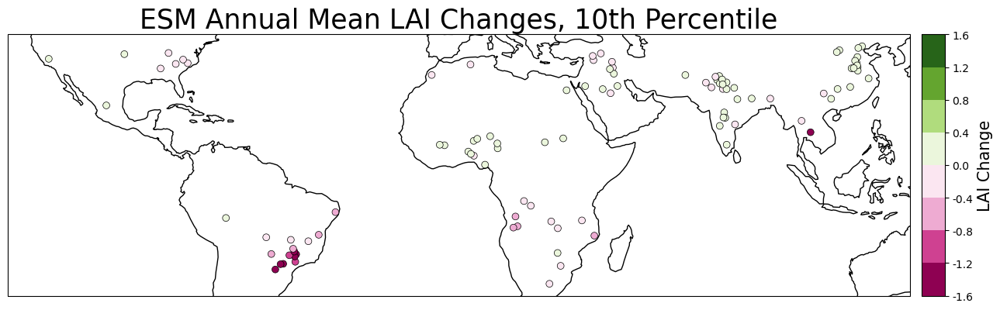

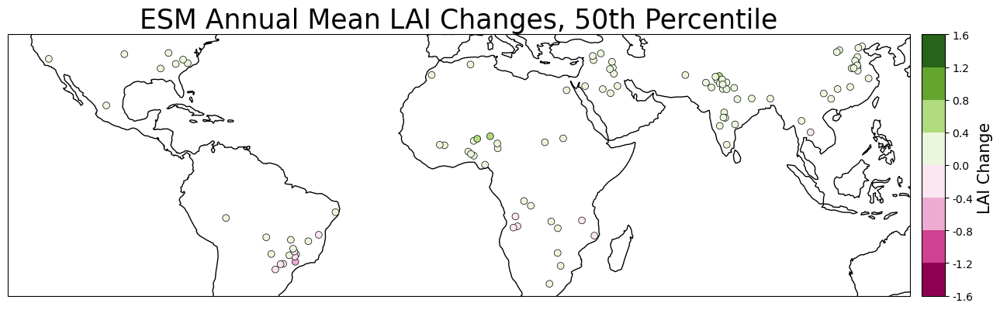

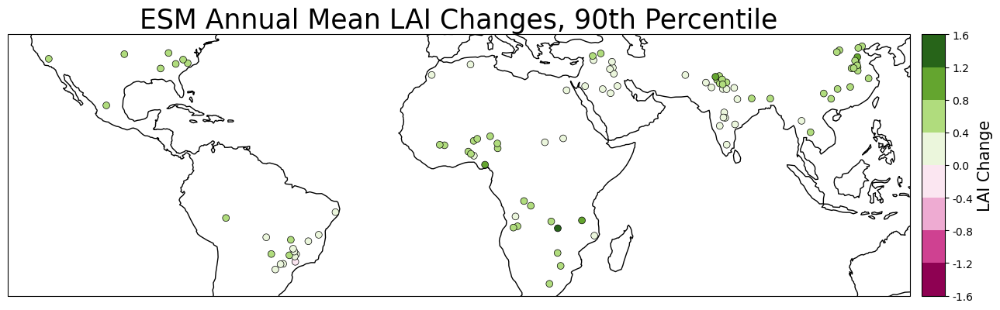

In [30]:
############################################################################
######## MODEL SPREAD: 10th, 50th, 90th Percentiles ########################
############################################################################

# get the median, 10th and 90th percentile changes
spread_df = pd.DataFrame ()
for i in range(len(CITY_COUNTRY_list)):
    CITY_COUNTRY = CITY_COUNTRY_list[i]
    var_changes = (model_annual_change_df[model_annual_change_df['CITY_COUNTRY'] == CITY_COUNTRY].
                Annual_Mean_LAI_change)
    lat = (model_annual_change_df[model_annual_change_df['CITY_COUNTRY'] == CITY_COUNTRY].Lat.values[0])
    lon = (model_annual_change_df[model_annual_change_df['CITY_COUNTRY'] == CITY_COUNTRY].Lon.values[0])

    df = pd.DataFrame({'CITY_COUNTRY': [CITY_COUNTRY], 'Lat':[lat], 'Lon':[lon], 
              'median_var_change':[np.percentile(var_changes, 50)],
              'ten_percentile_var_change':[np.percentile(var_changes, 10)],
              'ninety_percentile_var_change':[np.percentile(var_changes, 90)]}, index = [i])

    spread_df = pd.concat([spread_df, df])

# create the colormap
scale_min = -1.6
scale_max = 1.6
cmap = plt.cm.PiYG  # define the colormap
# extract all colors from the .bwr map
cmaplist = [cmap(i) for i in range(cmap.N)]

# create the new map
cmap = mpl.colors.LinearSegmentedColormap.from_list(
    'Custom cmap', cmaplist, cmap.N)

bounds = np.linspace(scale_min, scale_max, 9)
norm = mpl.colors.BoundaryNorm(bounds, cmap.N)


city_lats = spread_df.Lat.values
city_lons = spread_df.Lon.values
median_var_change = spread_df.median_var_change.values
ten_percentile_var_change = spread_df.ten_percentile_var_change.values
ninety_percentile_var_change = spread_df.ninety_percentile_var_change.values

####################################
fig = plt.figure(figsize=(15,10))
ax = plt.axes(projection=ccrs.PlateCarree(), title='ESM Annual Mean {} Changes, 10th Percentile'.format(climate_var))
ax.coastlines()

im = ax.scatter(city_lons, city_lats, zorder=5, c=ten_percentile_var_change, linewidths = 0.5, s =40,edgecolor = 'black',
               cmap= cmap, norm=norm)

#get size and extent of axes:
axpos = ax.get_position()
pos_x = axpos.x0 + axpos.width + 0.01 #+ 0.25*axpos.width
pos_y = axpos.y0  
cax_width = 0.02
cax_height = axpos.height
#create new axes where the colorbar should go.
#it should be next to the original axes and have the same height
pos_cax = fig.add_axes([pos_x,pos_y,cax_width,cax_height])

plt.colorbar(im, cax=pos_cax, label = '{} Change'.format(climate_var), cmap= cmap, norm=norm
            ,spacing='proportional', ticks=bounds, boundaries=bounds, format='%0.1f')

#save figure as png
os.chdir(os.path.join(et.io.HOME, 'Documents', 'Python_Scripts', 'PROJECT','Chapter_6','climate_projection_plots'))   
plt.savefig('esm_{}_change_10_percentile.png'.format(climate_var), bbox_inches = 'tight')
####################################

fig = plt.figure(figsize=(15,10))
ax = plt.axes(projection=ccrs.PlateCarree(), title='ESM Annual Mean {} Changes, 50th Percentile'.format(climate_var))
ax.coastlines()

im = ax.scatter(city_lons, city_lats, zorder=5, c=median_var_change, linewidths = 0.5, s =40,edgecolor = 'black',
               cmap= cmap, norm=norm)

#get size and extent of axes:
axpos = ax.get_position()
pos_x = axpos.x0 + axpos.width + 0.01 #+ 0.25*axpos.width
pos_y = axpos.y0  
cax_width = 0.02
cax_height = axpos.height
#create new axes where the colorbar should go.
#it should be next to the original axes and have the same height
pos_cax = fig.add_axes([pos_x,pos_y,cax_width,cax_height])

plt.colorbar(im, cax=pos_cax, label = '{} Change '.format(climate_var), cmap= cmap, norm=norm
            ,spacing='proportional', ticks=bounds, boundaries=bounds, format='%0.1f')

#save figure as png
os.chdir(os.path.join(et.io.HOME, 'Documents', 'Python_Scripts', 'PROJECT','Chapter_6','climate_projection_plots'))   
plt.savefig('esm_{}_change_50_percentile.png'.format(climate_var), bbox_inches = 'tight')
####################################

fig = plt.figure(figsize=(15,10))
ax = plt.axes(projection=ccrs.PlateCarree(), title='ESM Annual Mean {} Changes, 90th Percentile'.format(climate_var))
ax.coastlines()

im = ax.scatter(city_lons, city_lats, zorder=5, c=ninety_percentile_var_change, linewidths = 0.5, s =40,edgecolor = 'black',
               cmap= cmap, norm=norm)

#get size and extent of axes:
axpos = ax.get_position()
pos_x = axpos.x0 + axpos.width + 0.01 #+ 0.25*axpos.width
pos_y = axpos.y0  
cax_width = 0.02
cax_height = axpos.height
#create new axes where the colorbar should go.
#it should be next to the original axes and have the same height
pos_cax = fig.add_axes([pos_x,pos_y,cax_width,cax_height])

plt.colorbar(im, cax=pos_cax, label = '{} Change'.format(climate_var), cmap= cmap, norm=norm
            ,spacing='proportional', ticks=bounds, boundaries=bounds, format='%0.1f')

#save figure as png
os.chdir(os.path.join(et.io.HOME, 'Documents', 'Python_Scripts', 'PROJECT','Chapter_6','climate_projection_plots'))   
plt.savefig('esm_{}_change_90_percentile.png'.format(climate_var), bbox_inches = 'tight')

In [31]:
spread_df.ten_percentile_var_change.min(), spread_df.ninety_percentile_var_change.max() 

(-1.5690395832061768, 1.569395685195923)

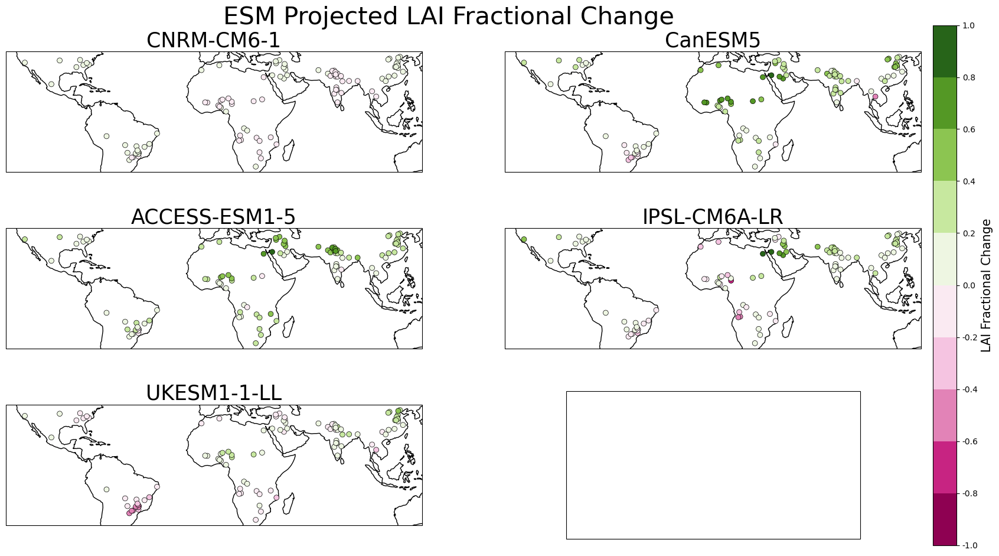

In [32]:
#####################################################################
######## CHANGES FOR EACH EARTH SYSTEM MODEL ########################
#####################################################################

climate_var = 'LAI_fract_change'
climate_var_units = ''

#plt.rc('font', size=15)          # controls default text sizes
plt.rc('axes', titlesize=25)     # fontsize of the axes title
plt.rc('axes', labelsize=15)    # fontsize of the x and y labels
#plt.rc('xtick', labelsize=15)    # fontsize of the tick labels
#plt.rc('ytick', labelsize=15)    # fontsize of the tick labels
#plt.rc('legend', fontsize=20)    # legend fontsize
plt.rc('figure', titlesize=20)  # fontsize of the figure title

# create the colormap
scale_min = -1
scale_max = 1
cmap = plt.cm.PiYG  # define the colormap
# extract all colors from the .bwr map
cmaplist = [cmap(i) for i in range(cmap.N)]

# create the new map
cmap = mpl.colors.LinearSegmentedColormap.from_list(
    'Custom cmap', cmaplist, cmap.N)

cmap.set_over(color = 'black')

bounds = np.linspace(scale_min, scale_max, 11)
norm = mpl.colors.BoundaryNorm(bounds, cmap.N)


#create the axes
fig, axes = plt.subplots(3,2 ,figsize=(20,11), subplot_kw={"projection": ccrs.PlateCarree()})

plt.suptitle('ESM Projected LAI Fractional Change', y = 0.93, fontsize = 30)

row_num = 0
col_num = 0
min_change = []
max_change = []
model_annual_change_df = pd.DataFrame()

for model in list(set(LAI_Proj_df2.Model)):
    
    model_df = LAI_Proj_df2[LAI_Proj_df2.Model == model].copy()
     
    df = model_df.groupby(['CITY_COUNTRY']).mean(numeric_only = True).reset_index()
    #CITY_COUNTRY_list = df.CITY_COUNTRY.values
    city_lats = df.Lat.values
    city_lons = df.Lon.values
    VAR_CHANGE = df['LAI_fract_change'].values
    
    axes[row_num,col_num].coastlines()
    im = axes[row_num,col_num].scatter(city_lons, city_lats, zorder=5, c=VAR_CHANGE, linewidths = 0.5,
                                        s =40,edgecolor = 'black',cmap= cmap, norm = norm)
    
    
    axes[row_num,col_num].set(title = model)  
    
    model_annual_df = pd.DataFrame({'CITY_COUNTRY': CITY_COUNTRY_list, 'Lat':city_lats, 'Lon':city_lons,
                                   'Annual_Mean_LAI_fract_change': VAR_CHANGE})
    model_annual_df['Model'] = model
    model_annual_change_df = pd.concat([model_annual_change_df, model_annual_df])
    # move the col and row nums on for the next plot
    if col_num == 1:
        col_num = 0
        row_num = row_num + 1
    
    elif col_num == 0:
        col_num = 1

#get size and extent of axes:
axpos = axes[1,1].get_position()
pos_x = axpos.x0 + axpos.width +0.01  #+ 0.25*axpos.width
pos_y = 0.1
cax_width = 0.02
cax_height = 0.8 #2*axpos.height
#create new axes where the colorbar should go.
#it should be next to the original axes and have the same height
pos_cax = fig.add_axes([pos_x,pos_y,cax_width,cax_height])

fig.colorbar(im, cax = pos_cax,  label = 'LAI Fractional Change', cmap= cmap, norm=norm
            ,spacing='proportional', ticks=bounds, boundaries=bounds, format='%.1f')   

In [33]:
model_annual_change_df.Annual_Mean_LAI_fract_change.min(), model_annual_change_df.Annual_Mean_LAI_fract_change.max()

(-0.7440573792749395, 0.9992349445819855)

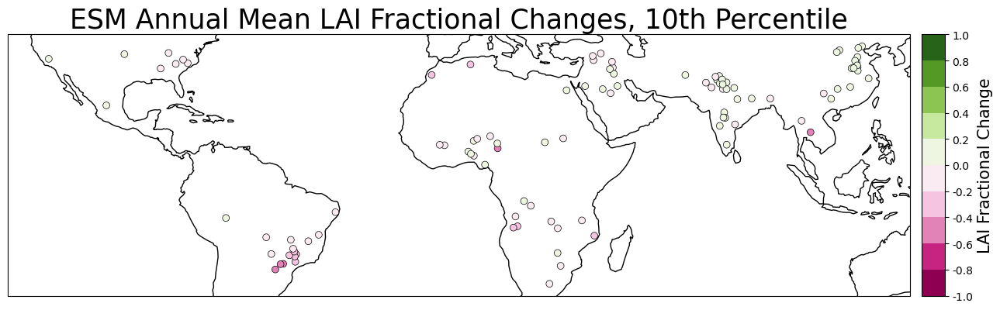

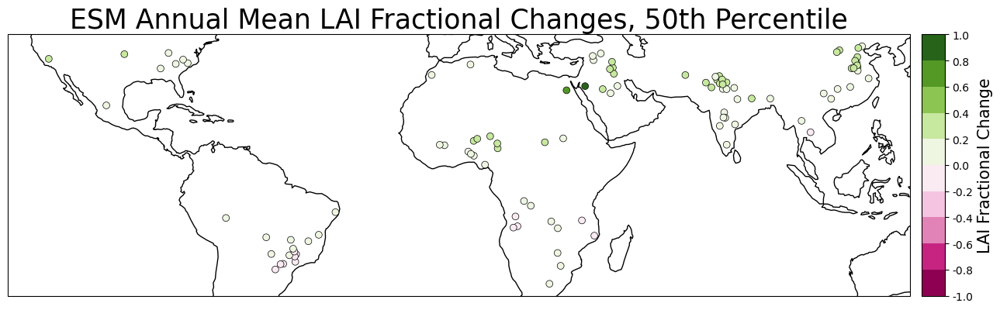

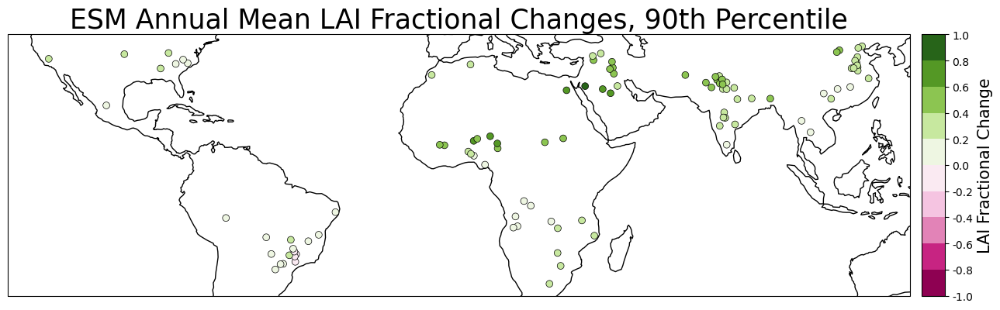

In [34]:
############################################################################
######## MODEL SPREAD: 10th, 50th, 90th Percentiles ########################
############################################################################

# get the median, 10th and 90th percentile changes
spread_df = pd.DataFrame ()
for i in range(len(CITY_COUNTRY_list)):
    CITY_COUNTRY = CITY_COUNTRY_list[i]
    var_changes = (model_annual_change_df[model_annual_change_df['CITY_COUNTRY'] == CITY_COUNTRY].
                Annual_Mean_LAI_fract_change)
    lat = (model_annual_change_df[model_annual_change_df['CITY_COUNTRY'] == CITY_COUNTRY].Lat.values[0])
    lon = (model_annual_change_df[model_annual_change_df['CITY_COUNTRY'] == CITY_COUNTRY].Lon.values[0])

    df = pd.DataFrame({'CITY_COUNTRY': [CITY_COUNTRY], 'Lat':[lat], 'Lon':[lon], 
              'median_var_change':[np.percentile(var_changes, 50)],
              'ten_percentile_var_change':[np.percentile(var_changes, 10)],
              'ninety_percentile_var_change':[np.percentile(var_changes, 90)]}, index = [i])

    spread_df = pd.concat([spread_df, df])

# create the colormap
scale_min = -1
scale_max = 1
cmap = plt.cm.PiYG  # define the colormap
# extract all colors from the .bwr map
cmaplist = [cmap(i) for i in range(cmap.N)]

# create the new map
cmap = mpl.colors.LinearSegmentedColormap.from_list(
    'Custom cmap', cmaplist, cmap.N)

bounds = np.linspace(scale_min, scale_max, 11)
norm = mpl.colors.BoundaryNorm(bounds, cmap.N)

city_lats = spread_df.Lat.values
city_lons = spread_df.Lon.values
median_var_change = spread_df.median_var_change.values
ten_percentile_var_change = spread_df.ten_percentile_var_change.values
ninety_percentile_var_change = spread_df.ninety_percentile_var_change.values

####################################
fig = plt.figure(figsize=(15,10))
ax = plt.axes(projection=ccrs.PlateCarree(), title='ESM Annual Mean LAI Fractional Changes, 10th Percentile')
ax.coastlines()

im = ax.scatter(city_lons, city_lats, zorder=5, c=ten_percentile_var_change, linewidths = 0.5, s =40,edgecolor = 'black',
               cmap= cmap, norm=norm)

#get size and extent of axes:
axpos = ax.get_position()
pos_x = axpos.x0 + axpos.width + 0.01 #+ 0.25*axpos.width
pos_y = axpos.y0  
cax_width = 0.02
cax_height = axpos.height
#create new axes where the colorbar should go.
#it should be next to the original axes and have the same height
pos_cax = fig.add_axes([pos_x,pos_y,cax_width,cax_height])

plt.colorbar(im, cax=pos_cax, label = 'LAI Fractional Change', cmap= cmap, norm=norm
            ,spacing='proportional', ticks=bounds, boundaries=bounds, format='%0.1f')

#save figure as png
os.chdir(os.path.join(et.io.HOME, 'Documents', 'Python_Scripts', 'PROJECT','Chapter_6','climate_projection_plots'))   
plt.savefig('esm_{}_change_10_percentile.png'.format(climate_var), bbox_inches = 'tight')
####################################

fig = plt.figure(figsize=(15,10))
ax = plt.axes(projection=ccrs.PlateCarree(), title='ESM Annual Mean LAI Fractional Changes, 50th Percentile')
ax.coastlines()

im = ax.scatter(city_lons, city_lats, zorder=5, c=median_var_change, linewidths = 0.5, s =40,edgecolor = 'black',
               cmap= cmap, norm=norm)

#get size and extent of axes:
axpos = ax.get_position()
pos_x = axpos.x0 + axpos.width + 0.01 #+ 0.25*axpos.width
pos_y = axpos.y0  
cax_width = 0.02
cax_height = axpos.height
#create new axes where the colorbar should go.
#it should be next to the original axes and have the same height
pos_cax = fig.add_axes([pos_x,pos_y,cax_width,cax_height])

plt.colorbar(im, cax=pos_cax, label = 'LAI Fractional Change', cmap= cmap, norm=norm
            ,spacing='proportional', ticks=bounds, boundaries=bounds, format='%0.1f')

#save figure as png
os.chdir(os.path.join(et.io.HOME, 'Documents', 'Python_Scripts', 'PROJECT','Chapter_6','climate_projection_plots'))   
plt.savefig('esm_{}_change_50_percentile.png'.format(climate_var), bbox_inches = 'tight')
####################################

fig = plt.figure(figsize=(15,10))
ax = plt.axes(projection=ccrs.PlateCarree(), title='ESM Annual Mean LAI Fractional Changes, 90th Percentile')
ax.coastlines()

im = ax.scatter(city_lons, city_lats, zorder=5, c=ninety_percentile_var_change, linewidths = 0.5, s =40,edgecolor = 'black',
               cmap= cmap, norm=norm)

#get size and extent of axes:
axpos = ax.get_position()
pos_x = axpos.x0 + axpos.width + 0.01 #+ 0.25*axpos.width
pos_y = axpos.y0  
cax_width = 0.02
cax_height = axpos.height
#create new axes where the colorbar should go.
#it should be next to the original axes and have the same height
pos_cax = fig.add_axes([pos_x,pos_y,cax_width,cax_height])

plt.colorbar(im, cax=pos_cax, label = 'LAI Fractional Change', cmap= cmap, norm=norm
            ,spacing='proportional', ticks=bounds, boundaries=bounds, format='%0.1f')

#save figure as png
os.chdir(os.path.join(et.io.HOME, 'Documents', 'Python_Scripts', 'PROJECT','Chapter_6','climate_projection_plots'))   
plt.savefig('esm_{}_change_90_percentile.png'.format(climate_var), bbox_inches = 'tight')

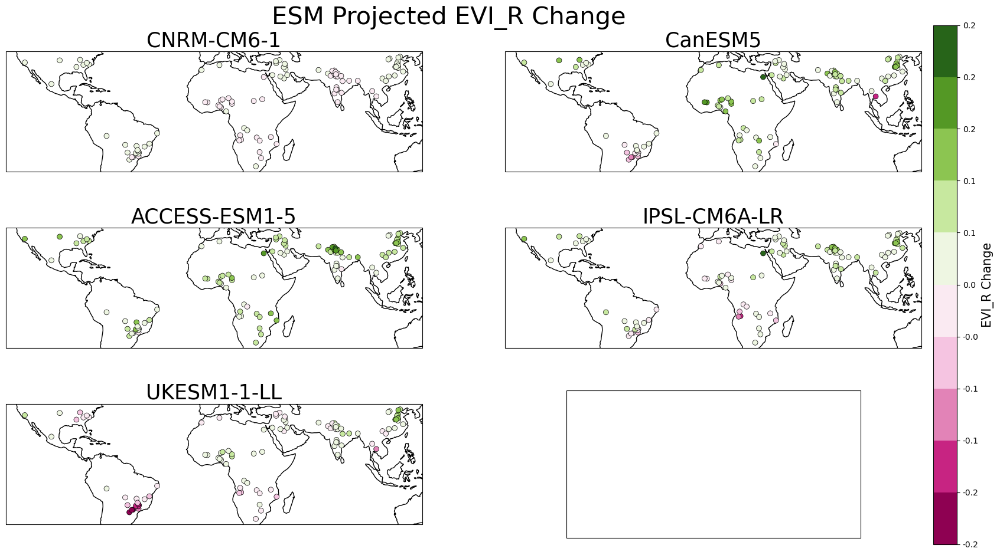

In [35]:
# Get the changes in EVI by multiplying the monthly EVIs by the fractional changes in LAIs

EVI_seasonal_cycle['Month'] = EVI_seasonal_cycle['month']
LAI_Proj_df3 = pd.merge(LAI_Proj_df2, EVI_seasonal_cycle, on = ['CITY_COUNTRY','Month'], how = 'left')
LAI_Proj_df3['EVI_R_Change'] = LAI_Proj_df3['LAI_fract_change']*LAI_Proj_df3['MONTH_MEAN_EVI_R']
LAI_Proj_df3['EVI_U_Change'] = LAI_Proj_df3['LAI_fract_change']*LAI_Proj_df3['MONTH_MEAN_EVI_U']
LAI_Proj_df3['EVI_D_Change'] = LAI_Proj_df3['LAI_fract_change']*LAI_Proj_df3['MONTH_MEAN_EVI_D']


#####################################################################
######## CHANGES FOR EACH EARTH SYSTEM MODEL ########################
#####################################################################

climate_var = 'EVI_R'
climate_var_units = ''

#plt.rc('font', size=15)          # controls default text sizes
plt.rc('axes', titlesize=25)     # fontsize of the axes title
plt.rc('axes', labelsize=15)    # fontsize of the x and y labels
#plt.rc('xtick', labelsize=15)    # fontsize of the tick labels
#plt.rc('ytick', labelsize=15)    # fontsize of the tick labels
#plt.rc('legend', fontsize=20)    # legend fontsize
plt.rc('figure', titlesize=20)  # fontsize of the figure title

# create the colormap
scale_min = -0.25
scale_max = 0.25
cmap = plt.cm.PiYG  # define the colormap
# extract all colors from the .bwr map
cmaplist = [cmap(i) for i in range(cmap.N)]

# create the new map
cmap = mpl.colors.LinearSegmentedColormap.from_list(
    'Custom cmap', cmaplist, cmap.N)

cmap.set_over(color = 'black')

bounds = np.linspace(scale_min, scale_max, 11)
norm = mpl.colors.BoundaryNorm(bounds, cmap.N)


#create the axes
fig, axes = plt.subplots(3,2 ,figsize=(20,11), subplot_kw={"projection": ccrs.PlateCarree()})

plt.suptitle('ESM Projected EVI_R Change', y = 0.93, fontsize = 30)

row_num = 0
col_num = 0
min_change = []
max_change = []
model_annual_change_df = pd.DataFrame()

for model in list(set(LAI_Proj_df3.Model)):
    
    model_df = LAI_Proj_df3[LAI_Proj_df3.Model == model].copy()
     
    df = model_df.groupby(['CITY_COUNTRY']).mean(numeric_only = True).reset_index()
    #CITY_COUNTRY_list = df.CITY_COUNTRY.values
    city_lats = df.Lat.values
    city_lons = df.Lon.values
    VAR_CHANGE = df['EVI_R_Change'].values
    
    axes[row_num,col_num].coastlines()
    im = axes[row_num,col_num].scatter(city_lons, city_lats, zorder=5, c=VAR_CHANGE, linewidths = 0.5,
                                        s =40,edgecolor = 'black',cmap= cmap, norm = norm)
    
    
    axes[row_num,col_num].set(title = model)  
    
    model_annual_df = pd.DataFrame({'CITY_COUNTRY': CITY_COUNTRY_list, 'Lat':city_lats, 'Lon':city_lons,
                                   'Annual_Mean_EVI_R_Change': VAR_CHANGE})
    model_annual_df['Model'] = model
    model_annual_change_df = pd.concat([model_annual_change_df, model_annual_df])
    # move the col and row nums on for the next plot
    if col_num == 1:
        col_num = 0
        row_num = row_num + 1
    
    elif col_num == 0:
        col_num = 1

#get size and extent of axes:
axpos = axes[1,1].get_position()
pos_x = axpos.x0 + axpos.width +0.01  #+ 0.25*axpos.width
pos_y = 0.1
cax_width = 0.02
cax_height = 0.8 #2*axpos.height
#create new axes where the colorbar should go.
#it should be next to the original axes and have the same height
pos_cax = fig.add_axes([pos_x,pos_y,cax_width,cax_height])

fig.colorbar(im, cax = pos_cax,  label = 'EVI_R Change', cmap= cmap, norm=norm
            ,spacing='proportional', ticks=bounds, boundaries=bounds, format='%.1f')   

In [36]:
model_annual_change_df.Annual_Mean_EVI_R_Change.min(),model_annual_change_df.Annual_Mean_EVI_R_Change.max()

(-0.23730982628201647, 0.22446432873689884)

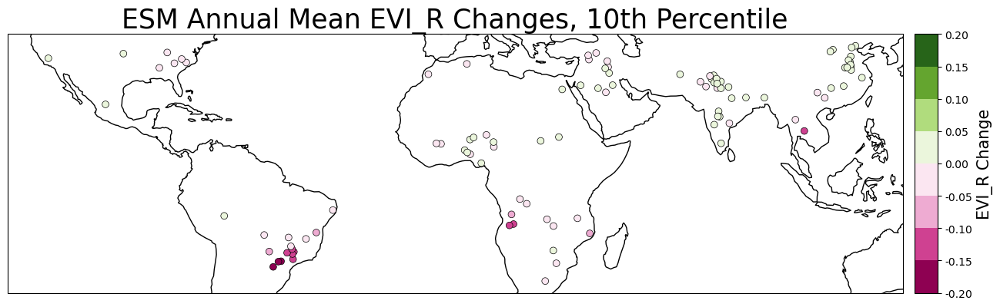

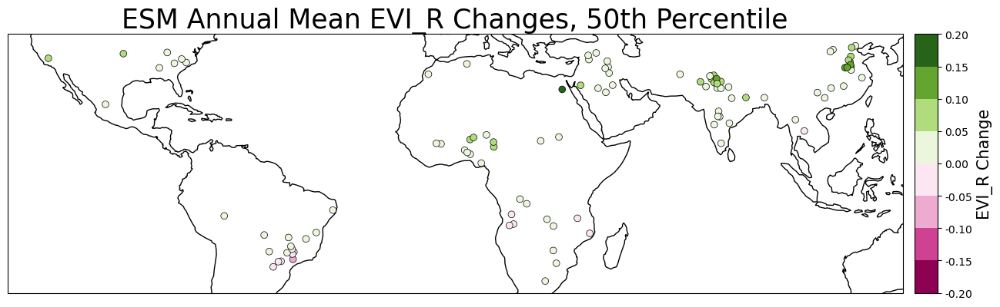

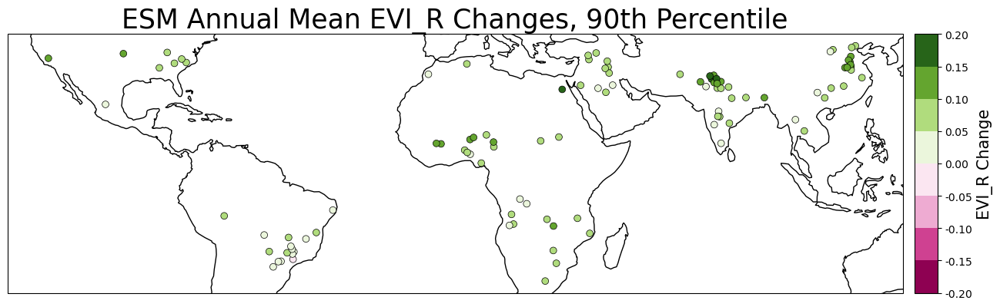

In [37]:
############################################################################
######## MODEL SPREAD: 10th, 50th, 90th Percentiles ########################
############################################################################

# get the median, 10th and 90th percentile changes
spread_df = pd.DataFrame ()
for i in range(len(CITY_COUNTRY_list)):
    CITY_COUNTRY = CITY_COUNTRY_list[i]
    var_changes = (model_annual_change_df[model_annual_change_df['CITY_COUNTRY'] == CITY_COUNTRY].
                Annual_Mean_EVI_R_Change)
    lat = (model_annual_change_df[model_annual_change_df['CITY_COUNTRY'] == CITY_COUNTRY].Lat.values[0])
    lon = (model_annual_change_df[model_annual_change_df['CITY_COUNTRY'] == CITY_COUNTRY].Lon.values[0])

    df = pd.DataFrame({'CITY_COUNTRY': [CITY_COUNTRY], 'Lat':[lat], 'Lon':[lon], 
              'median_var_change':[np.percentile(var_changes, 50)],
              'ten_percentile_var_change':[np.percentile(var_changes, 10)],
              'ninety_percentile_var_change':[np.percentile(var_changes, 90)]}, index = [i])

    spread_df = pd.concat([spread_df, df])

# create the colormap
scale_min = -0.2
scale_max = 0.2
cmap = plt.cm.PiYG  # define the colormap
# extract all colors from the .bwr map
cmaplist = [cmap(i) for i in range(cmap.N)]

# create the new map
cmap = mpl.colors.LinearSegmentedColormap.from_list(
    'Custom cmap', cmaplist, cmap.N)

bounds = np.linspace(scale_min, scale_max, 9)
norm = mpl.colors.BoundaryNorm(bounds, cmap.N)

city_lats = spread_df.Lat.values
city_lons = spread_df.Lon.values
median_var_change = spread_df.median_var_change.values
ten_percentile_var_change = spread_df.ten_percentile_var_change.values
ninety_percentile_var_change = spread_df.ninety_percentile_var_change.values

####################################
fig = plt.figure(figsize=(15,10))
ax = plt.axes(projection=ccrs.PlateCarree(), title='ESM Annual Mean EVI_R Changes, 10th Percentile')
ax.coastlines()

im = ax.scatter(city_lons, city_lats, zorder=5, c=ten_percentile_var_change, linewidths = 0.5, s =40,edgecolor = 'black',
               cmap= cmap, norm=norm)

#get size and extent of axes:
axpos = ax.get_position()
pos_x = axpos.x0 + axpos.width + 0.01 #+ 0.25*axpos.width
pos_y = axpos.y0  
cax_width = 0.02
cax_height = axpos.height
#create new axes where the colorbar should go.
#it should be next to the original axes and have the same height
pos_cax = fig.add_axes([pos_x,pos_y,cax_width,cax_height])

plt.colorbar(im, cax=pos_cax, label = 'EVI_R Change', cmap= cmap, norm=norm
            ,spacing='proportional', ticks=bounds, boundaries=bounds, format='%0.2f')

#save figure as png
os.chdir(os.path.join(et.io.HOME, 'Documents', 'Python_Scripts', 'PROJECT','Chapter_6','climate_projection_plots'))   
plt.savefig('esm_{}_change_10_percentile.png'.format(climate_var), bbox_inches = 'tight')
####################################

fig = plt.figure(figsize=(15,10))
ax = plt.axes(projection=ccrs.PlateCarree(), title='ESM Annual Mean EVI_R Changes, 50th Percentile')
ax.coastlines()

im = ax.scatter(city_lons, city_lats, zorder=5, c=median_var_change, linewidths = 0.5, s =40,edgecolor = 'black',
               cmap= cmap, norm=norm)

#get size and extent of axes:
axpos = ax.get_position()
pos_x = axpos.x0 + axpos.width + 0.01 #+ 0.25*axpos.width
pos_y = axpos.y0  
cax_width = 0.02
cax_height = axpos.height
#create new axes where the colorbar should go.
#it should be next to the original axes and have the same height
pos_cax = fig.add_axes([pos_x,pos_y,cax_width,cax_height])

plt.colorbar(im, cax=pos_cax, label = 'EVI_R Change', cmap= cmap, norm=norm
            ,spacing='proportional', ticks=bounds, boundaries=bounds, format='%0.2f')

#save figure as png
os.chdir(os.path.join(et.io.HOME, 'Documents', 'Python_Scripts', 'PROJECT','Chapter_6','climate_projection_plots'))   
plt.savefig('esm_{}_change_50_percentile.png'.format(climate_var), bbox_inches = 'tight')
####################################

fig = plt.figure(figsize=(15,10))
ax = plt.axes(projection=ccrs.PlateCarree(), title='ESM Annual Mean EVI_R Changes, 90th Percentile')
ax.coastlines()

im = ax.scatter(city_lons, city_lats, zorder=5, c=ninety_percentile_var_change, linewidths = 0.5, s =40,edgecolor = 'black',
               cmap= cmap, norm=norm)

#get size and extent of axes:
axpos = ax.get_position()
pos_x = axpos.x0 + axpos.width + 0.01 #+ 0.25*axpos.width
pos_y = axpos.y0  
cax_width = 0.02
cax_height = axpos.height
#create new axes where the colorbar should go.
#it should be next to the original axes and have the same height
pos_cax = fig.add_axes([pos_x,pos_y,cax_width,cax_height])

plt.colorbar(im, cax=pos_cax, label = 'EVI_R Change', cmap= cmap, norm=norm
            ,spacing='proportional', ticks=bounds, boundaries=bounds, format='%0.2f')

#save figure as png
os.chdir(os.path.join(et.io.HOME, 'Documents', 'Python_Scripts', 'PROJECT','Chapter_6','climate_projection_plots'))   
plt.savefig('esm_{}_change_90_percentile.png'.format(climate_var), bbox_inches = 'tight')

In [38]:
var_changes

103   -4.270843e-08
103    9.836403e-02
103    8.423780e-02
103   -2.281639e-02
103    4.072898e-02
Name: Annual_Mean_EVI_R_Change, dtype: float64

In [39]:
spread_df.ten_percentile_var_change.min(), spread_df.ninety_percentile_var_change.max() 

(-0.18409209771263835, 0.20907790962667872)

In [40]:
# create a df with the annual range for each model
annual_range_df = pd.DataFrame()

for model in list(set(LAI_Proj_df3.Model)):
    
    model_df = LAI_Proj_df3[LAI_Proj_df3.Model == model].copy()
    
    for i in range(len(CITY_COUNTRY_list)):
        CITY_COUNTRY = CITY_COUNTRY_list[i]
        lat = LAI_Proj_df3[LAI_Proj_df3.CITY_COUNTRY == CITY_COUNTRY].Lat.values[0]
        lon = LAI_Proj_df3[LAI_Proj_df3.CITY_COUNTRY == CITY_COUNTRY].Lon.values[0]
        annual_range = (model_df[model_df.CITY_COUNTRY == CITY_COUNTRY].EVI_R_Change.max() 
                 - model_df[model_df.CITY_COUNTRY == CITY_COUNTRY].EVI_R_Change.min())

        
        df = pd.DataFrame({'CITY_COUNTRY': [CITY_COUNTRY], 'Lat':[lat], 'Lon':[lon], 
              'EVI_R_Annual_Range':[annual_range]},index = [i])
        
        df['Model'] = model
        
        annual_range_df = pd.concat([annual_range_df, df])
        
        
# get the median, 10th and 90th percentile for monthly ranges
percentiles_annual_range_df = pd.DataFrame()

for i in range(len(CITY_COUNTRY_list)):
    CITY_COUNTRY = CITY_COUNTRY_list[i]
    var_changes = (annual_range_df[annual_range_df['CITY_COUNTRY'] == CITY_COUNTRY].
                EVI_R_Annual_Range)
    lat = (annual_range_df[annual_range_df['CITY_COUNTRY'] == CITY_COUNTRY].Lat.values[0])
    lon = (annual_range_df[annual_range_df['CITY_COUNTRY'] == CITY_COUNTRY].Lon.values[0])

    df = pd.DataFrame({'CITY_COUNTRY': [CITY_COUNTRY], 'Lat':[lat], 'Lon':[lon], 
              'median_EVI_R_annual_change_range':[np.percentile(var_changes, 50)],
              'ten_percentile_EVI_R_annual_change_range':[np.percentile(var_changes, 10)],
              'ninety_percentile_EVI_R_annual_change_range':[np.percentile(var_changes, 90)],
                      }, index = [i])

    percentiles_annual_range_df = pd.concat([percentiles_annual_range_df, df])


In [40]:
percentiles_annual_range_df

,CITY_COUNTRY,Lat,Lon,median_EVI_R_annual_change_range,ten_percentile_EVI_R_annual_change_range,ninety_percentile_EVI_R_annual_change_range
0,AKOLA_INDIA,20.733330,77.000000,0.030412,0.009072,0.112589
1,ALWAR_INDIA,27.562460,76.625000,0.049879,0.014825,0.127241
2,AL_OBEID_SUDAN,13.184167,30.216667,0.023012,0.001793,0.090615
3,AL_RAQQA_SYRIA,35.950000,39.016670,0.078354,0.008025,0.402729
4,ANAPOLIS_BRAZIL,-16.326670,-48.952780,0.100484,0.010202,0.238851
...,...,...,...,...,...,...
99,YULIN_SHAANXI_CHINA,38.283840,109.731486,0.039121,0.014198,0.059079
100,ZACATECAS_MEXICO,22.775590,-102.572180,0.014149,0.003725,0.035425
101,ZHOUKOU_CHINA,33.617368,114.646126,0.171834,0.049873,0.327112
102,ZHUOZHOU_CHINA,39.484559,115.978268,0.125087,0.048316,0.157530


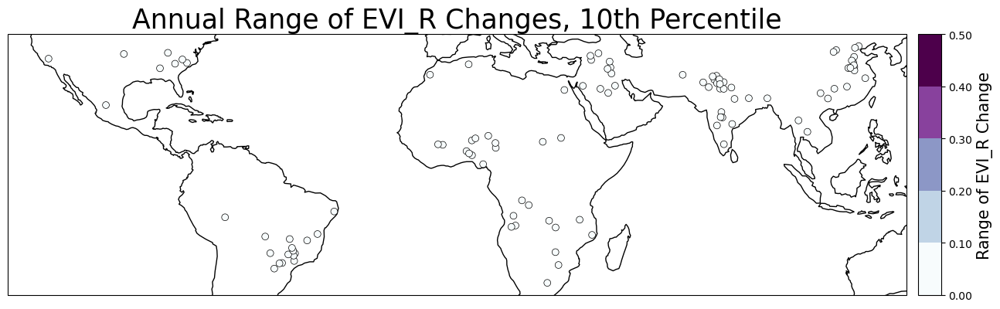

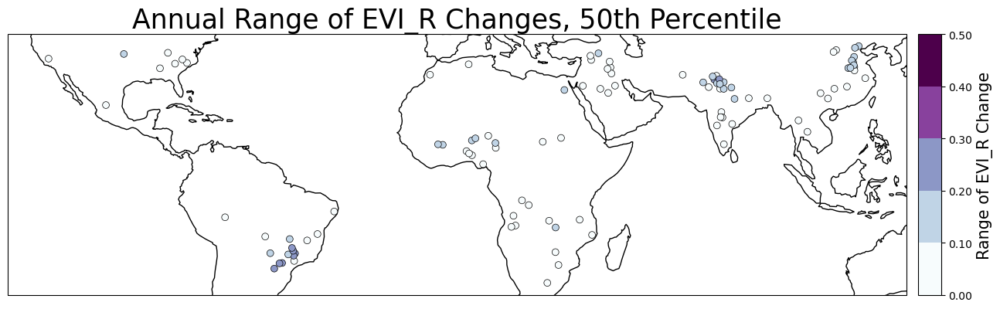

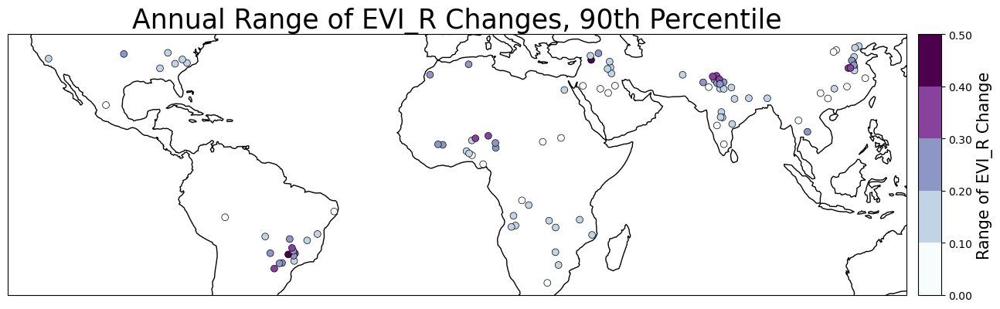

In [41]:
# create the colormap
scale_min = 0
scale_max = 0.5
cmap = plt.cm.BuPu  # define the colormap
# extract all colors from the .bwr map
cmaplist = [cmap(i) for i in range(cmap.N)]

# create the new map
cmap = mpl.colors.LinearSegmentedColormap.from_list(
    'Custom cmap', cmaplist, cmap.N)

cmap.set_over(color = 'black')

bounds = np.linspace(scale_min, scale_max, 6)
norm = mpl.colors.BoundaryNorm(bounds, cmap.N)

city_lats = percentiles_annual_range_df.Lat.values
city_lons = percentiles_annual_range_df.Lon.values
median_var_change = percentiles_annual_range_df.median_EVI_R_annual_change_range.values
ten_percentile_var_change = percentiles_annual_range_df.ten_percentile_EVI_R_annual_change_range.values
ninety_percentile_var_change = percentiles_annual_range_df.ninety_percentile_EVI_R_annual_change_range.values


####################################
fig = plt.figure(figsize=(15,10))
ax = plt.axes(projection=ccrs.PlateCarree(), title='Annual Range of EVI_R Changes, 10th Percentile')
ax.coastlines()

im = ax.scatter(city_lons, city_lats, zorder=5, c=ten_percentile_var_change, linewidths = 0.5, s =40,edgecolor = 'black',
               cmap= cmap, norm=norm)

#get size and extent of axes:
axpos = ax.get_position()
pos_x = axpos.x0 + axpos.width + 0.01 #+ 0.25*axpos.width
pos_y = axpos.y0  
cax_width = 0.02
cax_height = axpos.height
#create new axes where the colorbar should go.
#it should be next to the original axes and have the same height
pos_cax = fig.add_axes([pos_x,pos_y,cax_width,cax_height])

plt.colorbar(im, cax=pos_cax, label = 'Range of EVI_R Change', cmap= cmap, norm=norm
            ,spacing='proportional', ticks=bounds, boundaries=bounds, format='%0.2f')

#save figure as png
os.chdir(os.path.join(et.io.HOME, 'Documents', 'Python_Scripts', 'PROJECT','Chapter_6','climate_projection_plots'))   
plt.savefig('annual_range_EVI_R_change_10_percentile.png', bbox_inches = 'tight')


####################################
fig = plt.figure(figsize=(15,10))
ax = plt.axes(projection=ccrs.PlateCarree(), title='Annual Range of EVI_R Changes, 50th Percentile')
ax.coastlines()

im = ax.scatter(city_lons, city_lats, zorder=5, c=median_var_change, linewidths = 0.5, s =40,edgecolor = 'black',
               cmap= cmap, norm=norm)

#get size and extent of axes:
axpos = ax.get_position()
pos_x = axpos.x0 + axpos.width + 0.01 #+ 0.25*axpos.width
pos_y = axpos.y0  
cax_width = 0.02
cax_height = axpos.height
#create new axes where the colorbar should go.
#it should be next to the original axes and have the same height
pos_cax = fig.add_axes([pos_x,pos_y,cax_width,cax_height])

plt.colorbar(im, cax=pos_cax, label = 'Range of EVI_R Change', cmap= cmap, norm=norm
            ,spacing='proportional', ticks=bounds, boundaries=bounds, format='%0.2f')

#save figure as png
os.chdir(os.path.join(et.io.HOME, 'Documents', 'Python_Scripts', 'PROJECT','Chapter_6','climate_projection_plots'))   
plt.savefig('annual_range_EVI_R_change_50_percentile.png', bbox_inches = 'tight')


####################################
fig = plt.figure(figsize=(15,10))
ax = plt.axes(projection=ccrs.PlateCarree(), title='Annual Range of EVI_R Changes, 90th Percentile')
ax.coastlines()

im = ax.scatter(city_lons, city_lats, zorder=5, c=ninety_percentile_var_change, linewidths = 0.5, s =40,edgecolor = 'black',
               cmap= cmap, norm=norm)

#get size and extent of axes:
axpos = ax.get_position()
pos_x = axpos.x0 + axpos.width + 0.01 #+ 0.25*axpos.width
pos_y = axpos.y0  
cax_width = 0.02
cax_height = axpos.height
#create new axes where the colorbar should go.
#it should be next to the original axes and have the same height
pos_cax = fig.add_axes([pos_x,pos_y,cax_width,cax_height])

plt.colorbar(im, cax=pos_cax, label = 'Range of EVI_R Change', cmap= cmap, norm=norm
            ,spacing='proportional', ticks=bounds, boundaries=bounds, format='%0.2f')

#save figure as png
os.chdir(os.path.join(et.io.HOME, 'Documents', 'Python_Scripts', 'PROJECT','Chapter_6','climate_projection_plots'))   
plt.savefig('annual_range_EVI_R_change_90_percentile.png', bbox_inches = 'tight')



In [42]:
ten_percentile_var_change.min(), ten_percentile_var_change.max()

(0.0017754544326468104, 0.08181751320493952)

In [43]:
median_var_change.min(),median_var_change.max()

(0.011223525886087951, 0.2908371511541602)

In [44]:
ninety_percentile_var_change.min(), ninety_percentile_var_change.max()

(0.018702199571896193, 0.45969707165922363)

In [45]:
##########################################################################
######## SUHI_MEAN CHANGES FOR EACH CLIMATE MODEL ########################
##########################################################################

# Use the RERF that has been refit on the entire dataset

model_name = 'RERF'
# read in the model 
os.chdir(os.path.join(et.io.HOME, 'Documents', 'Python_Scripts', 'PROJECT', 'CITY_ADD_2022_09','All_cities_modelling'))
#filename = 'RERF_{}_{}.sav'.format(target_variable, test_train_split)
filename = 'REFIT_RERF_SUHI_MEAN.sav'
RERF_SUHI_MEAN = pickle.load(open(filename, 'rb'))

# generate a prediction for all the data
all_monthly_data_df2['RERF_SUHI_MEAN'] = RERF_SUHI_MEAN.predict(X_all_data_norm)

C:\Users\UEA_Laptop\.conda\envs\suhienv_sensitivity\lib\site-packages\sklearn\base.py:299: UserWarning: Trying to unpickle estimator Ridge from version 1.0.2 when using version 1.2.1. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(
C:\Users\UEA_Laptop\.conda\envs\suhienv_sensitivity\lib\site-packages\sklearn\base.py:299: UserWarning: Trying to unpickle estimator DecisionTreeRegressor from version 1.0.2 when using version 1.2.1. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/model_persistence.html#security-maintainability-limitations
  warnings.warn(
C:\Users\UEA_Laptop\.conda\envs\suhienv_sensitivity\lib\site-packages\sklearn\base.py:299: UserWarning: Trying to unpickle estimator RandomForestRegressor from version 1.0.2 when using v

In [46]:
#RERF_SUHI_MEAN.best_params_

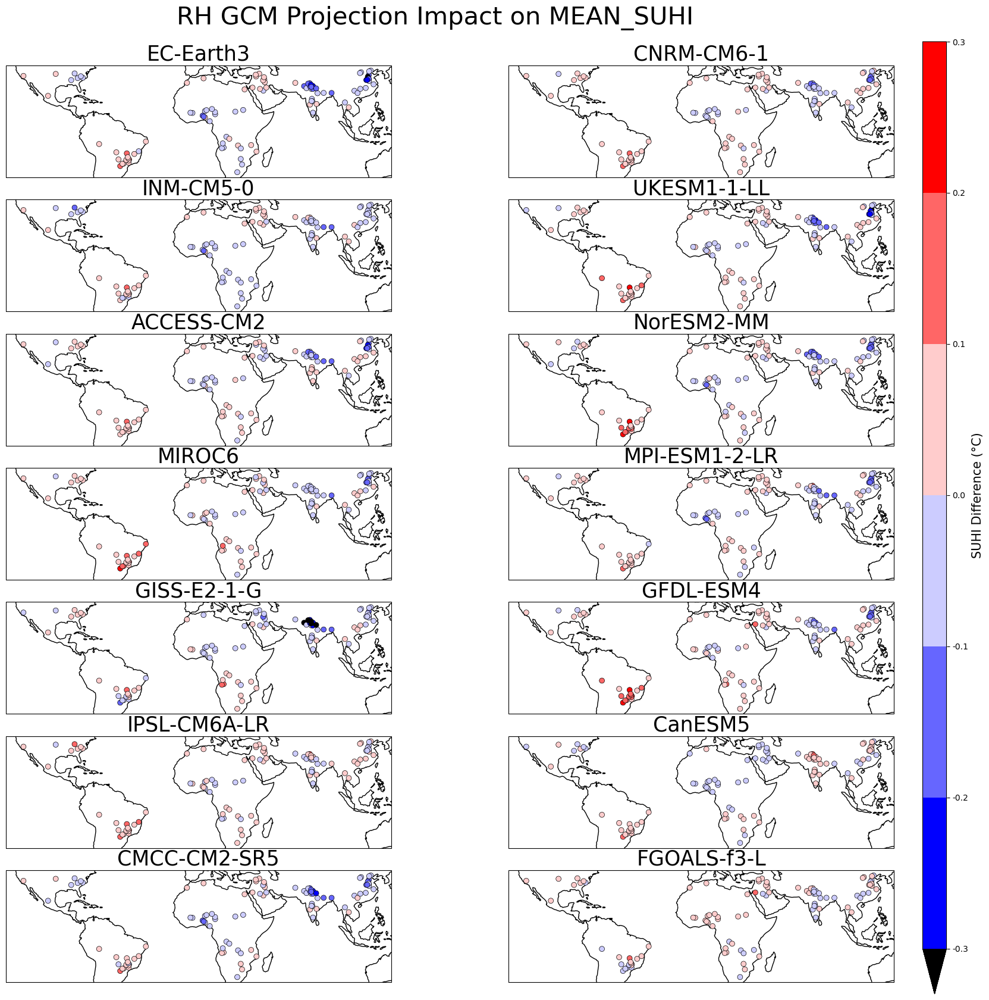

In [47]:
#################################################
############ IMPACT OF RH CHANGES ###############
#################################################

# make sure the normalisation is based on the training data 
X_train_norm = pd.DataFrame(scaler.fit_transform(X_train), columns = X_train.columns) #fit and transform

# add in lower case month for the merge key
Climate_Proj_df['month'] = Climate_Proj_df['Month']
LAI_Proj_df['month'] = LAI_Proj_df['Month']

climate_var = 'RH'
var_max_threshold = 100
var_min_threshold = 0

# create the colormap
SUHI_MEAN_min = -0.3
SUHI_MEAN_max = 0.3
cmap = plt.cm.bwr  # define the colormap
# extract all colors from the .bwr map
cmaplist = [cmap(i) for i in range(cmap.N)]

# create the new map
cmap = mpl.colors.LinearSegmentedColormap.from_list(
    'Custom cmap', cmaplist, cmap.N)

cmap.set_under(color = 'black')

bounds = np.linspace(SUHI_MEAN_min, SUHI_MEAN_max, 7)
norm = mpl.colors.BoundaryNorm(bounds, cmap.N)


#create the axes
fig, axes = plt.subplots(7,2 ,figsize=(20,20), subplot_kw={"projection": ccrs.PlateCarree()})

plt.suptitle('{} GCM Projection Impact on MEAN_SUHI'.format(climate_var), y = 0.93, fontsize = 30)

row_num = 0
col_num = 0
min_change = []
max_change = []
max_var_value = []
min_var_value = []
model_annual_mean_pred_df = pd.DataFrame()

for model in list(set(Climate_Proj_df.Model)):
    
    model_df = Climate_Proj_df[Climate_Proj_df.Model == model].copy()
    # data for the 2 degC climate change projections 
    climate_change_df = all_monthly_data_df2.copy()

    # merge and add in new RH and TP
    climate_change_df = pd.merge(climate_change_df, model_df, how = 'left', on = ['CITY_COUNTRY', 'month'])
    # copy the df to get the changes for RH and TP separately
    var_climate_change_df = climate_change_df.copy()

    var_climate_change_df[climate_var] = (var_climate_change_df[climate_var] 
                                          + var_climate_change_df['{}_Change'.format(climate_var)])

        
    max_var_value.append(var_climate_change_df[climate_var].max())
    min_var_value.append(var_climate_change_df[climate_var].min())
    
    #replace the values which go over the threshold amounts
    var_climate_change_df.loc[var_climate_change_df[climate_var] > var_max_threshold, climate_var] = var_max_threshold
    var_climate_change_df.loc[var_climate_change_df[climate_var] < var_min_threshold, climate_var] = var_min_threshold       

    #RH alone
    X_cc_all_data = var_climate_change_df[predictor_variables]
    
    X_cc_all_data_norm = pd.DataFrame(scaler.transform(X_cc_all_data), 
                                         columns = X_cc_all_data.columns) #transform only
    
    var_climate_change_df['CC_PREDICTION'] = RERF_SUHI_MEAN.predict(X_cc_all_data_norm)
    
    var_climate_change_df['SUHI_CHANGE'] = (var_climate_change_df['CC_PREDICTION'] 
                                            - var_climate_change_df['RERF_SUHI_MEAN'])
     
    df = var_climate_change_df.groupby(['CITY_COUNTRY','Lat','Lon']).mean(numeric_only = True).reset_index()
    CITY_COUNTRY_list = df.CITY_COUNTRY.values
    city_lats = df.Lat.values
    city_lons = df.Lon.values
    SUHI_CHANGE = df.SUHI_CHANGE.values
    
    model_annual_df = pd.DataFrame({'CITY_COUNTRY': CITY_COUNTRY_list, 'Lat':city_lats, 'Lon':city_lons,
                                   'Annual_Mean_SUHI_MEAN_change': SUHI_CHANGE})
    model_annual_df['Model'] = model
    model_annual_mean_pred_df = pd.concat([model_annual_mean_pred_df, model_annual_df])
    
    axes[row_num,col_num].coastlines()
    im = axes[row_num,col_num].scatter(city_lons, city_lats, zorder=5, c=SUHI_CHANGE, linewidths = 0.5,
                                        s =40,edgecolor = 'black',cmap= cmap, norm = norm)
    
    
    axes[row_num,col_num].set(title = model)
    
    min_change.append(SUHI_CHANGE.min())
    max_change.append(SUHI_CHANGE.max())            
    
    # move the col and row nums on for the next plot
    if col_num == 1:
        col_num = 0
        row_num = row_num + 1
    
    elif col_num == 0:
        col_num = 1

#get size and extent of axes:
axpos = ax.get_position()
pos_x = axpos.x0 + axpos.width +0.01  #+ 0.25*axpos.width
pos_y = 0.1
cax_width = 0.02
cax_height = 0.8 #2*axpos.height
#create new axes where the colorbar should go.
#it should be next to the original axes and have the same height
pos_cax = fig.add_axes([pos_x,pos_y,cax_width,cax_height])

fig.colorbar(im, cax = pos_cax,  label = 'SUHI Difference (\u00b0C)', cmap= cmap, norm=norm
            ,spacing='proportional', ticks=bounds, boundaries=bounds, format='%.1f', extend = 'min')   

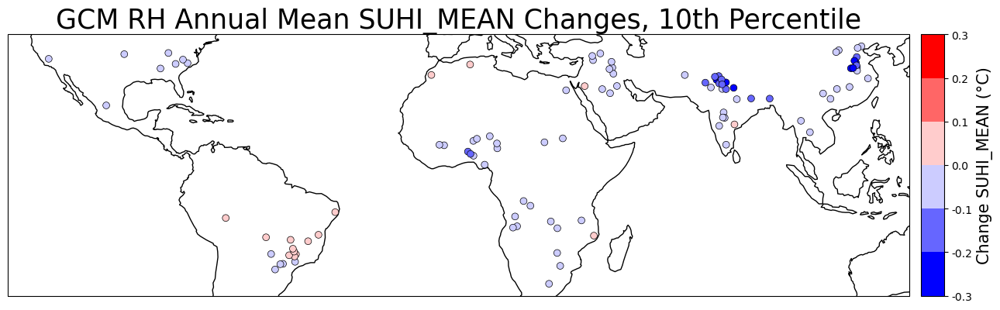

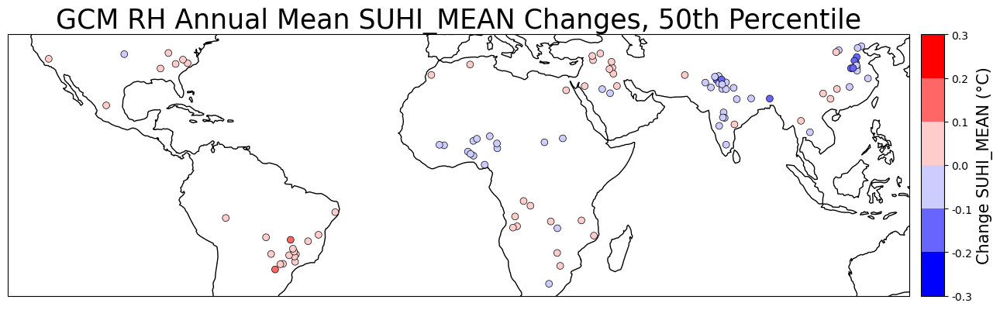

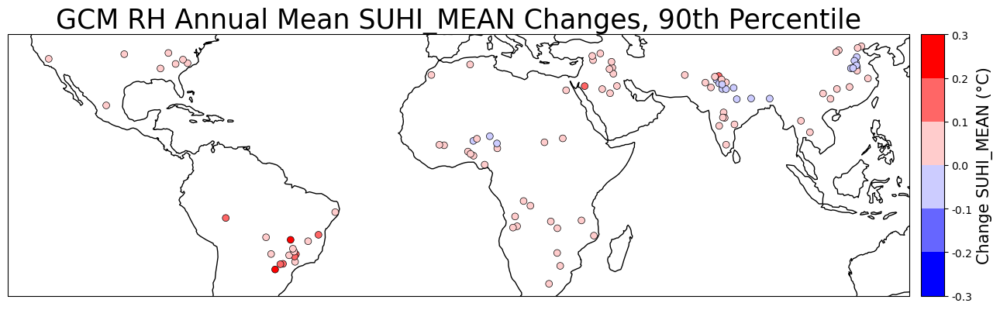

In [48]:
############################################################################
######## MODEL SPREAD: 10th, 50th, 90th Percentiles ########################
############################################################################

# get the median, 10th and 90th percentile changes
spread_df = pd.DataFrame ()
for i in range(len(CITY_COUNTRY_list)):
    CITY_COUNTRY = CITY_COUNTRY_list[i]
    var_changes = (model_annual_mean_pred_df[model_annual_mean_pred_df['CITY_COUNTRY'] == CITY_COUNTRY].
                Annual_Mean_SUHI_MEAN_change)
    lat = (model_annual_mean_pred_df[model_annual_mean_pred_df['CITY_COUNTRY'] == CITY_COUNTRY].Lat.values[0])
    lon = (model_annual_mean_pred_df[model_annual_mean_pred_df['CITY_COUNTRY'] == CITY_COUNTRY].Lon.values[0])

    df = pd.DataFrame({'CITY_COUNTRY': [CITY_COUNTRY], 'Lat':[lat], 'Lon':[lon], 
              'median_var_change':[np.percentile(var_changes, 50)],
              'ten_percentile_var_change':[np.percentile(var_changes, 10)],
              'ninety_percentile_var_change':[np.percentile(var_changes, 90)]}, index = [i])

    spread_df = pd.concat([spread_df, df])

# create the colormap
scale_min = -0.3
scale_max = 0.3
cmap = plt.cm.bwr  # define the colormap
# extract all colors from the .bwr map
cmaplist = [cmap(i) for i in range(cmap.N)]

# create the new map
cmap = mpl.colors.LinearSegmentedColormap.from_list(
    'Custom cmap', cmaplist, cmap.N)

bounds = np.linspace(scale_min, scale_max, 7)
norm = mpl.colors.BoundaryNorm(bounds, cmap.N)

city_lats = spread_df.Lat.values
city_lons = spread_df.Lon.values
median_var_change = spread_df.median_var_change.values
ten_percentile_var_change = spread_df.ten_percentile_var_change.values
ninety_percentile_var_change = spread_df.ninety_percentile_var_change.values

####################################
fig = plt.figure(figsize=(15,10))
ax = plt.axes(projection=ccrs.PlateCarree(), title='GCM RH Annual Mean SUHI_MEAN Changes, 10th Percentile')
ax.coastlines()

im = ax.scatter(city_lons, city_lats, zorder=5, c=ten_percentile_var_change, linewidths = 0.5, s =40,edgecolor = 'black',
               cmap= cmap, norm=norm)

#get size and extent of axes:
axpos = ax.get_position()
pos_x = axpos.x0 + axpos.width + 0.01 #+ 0.25*axpos.width
pos_y = axpos.y0  
cax_width = 0.02
cax_height = axpos.height
#create new axes where the colorbar should go.
#it should be next to the original axes and have the same height
pos_cax = fig.add_axes([pos_x,pos_y,cax_width,cax_height])

plt.colorbar(im, cax=pos_cax, label = 'Change SUHI_MEAN (\u00b0C)', cmap= cmap, norm=norm
            ,spacing='proportional', ticks=bounds, boundaries=bounds, format='%0.1f')

#save figure as png
os.chdir(os.path.join(et.io.HOME, 'Documents', 'Python_Scripts', 'PROJECT','Chapter_6','climate_projection_plots',
                     'SUHI_MEAN_changes'))   
plt.savefig('gcm_{}_suhi_mean_change_10_percentile.png'.format(climate_var), bbox_inches = 'tight')
####################################

fig = plt.figure(figsize=(15,10))
ax = plt.axes(projection=ccrs.PlateCarree(), title='GCM RH Annual Mean SUHI_MEAN Changes, 50th Percentile')
ax.coastlines()

im = ax.scatter(city_lons, city_lats, zorder=5, c=median_var_change, linewidths = 0.5, s =40,edgecolor = 'black',
               cmap= cmap, norm=norm)

#get size and extent of axes:
axpos = ax.get_position()
pos_x = axpos.x0 + axpos.width + 0.01 #+ 0.25*axpos.width
pos_y = axpos.y0  
cax_width = 0.02
cax_height = axpos.height
#create new axes where the colorbar should go.
#it should be next to the original axes and have the same height
pos_cax = fig.add_axes([pos_x,pos_y,cax_width,cax_height])

plt.colorbar(im, cax=pos_cax, label = 'Change SUHI_MEAN (\u00b0C)', cmap= cmap, norm=norm
            ,spacing='proportional', ticks=bounds, boundaries=bounds, format='%0.1f')

#save figure as png
os.chdir(os.path.join(et.io.HOME, 'Documents', 'Python_Scripts', 'PROJECT','Chapter_6','climate_projection_plots',
                     'SUHI_MEAN_changes'))   
plt.savefig('gcm_{}_suhi_mean_change_50_percentile.png'.format(climate_var), bbox_inches = 'tight')
####################################

fig = plt.figure(figsize=(15,10))
ax = plt.axes(projection=ccrs.PlateCarree(), title='GCM RH Annual Mean SUHI_MEAN Changes, 90th Percentile')
ax.coastlines()

im = ax.scatter(city_lons, city_lats, zorder=5, c=ninety_percentile_var_change, linewidths = 0.5, s =40,edgecolor = 'black',
               cmap= cmap, norm=norm)

#get size and extent of axes:
axpos = ax.get_position()
pos_x = axpos.x0 + axpos.width + 0.01 #+ 0.25*axpos.width
pos_y = axpos.y0  
cax_width = 0.02
cax_height = axpos.height
#create new axes where the colorbar should go.
#it should be next to the original axes and have the same height
pos_cax = fig.add_axes([pos_x,pos_y,cax_width,cax_height])

plt.colorbar(im, cax=pos_cax, label = 'Change SUHI_MEAN (\u00b0C)', cmap= cmap, norm=norm
            ,spacing='proportional', ticks=bounds, boundaries=bounds, format='%0.1f')

#save figure as png
os.chdir(os.path.join(et.io.HOME, 'Documents', 'Python_Scripts', 'PROJECT','Chapter_6','climate_projection_plots',
                     'SUHI_MEAN_changes'))   
plt.savefig('gcm_{}_suhi_mean_change_90_percentile.png'.format(climate_var), bbox_inches = 'tight')

In [49]:
spread_df.ten_percentile_var_change.min(), spread_df.ninety_percentile_var_change.max()

(-0.2735840293623072, 0.2916305478326048)

In [50]:
print('Number decreases',len(spread_df[spread_df.median_var_change <0]))
print('Number increases',len(spread_df[spread_df.median_var_change >0]))

Number decreases 52
Number increases 52


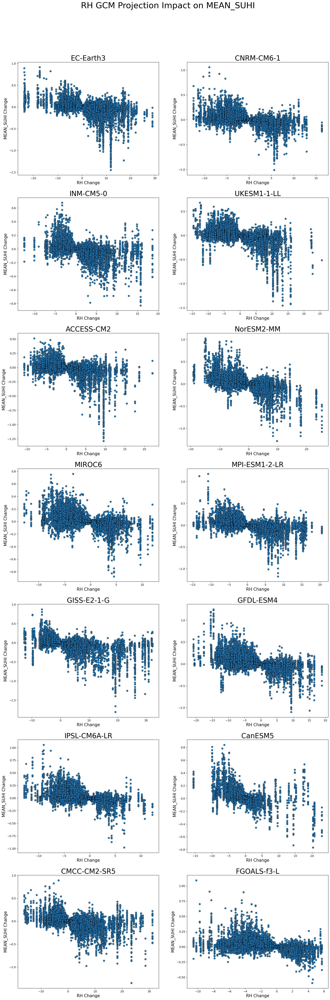

In [51]:
#scatter plots of RH change vs SUHI change for each model

#create the axes
fig, axes = plt.subplots(7,2 ,figsize=(20,60))

plt.suptitle('{} GCM Projection Impact on MEAN_SUHI'.format(climate_var), y = 0.93, fontsize = 30)

row_num = 0
col_num = 0
#min_change = []
#max_change = []
#max_var_value = []
#min_var_value = []
#model_annual_mean_pred_df = pd.DataFrame()

for model in list(set(Climate_Proj_df.Model)):
    
    model_df = Climate_Proj_df[Climate_Proj_df.Model == model].copy()
    # data for the 2 degC climate change projections 
    climate_change_df = all_monthly_data_df2.copy()

    # merge and add in new RH and TP
    climate_change_df = pd.merge(climate_change_df, model_df, how = 'left', on = ['CITY_COUNTRY', 'month'])
    # copy the df to get the changes for RH and TP separately
    var_climate_change_df = climate_change_df.copy()

    var_climate_change_df[climate_var] = (var_climate_change_df[climate_var] 
                                          + var_climate_change_df['{}_Change'.format(climate_var)])

        
    #max_var_value.append(var_climate_change_df[climate_var].max())
    #min_var_value.append(var_climate_change_df[climate_var].min())
    
    #replace the values which go over the threshold amounts
    var_climate_change_df.loc[var_climate_change_df[climate_var] > var_max_threshold, climate_var] = var_max_threshold
    var_climate_change_df.loc[var_climate_change_df[climate_var] < var_min_threshold, climate_var] = var_min_threshold       

    #RH alone
    X_cc_all_data = var_climate_change_df[predictor_variables]
    
    X_cc_all_data_norm = pd.DataFrame(scaler.transform(X_cc_all_data), 
                                         columns = X_cc_all_data.columns) #transform only
    
    var_climate_change_df['CC_PREDICTION'] = RERF_SUHI_MEAN.predict(X_cc_all_data_norm)
    
    var_climate_change_df['SUHI_CHANGE'] = (var_climate_change_df['CC_PREDICTION'] 
                                            - var_climate_change_df['RERF_SUHI_MEAN'])
     
    
    axes[row_num,col_num].scatter(var_climate_change_df['{}_Change'.format(climate_var)].values, 
                                  var_climate_change_df['SUHI_CHANGE'].values,  
                                  linewidths = 0.5, s =40,edgecolor = 'black')
    
    
    
    axes[row_num,col_num].set(title = model, xlabel = '{} Change'.format(climate_var), ylabel = 'MEAN_SUHI Change')     
    
    # move the col and row nums on for the next plot
    if col_num == 1:
        col_num = 0
        row_num = row_num + 1
    
    elif col_num == 0:
        col_num = 1

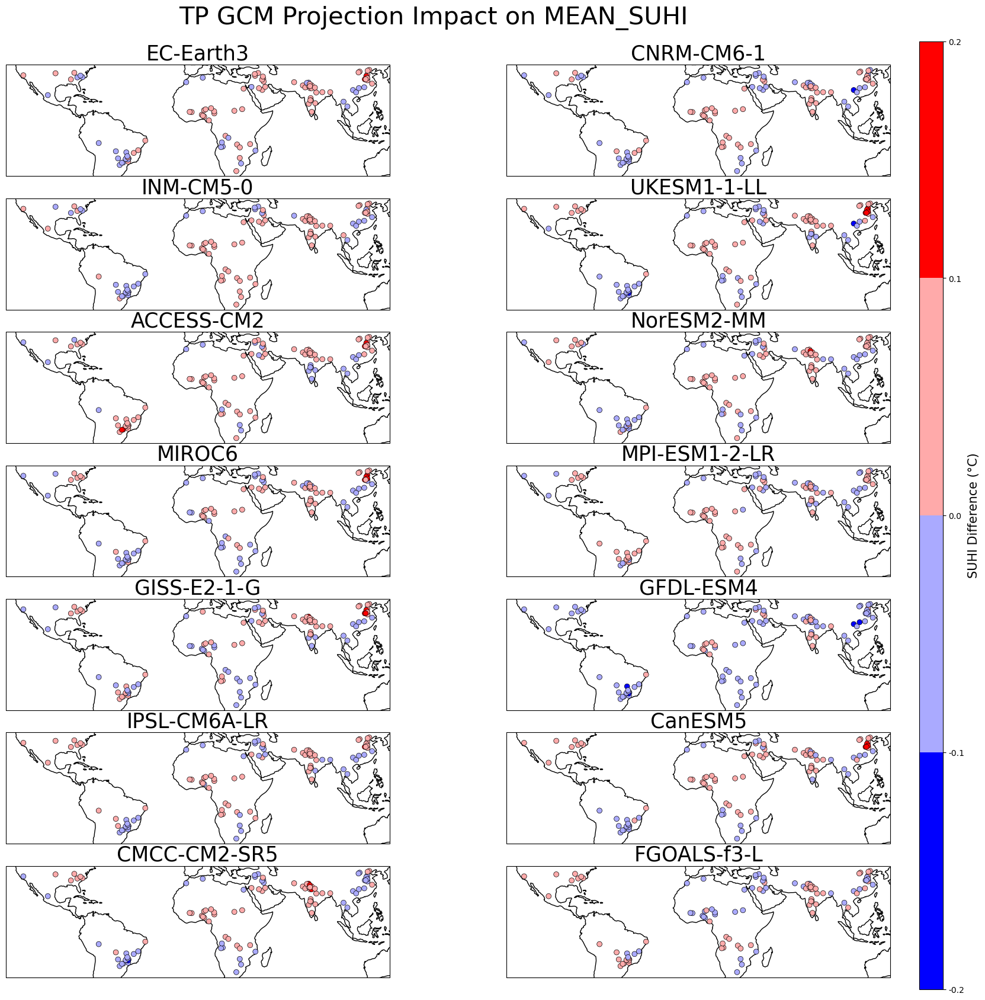

In [52]:
#################################################
############ IMPACT OF TP CHANGES ###############
#################################################

# make sure the normalisation is based on the training data 
X_train_norm = pd.DataFrame(scaler.fit_transform(X_train), columns = X_train.columns) #fit and transform

climate_var = 'TP'
var_max_threshold = 100
var_min_threshold = 0

# create the colormap
SUHI_MEAN_min = -0.2
SUHI_MEAN_max = 0.2
cmap = plt.cm.bwr  # define the colormap
# extract all colors from the .bwr map
cmaplist = [cmap(i) for i in range(cmap.N)]

# create the new map
cmap = mpl.colors.LinearSegmentedColormap.from_list(
    'Custom cmap', cmaplist, cmap.N)

cmap.set_under(color = 'black')

bounds = np.linspace(SUHI_MEAN_min, SUHI_MEAN_max, 5)
norm = mpl.colors.BoundaryNorm(bounds, cmap.N)


#create the axes
fig, axes = plt.subplots(7,2 ,figsize=(20,20), subplot_kw={"projection": ccrs.PlateCarree()})

plt.suptitle('{} GCM Projection Impact on MEAN_SUHI'.format(climate_var), y = 0.93, fontsize = 30)

row_num = 0
col_num = 0
min_change = []
max_change = []
max_var_value = []
min_var_value = []
model_annual_mean_pred_df = pd.DataFrame()

for model in list(set(Climate_Proj_df.Model)):
    
    model_df = Climate_Proj_df[Climate_Proj_df.Model == model].copy()
    # data for the 2 degC climate change projections 
    climate_change_df = all_monthly_data_df2.copy()

    # merge and add in new RH and TP
    climate_change_df = pd.merge(climate_change_df, model_df, how = 'left', on = ['CITY_COUNTRY', 'month'])
    # copy the df to get the changes for RH and TP separately
    var_climate_change_df = climate_change_df.copy()

    var_climate_change_df[climate_var] = (var_climate_change_df[climate_var] 
                                          + var_climate_change_df['{}_Change'.format(climate_var)])

        
    max_var_value.append(var_climate_change_df[climate_var].max())
    min_var_value.append(var_climate_change_df[climate_var].min())
    
    #replace the values which go over the threshold amounts
    var_climate_change_df.loc[var_climate_change_df[climate_var] > var_max_threshold, climate_var] = var_max_threshold
    var_climate_change_df.loc[var_climate_change_df[climate_var] < var_min_threshold, climate_var] = var_min_threshold       

    #RH alone
    X_cc_all_data = var_climate_change_df[predictor_variables]
    
    X_cc_all_data_norm = pd.DataFrame(scaler.transform(X_cc_all_data), 
                                         columns = X_cc_all_data.columns) #transform only
    
    var_climate_change_df['CC_PREDICTION'] = RERF_SUHI_MEAN.predict(X_cc_all_data_norm)
    
    var_climate_change_df['SUHI_CHANGE'] = (var_climate_change_df['CC_PREDICTION'] 
                                            - var_climate_change_df['RERF_SUHI_MEAN'])
     
    df = var_climate_change_df.groupby(['CITY_COUNTRY','Lat','Lon']).mean(numeric_only = True).reset_index()
    CITY_COUNTRY_list = df.CITY_COUNTRY.values
    city_lats = df.Lat.values
    city_lons = df.Lon.values
    SUHI_CHANGE = df.SUHI_CHANGE.values
    
    model_annual_df = pd.DataFrame({'CITY_COUNTRY': CITY_COUNTRY_list, 'Lat':city_lats, 'Lon':city_lons,
                                   'Annual_Mean_SUHI_MEAN_change': SUHI_CHANGE})
    model_annual_df['Model'] = model
    model_annual_mean_pred_df = pd.concat([model_annual_mean_pred_df, model_annual_df])
    
    axes[row_num,col_num].coastlines()
    im = axes[row_num,col_num].scatter(city_lons, city_lats, zorder=5, c=SUHI_CHANGE, linewidths = 0.5,
                                        s =40,edgecolor = 'black',cmap= cmap, norm = norm)
    
    
    axes[row_num,col_num].set(title = model)
    
    min_change.append(SUHI_CHANGE.min())
    max_change.append(SUHI_CHANGE.max())            
    
    # move the col and row nums on for the next plot
    if col_num == 1:
        col_num = 0
        row_num = row_num + 1
    
    elif col_num == 0:
        col_num = 1

#get size and extent of axes:
axpos = ax.get_position()
pos_x = axpos.x0 + axpos.width +0.01  #+ 0.25*axpos.width
pos_y = 0.1
cax_width = 0.02
cax_height = 0.8 #2*axpos.height
#create new axes where the colorbar should go.
#it should be next to the original axes and have the same height
pos_cax = fig.add_axes([pos_x,pos_y,cax_width,cax_height])

fig.colorbar(im, cax = pos_cax,  label = 'SUHI Difference (\u00b0C)', cmap= cmap, norm=norm
            ,spacing='proportional', ticks=bounds, boundaries=bounds, format='%.1f')   

In [53]:
model_annual_mean_pred_df.Annual_Mean_SUHI_MEAN_change.min(),model_annual_mean_pred_df.Annual_Mean_SUHI_MEAN_change.max()

(-0.16135846356088307, 0.2850573844740772)

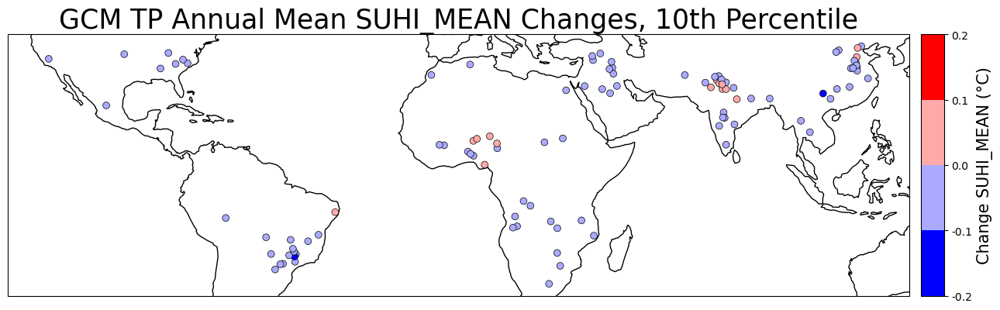

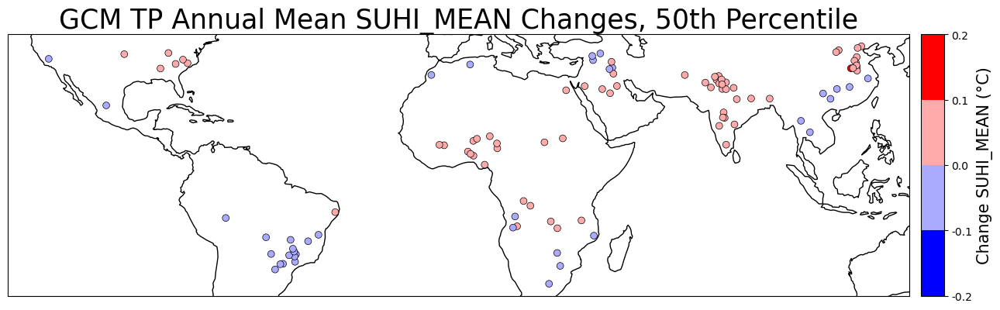

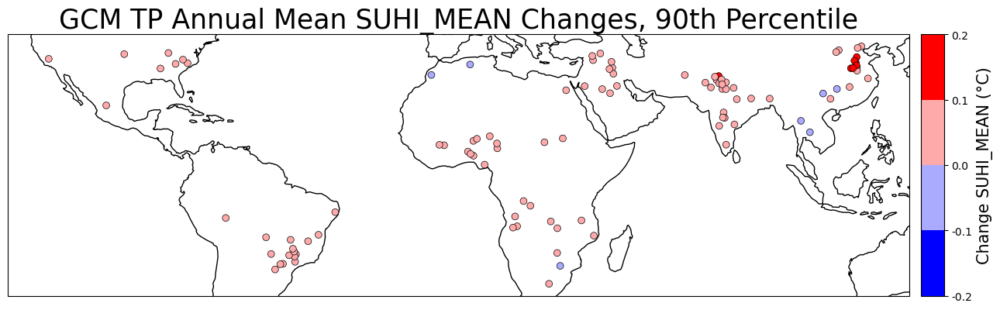

In [54]:
############################################################################
######## MODEL SPREAD: 10th, 50th, 90th Percentiles ########################
############################################################################

# get the median, 10th and 90th percentile changes
spread_df = pd.DataFrame ()
for i in range(len(CITY_COUNTRY_list)):
    CITY_COUNTRY = CITY_COUNTRY_list[i]
    var_changes = (model_annual_mean_pred_df[model_annual_mean_pred_df['CITY_COUNTRY'] == CITY_COUNTRY].
                Annual_Mean_SUHI_MEAN_change)
    lat = (model_annual_mean_pred_df[model_annual_mean_pred_df['CITY_COUNTRY'] == CITY_COUNTRY].Lat.values[0])
    lon = (model_annual_mean_pred_df[model_annual_mean_pred_df['CITY_COUNTRY'] == CITY_COUNTRY].Lon.values[0])

    df = pd.DataFrame({'CITY_COUNTRY': [CITY_COUNTRY], 'Lat':[lat], 'Lon':[lon], 
              'median_var_change':[np.percentile(var_changes, 50)],
              'ten_percentile_var_change':[np.percentile(var_changes, 10)],
              'ninety_percentile_var_change':[np.percentile(var_changes, 90)]}, index = [i])

    spread_df = pd.concat([spread_df, df])

# create the colormap
scale_min = -0.2
scale_max = 0.2
cmap = plt.cm.bwr  # define the colormap
# extract all colors from the .bwr map
cmaplist = [cmap(i) for i in range(cmap.N)]

# create the new map
cmap = mpl.colors.LinearSegmentedColormap.from_list(
    'Custom cmap', cmaplist, cmap.N)

bounds = np.linspace(scale_min, scale_max, 5)
norm = mpl.colors.BoundaryNorm(bounds, cmap.N)

city_lats = spread_df.Lat.values
city_lons = spread_df.Lon.values
median_var_change = spread_df.median_var_change.values
ten_percentile_var_change = spread_df.ten_percentile_var_change.values
ninety_percentile_var_change = spread_df.ninety_percentile_var_change.values

####################################
fig = plt.figure(figsize=(15,10))
ax = plt.axes(projection=ccrs.PlateCarree(), 
              title='GCM {} Annual Mean SUHI_MEAN Changes, 10th Percentile'.format(climate_var))
ax.coastlines()

im = ax.scatter(city_lons, city_lats, zorder=5, c=ten_percentile_var_change, linewidths = 0.5, s =40,edgecolor = 'black',
               cmap= cmap, norm=norm)

#get size and extent of axes:
axpos = ax.get_position()
pos_x = axpos.x0 + axpos.width + 0.01 #+ 0.25*axpos.width
pos_y = axpos.y0  
cax_width = 0.02
cax_height = axpos.height
#create new axes where the colorbar should go.
#it should be next to the original axes and have the same height
pos_cax = fig.add_axes([pos_x,pos_y,cax_width,cax_height])

plt.colorbar(im, cax=pos_cax, label = 'Change SUHI_MEAN (\u00b0C)', cmap= cmap, norm=norm
            ,spacing='proportional', ticks=bounds, boundaries=bounds, format='%0.1f')

#save figure as png
os.chdir(os.path.join(et.io.HOME, 'Documents', 'Python_Scripts', 'PROJECT','Chapter_6','climate_projection_plots',
                     'SUHI_MEAN_changes'))   
plt.savefig('gcm_{}_suhi_mean_change_10_percentile.png'.format(climate_var), bbox_inches = 'tight')
####################################

fig = plt.figure(figsize=(15,10))
ax = plt.axes(projection=ccrs.PlateCarree(), 
              title='GCM {} Annual Mean SUHI_MEAN Changes, 50th Percentile'.format(climate_var))
ax.coastlines()

im = ax.scatter(city_lons, city_lats, zorder=5, c=median_var_change, linewidths = 0.5, s =40,edgecolor = 'black',
               cmap= cmap, norm=norm)

#get size and extent of axes:
axpos = ax.get_position()
pos_x = axpos.x0 + axpos.width + 0.01 #+ 0.25*axpos.width
pos_y = axpos.y0  
cax_width = 0.02
cax_height = axpos.height
#create new axes where the colorbar should go.
#it should be next to the original axes and have the same height
pos_cax = fig.add_axes([pos_x,pos_y,cax_width,cax_height])

plt.colorbar(im, cax=pos_cax, label = 'Change SUHI_MEAN (\u00b0C)', cmap= cmap, norm=norm
            ,spacing='proportional', ticks=bounds, boundaries=bounds, format='%0.1f')

#save figure as png
os.chdir(os.path.join(et.io.HOME, 'Documents', 'Python_Scripts', 'PROJECT','Chapter_6','climate_projection_plots',
                     'SUHI_MEAN_changes'))   
plt.savefig('gcm_{}_suhi_mean_change_50_percentile.png'.format(climate_var), bbox_inches = 'tight')
####################################

fig = plt.figure(figsize=(15,10))
ax = plt.axes(projection=ccrs.PlateCarree(), 
              title='GCM {} Annual Mean SUHI_MEAN Changes, 90th Percentile'.format(climate_var))
ax.coastlines()

im = ax.scatter(city_lons, city_lats, zorder=5, c=ninety_percentile_var_change, linewidths = 0.5, s =40,edgecolor = 'black',
               cmap= cmap, norm=norm)

#get size and extent of axes:
axpos = ax.get_position()
pos_x = axpos.x0 + axpos.width + 0.01 #+ 0.25*axpos.width
pos_y = axpos.y0  
cax_width = 0.02
cax_height = axpos.height
#create new axes where the colorbar should go.
#it should be next to the original axes and have the same height
pos_cax = fig.add_axes([pos_x,pos_y,cax_width,cax_height])

plt.colorbar(im, cax=pos_cax, label = 'Change SUHI_MEAN (\u00b0C)', cmap= cmap, norm=norm
            ,spacing='proportional', ticks=bounds, boundaries=bounds, format='%0.1f')

#save figure as png
os.chdir(os.path.join(et.io.HOME, 'Documents', 'Python_Scripts', 'PROJECT','Chapter_6','climate_projection_plots',
                     'SUHI_MEAN_changes'))   
plt.savefig('gcm_{}_suhi_mean_change_90_percentile.png'.format(climate_var), bbox_inches = 'tight')

In [55]:
spread_df.ten_percentile_var_change.min(), spread_df.ninety_percentile_var_change.max()

(-0.12663216405912517, 0.20777529128426786)

In [56]:
print('Number decreases',len(spread_df[spread_df.median_var_change <0]))
print('Number increases',len(spread_df[spread_df.median_var_change >0]))

Number decreases 37
Number increases 67


In [57]:
37/104, 67/104

(0.3557692307692308, 0.6442307692307693)

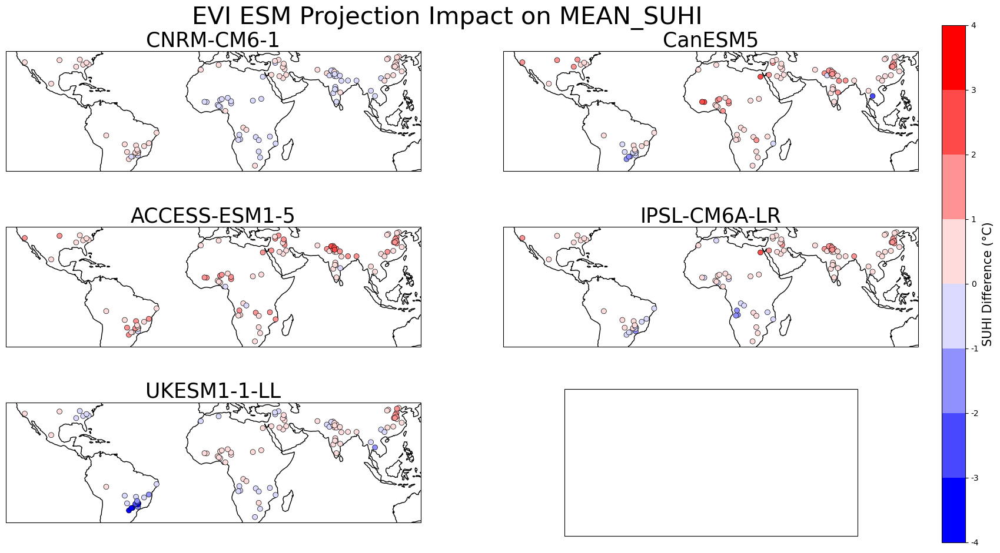

In [58]:
#################################################
############ IMPACT OF EVI CHANGES ###############
#################################################

# make sure the normalisation is based on the training data 
X_train_norm = pd.DataFrame(scaler.fit_transform(X_train), columns = X_train.columns) #fit and transform

climate_var = 'EVI'
var_max_threshold = 1
var_min_threshold = 0

# create the colormap
SUHI_MEAN_min = -4
SUHI_MEAN_max = 4
cmap = plt.cm.bwr  # define the colormap
# extract all colors from the .bwr map
cmaplist = [cmap(i) for i in range(cmap.N)]

# create the new map
cmap = mpl.colors.LinearSegmentedColormap.from_list(
    'Custom cmap', cmaplist, cmap.N)

cmap.set_under(color = 'black')

bounds = np.linspace(SUHI_MEAN_min, SUHI_MEAN_max, 9)
norm = mpl.colors.BoundaryNorm(bounds, cmap.N)


#create the axes
fig, axes = plt.subplots(3,2 ,figsize=(20,11), subplot_kw={"projection": ccrs.PlateCarree()})

plt.suptitle('{} ESM Projection Impact on MEAN_SUHI'.format(climate_var), y = 0.93, fontsize = 30)

row_num = 0
col_num = 0
min_change = []
max_change = []
max_var_value_evi_r = []
min_var_value_evi_r = []
max_var_value_evi_u = []
min_var_value_evi_u = []
max_var_value_evi_d = []
min_var_value_evi_d = []

model_annual_mean_pred_df = pd.DataFrame()

for model in list(set(LAI_Proj_df3.Model)):
    
    model_df = LAI_Proj_df3[LAI_Proj_df3.Model == model].copy()
    # data for the 2 degC climate change projections 
    climate_change_df = all_monthly_data_df2.copy()

    # merge and add in new RH and TP
    climate_change_df = pd.merge(climate_change_df, model_df, how = 'left', on = ['CITY_COUNTRY', 'month'])
    # copy the df to get the changes for RH and TP separately
    var_climate_change_df = climate_change_df.copy()

    var_climate_change_df['EVI_R'] = (var_climate_change_df['EVI_R'] 
                                          + var_climate_change_df['EVI_R_Change'])

        
    var_climate_change_df['EVI_U'] = (var_climate_change_df['EVI_U'] 
                                          + var_climate_change_df['EVI_U_Change'])
        
    var_climate_change_df['EVI_D'] = (var_climate_change_df['EVI_D'] 
                                          + var_climate_change_df['EVI_D_Change']) 
        
    max_var_value_evi_r.append(var_climate_change_df['EVI_R'].max())
    min_var_value_evi_r.append(var_climate_change_df['EVI_R'].min())
    max_var_value_evi_u.append(var_climate_change_df['EVI_U'].max())
    min_var_value_evi_u.append(var_climate_change_df['EVI_U'].min())
    
    
    #replace the values which go over the threshold amounts
    for climate_var in ['EVI_R','EVI_U']:
        var_climate_change_df.loc[var_climate_change_df[climate_var] > var_max_threshold, climate_var] = var_max_threshold
        var_climate_change_df.loc[var_climate_change_df[climate_var] < var_min_threshold, climate_var] = var_min_threshold       

    
    #calculate EVI_D again incase EVI_R has gone over 1 
    var_climate_change_df['EVI_D'] = var_climate_change_df['EVI_U'] - var_climate_change_df['EVI_R']
    
    max_var_value_evi_d.append(var_climate_change_df['EVI_D'].max())
    min_var_value_evi_d.append(var_climate_change_df['EVI_D'].min())
    
    
    #all evi changes
    X_cc_all_data = var_climate_change_df[predictor_variables]
    
    X_cc_all_data_norm = pd.DataFrame(scaler.transform(X_cc_all_data), 
                                         columns = X_cc_all_data.columns) #transform only
    
    var_climate_change_df['CC_PREDICTION'] = RERF_SUHI_MEAN.predict(X_cc_all_data_norm)
    
    var_climate_change_df['SUHI_CHANGE'] = (var_climate_change_df['CC_PREDICTION'] 
                                            - var_climate_change_df['RERF_SUHI_MEAN'])
     
    df = var_climate_change_df.groupby(['CITY_COUNTRY','Lat','Lon']).mean(numeric_only = True).reset_index()
    
    #df = pd.merge(df, CITY_COUNTRY_lat_lon[['CITY_COUNTRY','Lat','Lon']], on = 'CITY_COUNTRY',
    #                           how = 'left')
    
    CITY_COUNTRY_list = df.CITY_COUNTRY.values
    SUHI_CHANGE = df.SUHI_CHANGE.values
    city_lons = df.Lon.values
    city_lats = df.Lat.values
    
    model_annual_df = pd.DataFrame({'CITY_COUNTRY': CITY_COUNTRY_list,'Lat':city_lats,'Lon':city_lons,
                                   'Annual_Mean_SUHI_MEAN_change': SUHI_CHANGE})
    
    model_annual_df['Model'] = model
    model_annual_mean_pred_df = pd.concat([model_annual_mean_pred_df, model_annual_df])
    
    axes[row_num,col_num].coastlines()
    im = axes[row_num,col_num].scatter(city_lons, city_lats, zorder=5, c=SUHI_CHANGE, linewidths = 0.5,
                                        s =40,edgecolor = 'black',cmap= cmap, norm = norm)
    
    axes[row_num,col_num].set(title = model)
    
    min_change.append(SUHI_CHANGE.min())
    max_change.append(SUHI_CHANGE.max())            
    
    # move the col and row nums on for the next plot
    if col_num == 1:
        col_num = 0
        row_num = row_num + 1
    
    elif col_num == 0:
        col_num = 1

#get size and extent of axes:
axpos = ax.get_position()
pos_x = axpos.x0 + axpos.width + 0.02  #+ 0.25*axpos.width
pos_y = 0.1
cax_width = 0.02
cax_height = 0.8 #2*axpos.height
#create new axes where the colorbar should go.
#it should be next to the original axes and have the same height
pos_cax = fig.add_axes([pos_x,pos_y,cax_width,cax_height])

fig.colorbar(im, cax = pos_cax,  label = 'SUHI Difference (\u00b0C)', cmap= cmap, norm=norm
            ,spacing='proportional', ticks=bounds, boundaries=bounds, format='%1i')   

In [59]:
print('EVI_R min and max:',min(min_var_value_evi_r), max(max_var_value_evi_r))
print('EVI_U min and max:',min(min_var_value_evi_u), max(max_var_value_evi_u))
print('EVI_D min and max:',min(min_var_value_evi_d), max(max_var_value_evi_d))

EVI_R min and max: -0.3211456062296161 1.0178254500204234
EVI_U min and max: -0.28716151795809597 0.7791092480994207
EVI_D min and max: -0.5501562793696266 0.08980893986846084


In [60]:
#without calculating EVI again
#EVI_D min and max: -0.5501562793696266 0.08980893986846084

In [61]:
model_annual_mean_pred_df.Annual_Mean_SUHI_MEAN_change.min(),model_annual_mean_pred_df.Annual_Mean_SUHI_MEAN_change.max()

(-3.518005811623793, 2.7733590836320894)

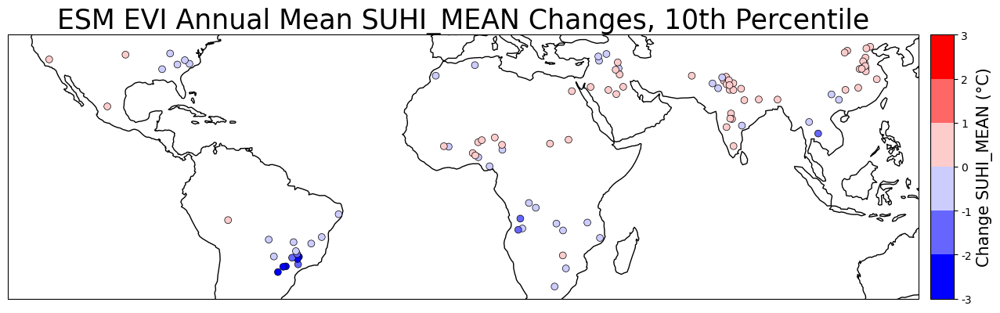

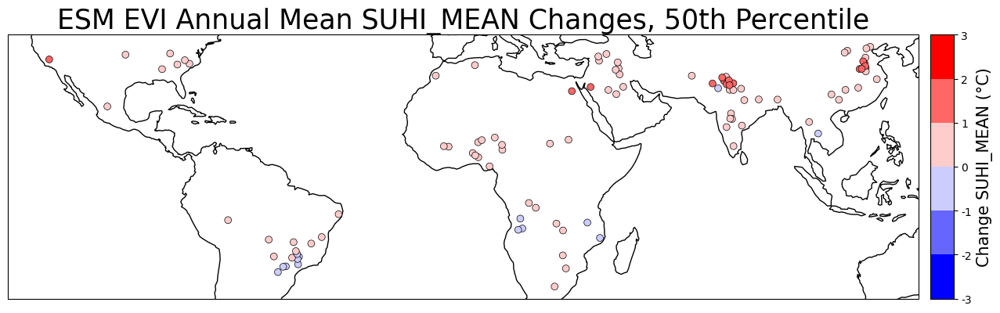

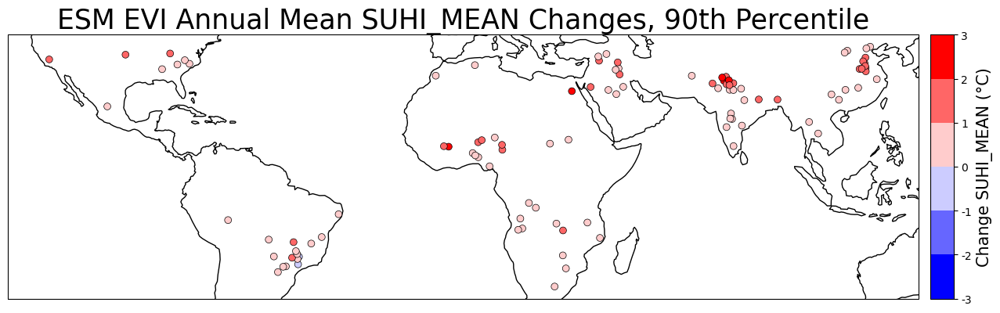

In [62]:
############################################################################
######## MODEL SPREAD: 10th, 50th, 90th Percentiles ########################
############################################################################
climate_var = 'EVI'
# get the median, 10th and 90th percentile changes
spread_df = pd.DataFrame ()
for i in range(len(CITY_COUNTRY_list)):
    CITY_COUNTRY = CITY_COUNTRY_list[i]
    var_changes = (model_annual_mean_pred_df[model_annual_mean_pred_df['CITY_COUNTRY'] == CITY_COUNTRY].
                Annual_Mean_SUHI_MEAN_change)
    lat = (model_annual_mean_pred_df[model_annual_mean_pred_df['CITY_COUNTRY'] == CITY_COUNTRY].Lat.values[0])
    lon = (model_annual_mean_pred_df[model_annual_mean_pred_df['CITY_COUNTRY'] == CITY_COUNTRY].Lon.values[0])

    df = pd.DataFrame({'CITY_COUNTRY': [CITY_COUNTRY], 'Lat':[lat], 'Lon':[lon], 
              'median_var_change':[np.percentile(var_changes, 50)],
              'ten_percentile_var_change':[np.percentile(var_changes, 10)],
              'ninety_percentile_var_change':[np.percentile(var_changes, 90)]}, index = [i])

    spread_df = pd.concat([spread_df, df])

# create the colormap
scale_min = -3
scale_max = 3
cmap = plt.cm.bwr  # define the colormap
# extract all colors from the .bwr map
cmaplist = [cmap(i) for i in range(cmap.N)]

# create the new map
cmap = mpl.colors.LinearSegmentedColormap.from_list(
    'Custom cmap', cmaplist, cmap.N)

bounds = np.linspace(scale_min, scale_max, 7)
norm = mpl.colors.BoundaryNorm(bounds, cmap.N)

city_lats = spread_df.Lat.values
city_lons = spread_df.Lon.values
median_var_change = spread_df.median_var_change.values
ten_percentile_var_change = spread_df.ten_percentile_var_change.values
ninety_percentile_var_change = spread_df.ninety_percentile_var_change.values

####################################
fig = plt.figure(figsize=(15,10))
ax = plt.axes(projection=ccrs.PlateCarree(), 
              title='ESM {} Annual Mean SUHI_MEAN Changes, 10th Percentile'.format('EVI'))
ax.coastlines()

im = ax.scatter(city_lons, city_lats, zorder=5, c=ten_percentile_var_change, linewidths = 0.5, s =40,edgecolor = 'black',
               cmap= cmap, norm=norm)

#get size and extent of axes:
axpos = ax.get_position()
pos_x = axpos.x0 + axpos.width + 0.01 #+ 0.25*axpos.width
pos_y = axpos.y0  
cax_width = 0.02
cax_height = axpos.height
#create new axes where the colorbar should go.
#it should be next to the original axes and have the same height
pos_cax = fig.add_axes([pos_x,pos_y,cax_width,cax_height])

plt.colorbar(im, cax=pos_cax, label = 'Change SUHI_MEAN (\u00b0C)', cmap= cmap, norm=norm
            ,spacing='proportional', ticks=bounds, boundaries=bounds, format='%1i')

#save figure as png
os.chdir(os.path.join(et.io.HOME, 'Documents', 'Python_Scripts', 'PROJECT','Chapter_6','climate_projection_plots',
                     'SUHI_MEAN_changes'))   
plt.savefig('esm_{}_suhi_mean_change_10_percentile.png'.format(climate_var), bbox_inches = 'tight')
####################################

fig = plt.figure(figsize=(15,10))
ax = plt.axes(projection=ccrs.PlateCarree(), 
              title='ESM {} Annual Mean SUHI_MEAN Changes, 50th Percentile'.format('EVI'))
ax.coastlines()

im = ax.scatter(city_lons, city_lats, zorder=5, c=median_var_change, linewidths = 0.5, s =40,edgecolor = 'black',
               cmap= cmap, norm=norm)

#get size and extent of axes:
axpos = ax.get_position()
pos_x = axpos.x0 + axpos.width + 0.01 #+ 0.25*axpos.width
pos_y = axpos.y0  
cax_width = 0.02
cax_height = axpos.height
#create new axes where the colorbar should go.
#it should be next to the original axes and have the same height
pos_cax = fig.add_axes([pos_x,pos_y,cax_width,cax_height])

plt.colorbar(im, cax=pos_cax, label = 'Change SUHI_MEAN (\u00b0C)', cmap= cmap, norm=norm
            ,spacing='proportional', ticks=bounds, boundaries=bounds, format='%1i')

#save figure as png
os.chdir(os.path.join(et.io.HOME, 'Documents', 'Python_Scripts', 'PROJECT','Chapter_6','climate_projection_plots',
                     'SUHI_MEAN_changes'))   
plt.savefig('esm_{}_suhi_mean_change_50_percentile.png'.format(climate_var), bbox_inches = 'tight')
####################################

fig = plt.figure(figsize=(15,10))
ax = plt.axes(projection=ccrs.PlateCarree(), 
              title='ESM {} Annual Mean SUHI_MEAN Changes, 90th Percentile'.format('EVI'))
ax.coastlines()

im = ax.scatter(city_lons, city_lats, zorder=5, c=ninety_percentile_var_change, linewidths = 0.5, s =40,edgecolor = 'black',
               cmap= cmap, norm=norm)

#get size and extent of axes:
axpos = ax.get_position()
pos_x = axpos.x0 + axpos.width + 0.01 #+ 0.25*axpos.width
pos_y = axpos.y0  
cax_width = 0.02
cax_height = axpos.height
#create new axes where the colorbar should go.
#it should be next to the original axes and have the same height
pos_cax = fig.add_axes([pos_x,pos_y,cax_width,cax_height])

plt.colorbar(im, cax=pos_cax, label = 'Change SUHI_MEAN (\u00b0C)', cmap= cmap, norm=norm
            ,spacing='proportional', ticks=bounds, boundaries=bounds, format='%1i')

#save figure as png
os.chdir(os.path.join(et.io.HOME, 'Documents', 'Python_Scripts', 'PROJECT','Chapter_6','climate_projection_plots',
                     'SUHI_MEAN_changes'))   
plt.savefig('esm_{}_suhi_mean_change_90_percentile.png'.format(climate_var), bbox_inches = 'tight')

In [63]:
print('Number decreases',len(spread_df[spread_df.median_var_change <0]))
print('Number increases',len(spread_df[spread_df.median_var_change >0]))

Number decreases 14
Number increases 90


In [64]:
spread_df.ten_percentile_var_change.min(), spread_df.ninety_percentile_var_change.max()

(-2.687136737674101, 2.4069320649286268)

In [65]:
14/104

0.1346153846153846

In [66]:
all_monthly_data_df2['Season'] = np.nan
for count, month in enumerate(all_monthly_data_df2.month):
    if month in [3,4,5]:
        all_monthly_data_df2.loc[count, 'Season'] = 'MAM'
    elif month in [6,7,8]:
        all_monthly_data_df2.loc[count, 'Season'] = 'JJA'
    elif month in [9,10,11]:
        all_monthly_data_df2.loc[count, 'Season'] = 'SON' 
    elif month in [12,1,2]:
        all_monthly_data_df2.loc[count, 'Season'] = 'DJF'

# group the means into 3 month changes
model_season_mean_pred_df = pd.DataFrame()

for model in list(set(LAI_Proj_df3.Model)):
    
    model_df = LAI_Proj_df3[LAI_Proj_df3.Model == model].copy()
    # data for the 2 degC climate change projections 
    climate_change_df = all_monthly_data_df2.copy()

    # merge and add in new RH and TP
    climate_change_df = pd.merge(climate_change_df, model_df, how = 'left', on = ['CITY_COUNTRY', 'month'])
    # copy the df to get the changes for RH and TP separately
    var_climate_change_df = climate_change_df.copy()

    var_climate_change_df['EVI_R'] = (var_climate_change_df['EVI_R'] 
                                          + var_climate_change_df['EVI_R_Change'])

        
    var_climate_change_df['EVI_U'] = (var_climate_change_df['EVI_U'] 
                                          + var_climate_change_df['EVI_U_Change'])
        
    var_climate_change_df['EVI_D'] = (var_climate_change_df['EVI_D'] 
                                          + var_climate_change_df['EVI_D_Change']) 
        
    #max_var_value_evi_r.append(var_climate_change_df['EVI_R'].max())
    #min_var_value_evi_r.append(var_climate_change_df['EVI_R'].min())
    #max_var_value_evi_u.append(var_climate_change_df['EVI_U'].max())
    #min_var_value_evi_u.append(var_climate_change_df['EVI_U'].min())
    
    
    #replace the values which go over the threshold amounts
    for climate_var in ['EVI_R','EVI_U']:
        var_climate_change_df.loc[var_climate_change_df[climate_var] > var_max_threshold, climate_var] = var_max_threshold
        var_climate_change_df.loc[var_climate_change_df[climate_var] < var_min_threshold, climate_var] = var_min_threshold       

    
    #calculate EVI_D again incase EVI_R has gone over 1 
    var_climate_change_df['EVI_D'] = var_climate_change_df['EVI_U'] - var_climate_change_df['EVI_R']
    
    #max_var_value_evi_d.append(var_climate_change_df['EVI_D'].max())
    #min_var_value_evi_d.append(var_climate_change_df['EVI_D'].min())
    
    #all evi changes
    X_cc_all_data = var_climate_change_df[predictor_variables]
    
    X_cc_all_data_norm = pd.DataFrame(scaler.transform(X_cc_all_data), 
                                         columns = X_cc_all_data.columns) #transform only
    
    var_climate_change_df['CC_PREDICTION'] = RERF_SUHI_MEAN.predict(X_cc_all_data_norm)
    
    var_climate_change_df['SUHI_CHANGE'] = (var_climate_change_df['CC_PREDICTION'] 
                                            - var_climate_change_df['RERF_SUHI_MEAN'])
     
    df = var_climate_change_df.groupby(['CITY_COUNTRY', 'Season']).mean(numeric_only = True).reset_index().copy()
    df_to_concat = df[['CITY_COUNTRY','Season','CC_PREDICTION','RERF_SUHI_MEAN','SUHI_CHANGE']].copy()
    
    df_to_concat['Model'] = model
    
    model_season_mean_pred_df = pd.concat([model_season_mean_pred_df, df_to_concat])
    
model_season_mean_pred_df = pd.merge(model_season_mean_pred_df, CITY_COUNTRY_lat_lon[['CITY_COUNTRY','Lat','Lon']],
                                     on = 'CITY_COUNTRY', how = 'left')

In [67]:
model_season_mean_pred_df

,CITY_COUNTRY,Season,CC_PREDICTION,RERF_SUHI_MEAN,SUHI_CHANGE,Model,Lat,Lon
0,AKOLA_INDIA,DJF,-0.525661,-0.525650,-1.150110e-05,CNRM-CM6-1,20.733330,77.000000
1,AKOLA_INDIA,JJA,-0.712265,-0.712266,2.384186e-07,CNRM-CM6-1,20.733330,77.000000
2,AKOLA_INDIA,MAM,-1.835870,-1.835870,8.278423e-08,CNRM-CM6-1,20.733330,77.000000
3,AKOLA_INDIA,SON,0.588928,0.588927,4.385199e-07,CNRM-CM6-1,20.733330,77.000000
4,ALWAR_INDIA,DJF,1.476989,1.477005,-1.593828e-05,CNRM-CM6-1,27.562460,76.625000
...,...,...,...,...,...,...,...,...
2065,ZHUOZHOU_CHINA,SON,1.577933,0.599024,9.789084e-01,UKESM1-1-LL,39.484559,115.978268
2066,ZINDER_NIGER,DJF,-0.387962,-0.224111,-1.638509e-01,UKESM1-1-LL,13.807160,8.988100
2067,ZINDER_NIGER,JJA,-0.020447,-0.101248,8.080115e-02,UKESM1-1-LL,13.807160,8.988100
2068,ZINDER_NIGER,MAM,-0.343757,-0.200621,-1.431360e-01,UKESM1-1-LL,13.807160,8.988100


In [68]:
# get the median, 10th and 90th percentile changes for each season 
seasons = ['MAM','JJA','SON','DJF']
season_spread_df = pd.DataFrame ()

for i in range(len(CITY_COUNTRY_list)):
    CITY_COUNTRY = CITY_COUNTRY_list[i]
    lat = (model_annual_mean_pred_df[model_annual_mean_pred_df['CITY_COUNTRY'] == CITY_COUNTRY].Lat.values[0])
    lon = (model_annual_mean_pred_df[model_annual_mean_pred_df['CITY_COUNTRY'] == CITY_COUNTRY].Lon.values[0])
        
    for season in seasons:
        var_changes = (model_season_mean_pred_df[(model_season_mean_pred_df['CITY_COUNTRY'] == CITY_COUNTRY)&
                                   (model_season_mean_pred_df['Season'] == season)].SUHI_CHANGE)

        if var_changes.size == 0:
            df = pd.DataFrame({'CITY_COUNTRY': [CITY_COUNTRY], 'Lat':[lat], 'Lon':[lon],'Season':[season], 
                  'median_change':[np.nan],
                  'ten_percentile_change':[np.nan],
                  'ninety_percentile_change':[np.nan]}, index = [i])
        else:
            
            df = pd.DataFrame({'CITY_COUNTRY': [CITY_COUNTRY], 'Lat':[lat], 'Lon':[lon],'Season':[season],
                  'median_change':[np.percentile(var_changes, 50)],
                  'ten_percentile_change':[np.percentile(var_changes, 10)],
                  'ninety_percentile_change':[np.percentile(var_changes, 90)]}, index = [i])

        season_spread_df = pd.concat([season_spread_df, df])

# note: UMUAHIA_NIGERIA has no data for MAM and JJA

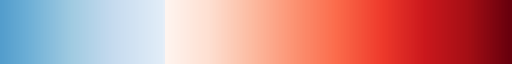

In [69]:


# creation of custom colormap so the white part is still centered on zero
cmap = plt.cm.Reds # define the colormap
# extract all colors from the .bwr map
cmaplist = [cmap(i) for i in range(cmap.N)]

# create the new map
cmap = mpl.colors.LinearSegmentedColormap.from_list(
    'Custom cmap', cmaplist, cmap.N)

cmap_low = plt.cm.Blues_r # define the colormap
# extract all colors from the .bwr map
cmaplist_low = [cmap_low(i) for i in range(cmap_low.N)]

# create the new map
cmap_low = mpl.colors.LinearSegmentedColormap.from_list(
    'Custom cmap', cmaplist_low, cmap_low.N)

length_colormap_low = int((256/0.7)-256)    

cmaplist_low2 = cmaplist_low[length_colormap_low:230]

lengthlow2 = length_colormap_low - (256-230)

# create the new map
#cmap_low2 = mpl.colors.LinearSegmentedColormap.from_list(
#    'Custom cmap', cmaplist_low2, cmap_low2.N)

cmaplist_all = (cmaplist_low2 + cmaplist)

cmap_all = mpl.colors.LinearSegmentedColormap.from_list(
    'Custom cmap', cmaplist_all, (lengthlow2 +cmap.N))

cmap_all

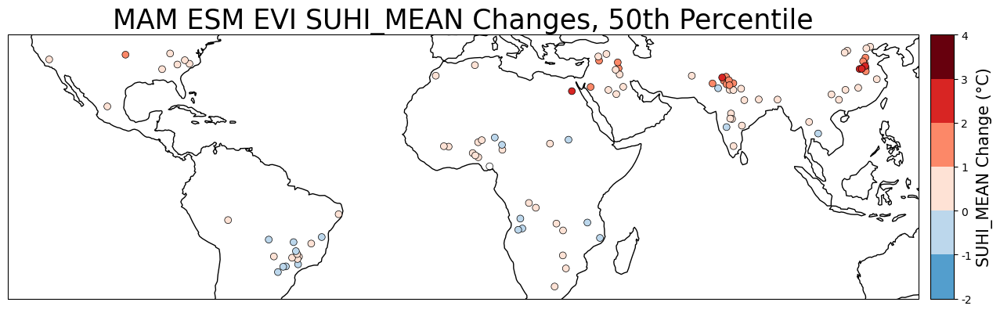

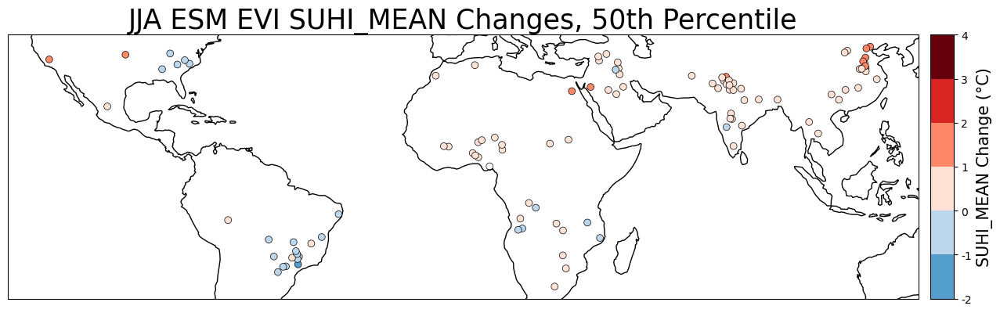

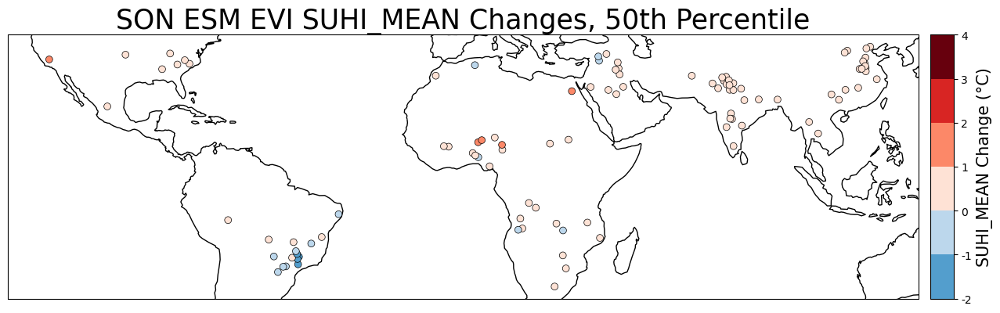

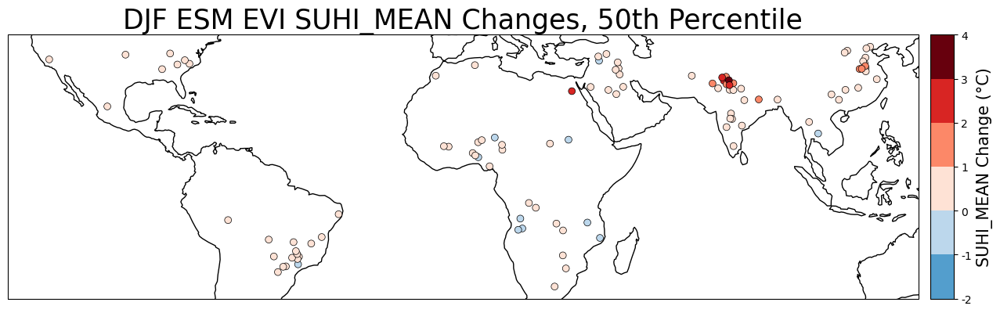

In [70]:
# create the colormap
scale_min = -2
scale_max = 4

bounds = np.linspace(scale_min, scale_max, 7)
norm = mpl.colors.BoundaryNorm(bounds, cmap_all.N)


for i in range(4):
    season = seasons[i]

    fig = plt.figure(figsize=(15,10))
    ax = plt.axes(projection=ccrs.PlateCarree(), title='{} ESM EVI SUHI_MEAN Changes, 50th Percentile'.format(season))
    ax.coastlines()

    df = season_spread_df[(season_spread_df['Season'] == season)]
    city_lats = df.Lat
    city_lons = df.Lon
    SUHI_change = df.median_change

    im = ax.scatter(city_lons, city_lats, zorder=5, c=SUHI_change, linewidths = 0.5, s =40,edgecolor = 'black',
               cmap= cmap_all, norm=norm)

    #get size and extent of axes:
    axpos = ax.get_position()
    pos_x = axpos.x0 + axpos.width + 0.01 #+ 0.25*axpos.width
    pos_y = axpos.y0  
    cax_width = 0.02
    cax_height = axpos.height
    #create new axes where the colorbar should go.
    #it should be next to the original axes and have the same height
    pos_cax = fig.add_axes([pos_x,pos_y,cax_width,cax_height])

    plt.colorbar(im, cax=pos_cax, label = 'SUHI_MEAN Change (\u00b0C)', cmap= cmap, norm=norm
             ,spacing='proportional', ticks=bounds, boundaries=bounds, format='%1i')

    #save figure as png
    os.chdir(os.path.join(et.io.HOME, 'Documents', 'Python_Scripts', 'PROJECT','Chapter_4','figs','SUHI'))   
    #plt.savefig('seasons_{}_SUHI_MEAN_CHANGE_EVI_R.png'.format(season), bbox_inches = 'tight')

In [71]:
season_spread_df.median_change.min(),season_spread_df.median_change.max()

(-1.7159597796014754, 3.638614560753513)

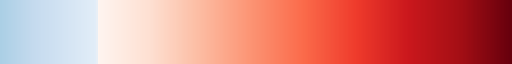

In [72]:
# creation of custom colormap so the white part is still centered on zero
cmap = plt.cm.Reds # define the colormap
# extract all colors from the .bwr map
cmaplist = [cmap(i) for i in range(cmap.N)]

# create the new map
cmap = mpl.colors.LinearSegmentedColormap.from_list(
    'Custom cmap', cmaplist, cmap.N)

cmap_low = plt.cm.Blues_r # define the colormap
# extract all colors from the .bwr map
cmaplist_low = [cmap_low(i) for i in range(cmap_low.N)]

# create the new map
cmap_low = mpl.colors.LinearSegmentedColormap.from_list(
    'Custom cmap', cmaplist_low, cmap_low.N)

length_colormap_low = int((256/0.6)-256)    

cmaplist_low2 = cmaplist_low[length_colormap_low:230]

lengthlow2 = length_colormap_low - (256-230)

# create the new map
#cmap_low2 = mpl.colors.LinearSegmentedColormap.from_list(
#    'Custom cmap', cmaplist_low2, cmap_low2.N)

cmaplist_all = (cmaplist_low2 + cmaplist)

cmap_all = mpl.colors.LinearSegmentedColormap.from_list(
    'Custom cmap', cmaplist_all, (lengthlow2 +cmap.N))

cmap_all

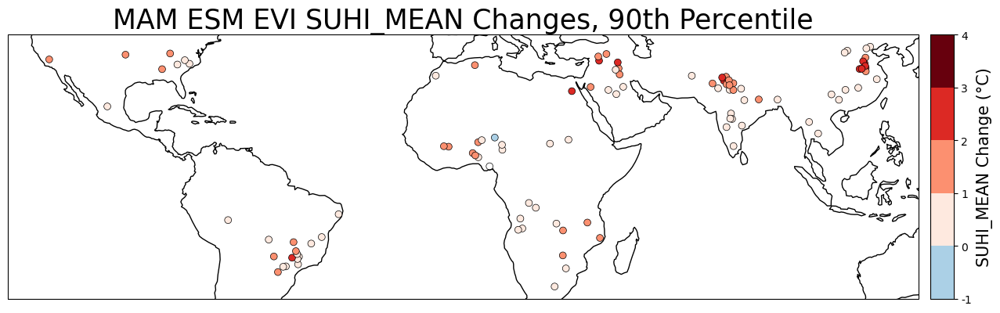

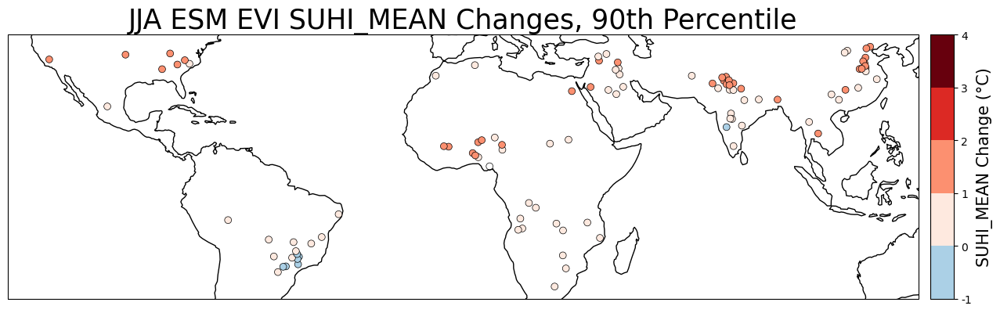

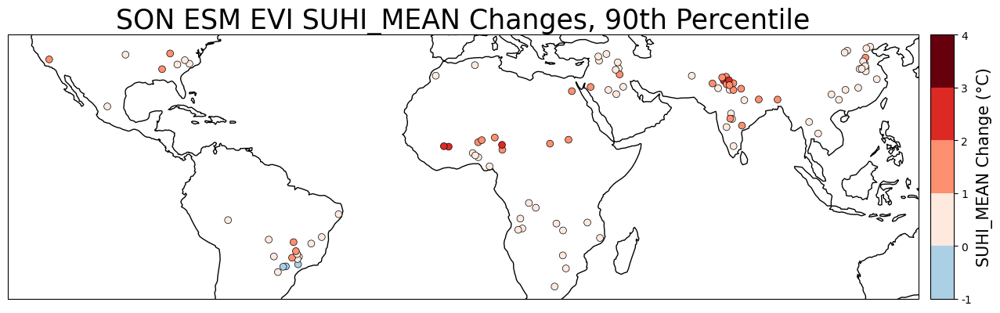

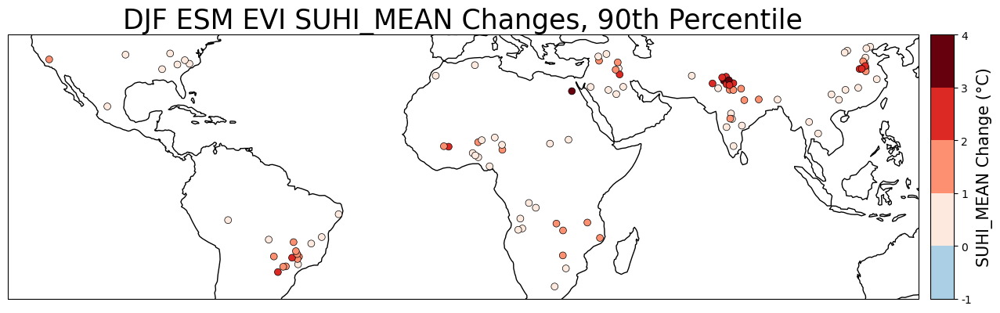

In [73]:
# create the colormap
scale_min = -1
scale_max = 4

bounds = np.linspace(scale_min, scale_max, 6)
norm = mpl.colors.BoundaryNorm(bounds, cmap_all.N)


for i in range(4):
    season = seasons[i]

    fig = plt.figure(figsize=(15,10))
    ax = plt.axes(projection=ccrs.PlateCarree(), title='{} ESM EVI SUHI_MEAN Changes, 90th Percentile'.format(season))
    ax.coastlines()

    df = season_spread_df[(season_spread_df['Season'] == season)]
    city_lats = df.Lat
    city_lons = df.Lon
    SUHI_change = df.ninety_percentile_change

    im = ax.scatter(city_lons, city_lats, zorder=5, c=SUHI_change, linewidths = 0.5, s =40,edgecolor = 'black',
               cmap= cmap_all, norm=norm)

    #get size and extent of axes:
    axpos = ax.get_position()
    pos_x = axpos.x0 + axpos.width + 0.01 #+ 0.25*axpos.width
    pos_y = axpos.y0  
    cax_width = 0.02
    cax_height = axpos.height
    #create new axes where the colorbar should go.
    #it should be next to the original axes and have the same height
    pos_cax = fig.add_axes([pos_x,pos_y,cax_width,cax_height])

    plt.colorbar(im, cax=pos_cax, label = 'SUHI_MEAN Change (\u00b0C)', cmap= cmap, norm=norm
             ,spacing='proportional', ticks=bounds, boundaries=bounds, format='%1i')

    #save figure as png
    os.chdir(os.path.join(et.io.HOME, 'Documents', 'Python_Scripts', 'PROJECT','Chapter_4','figs','SUHI'))   
    #plt.savefig('seasons_{}_SUHI_MEAN_CHANGE_EVI_R.png'.format(season), bbox_inches = 'tight')

In [74]:
season_spread_df.ninety_percentile_change.min(),season_spread_df.ninety_percentile_change.max()

(-0.27998915965060894, 4.04555612154803)

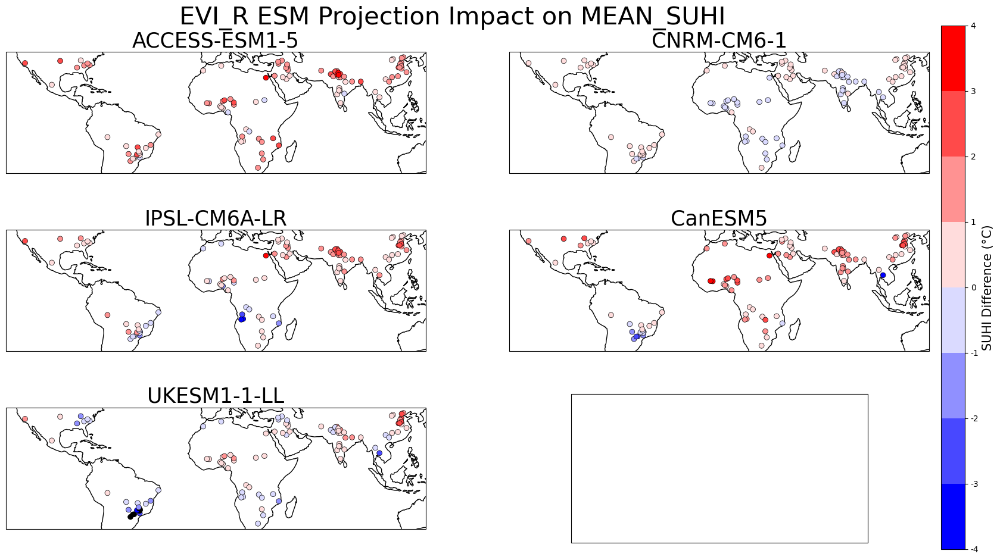

In [75]:
#########################################################
############ IMPACT OF EVI_R only CHANGES ###############
#########################################################

# make sure the normalisation is based on the training data 
X_train_norm = pd.DataFrame(scaler.fit_transform(X_train), columns = X_train.columns) #fit and transform

climate_var = 'EVI_R'
var_max_threshold = 1
var_min_threshold = 0

# create the colormap
SUHI_MEAN_min = -4
SUHI_MEAN_max = 4
cmap = plt.cm.bwr  # define the colormap
# extract all colors from the .bwr map
cmaplist = [cmap(i) for i in range(cmap.N)]

# create the new map
cmap = mpl.colors.LinearSegmentedColormap.from_list(
    'Custom cmap', cmaplist, cmap.N)

cmap.set_under(color = 'black')

bounds = np.linspace(SUHI_MEAN_min, SUHI_MEAN_max, 9)
norm = mpl.colors.BoundaryNorm(bounds, cmap.N)


#create the axes
fig, axes = plt.subplots(3,2 ,figsize=(20,11), subplot_kw={"projection": ccrs.PlateCarree()})

plt.suptitle('{} ESM Projection Impact on MEAN_SUHI'.format(climate_var), y = 0.93, fontsize = 30)

row_num = 0
col_num = 0
min_change = []
max_change = []
max_var_value_evi_r = []
min_var_value_evi_r = []
max_var_value_evi_u = []
min_var_value_evi_u = []
max_var_value_evi_d = []
min_var_value_evi_d = []

model_annual_mean_pred_df = pd.DataFrame()

for model in list(set(LAI_Proj_df3.Model)):
    
    model_df = LAI_Proj_df3[LAI_Proj_df3.Model == model].copy()
    # data for the 2 degC climate change projections 
    climate_change_df = all_monthly_data_df2.copy()

    # merge and add in new RH and TP
    climate_change_df = pd.merge(climate_change_df, model_df, how = 'left', on = ['CITY_COUNTRY', 'month'])
    # copy the df to get the changes for RH and TP separately
    var_climate_change_df = climate_change_df.copy()

    var_climate_change_df['EVI_R'] = (var_climate_change_df['EVI_R'] 
                                          + var_climate_change_df['EVI_R_Change'])

        
    #var_climate_change_df['EVI_U'] = (var_climate_change_df['EVI_U'] 
    #                                      + var_climate_change_df['EVI_U_Change'])
        
    #var_climate_change_df['EVI_D'] = (var_climate_change_df['EVI_D'] 
    #                                      + var_climate_change_df['EVI_D_Change']) 
        
    max_var_value_evi_r.append(var_climate_change_df['EVI_R'].max())
    min_var_value_evi_r.append(var_climate_change_df['EVI_R'].min())
    max_var_value_evi_u.append(var_climate_change_df['EVI_U'].max())
    min_var_value_evi_u.append(var_climate_change_df['EVI_U'].min())
    
    
    #replace the values which go over the threshold amounts
    for climate_var in ['EVI_R']:
        var_climate_change_df.loc[var_climate_change_df[climate_var] > var_max_threshold, climate_var] = var_max_threshold
        var_climate_change_df.loc[var_climate_change_df[climate_var] < var_min_threshold, climate_var] = var_min_threshold       

    
    #calculate EVI_D again incase EVI_R has gone over 1 
    var_climate_change_df['EVI_D'] = var_climate_change_df['EVI_U'] - var_climate_change_df['EVI_R']
    
    max_var_value_evi_d.append(var_climate_change_df['EVI_D'].max())
    min_var_value_evi_d.append(var_climate_change_df['EVI_D'].min())
    
    
    #all evi changes
    X_cc_all_data = var_climate_change_df[predictor_variables]
    
    X_cc_all_data_norm = pd.DataFrame(scaler.transform(X_cc_all_data), 
                                         columns = X_cc_all_data.columns) #transform only
    
    var_climate_change_df['CC_PREDICTION'] = RERF_SUHI_MEAN.predict(X_cc_all_data_norm)
    
    var_climate_change_df['SUHI_CHANGE'] = (var_climate_change_df['CC_PREDICTION'] 
                                            - var_climate_change_df['RERF_SUHI_MEAN'])
     
    df = var_climate_change_df.groupby(['CITY_COUNTRY','Lat','Lon']).mean(numeric_only = True).reset_index()
    CITY_COUNTRY_list = df.CITY_COUNTRY.values
    city_lats = df.Lat.values
    city_lons = df.Lon.values
    SUHI_CHANGE = df.SUHI_CHANGE.values
    
    model_annual_df = pd.DataFrame({'CITY_COUNTRY': CITY_COUNTRY_list, 'Lat':city_lats, 'Lon':city_lons,
                                   'Annual_Mean_SUHI_MEAN_change': SUHI_CHANGE})
    model_annual_df['Model'] = model
    model_annual_mean_pred_df = pd.concat([model_annual_mean_pred_df, model_annual_df])
    
    axes[row_num,col_num].coastlines()
    im = axes[row_num,col_num].scatter(city_lons, city_lats, zorder=5, c=SUHI_CHANGE, linewidths = 0.5,
                                        s =40,edgecolor = 'black',cmap= cmap, norm = norm)
    
    axes[row_num,col_num].set(title = model)
    
    min_change.append(SUHI_CHANGE.min())
    max_change.append(SUHI_CHANGE.max())            
    
    # move the col and row nums on for the next plot
    if col_num == 1:
        col_num = 0
        row_num = row_num + 1
    
    elif col_num == 0:
        col_num = 1

#get size and extent of axes:
axpos = ax.get_position()
pos_x = axpos.x0 + axpos.width +0.01  #+ 0.25*axpos.width
pos_y = 0.1
cax_width = 0.02
cax_height = 0.8 #2*axpos.height
#create new axes where the colorbar should go.
#it should be next to the original axes and have the same height
pos_cax = fig.add_axes([pos_x,pos_y,cax_width,cax_height])

fig.colorbar(im, cax = pos_cax,  label = 'SUHI Difference (\u00b0C)', cmap= cmap, norm=norm
            ,spacing='proportional', ticks=bounds, boundaries=bounds, format='%1i')   

In [76]:
print('EVI_R min and max:',min(min_var_value_evi_r), max(max_var_value_evi_r))
print('EVI_U min and max:',min(min_var_value_evi_u), max(max_var_value_evi_u))
print('EVI_D min and max:',min(min_var_value_evi_d), max(max_var_value_evi_d))

EVI_R min and max: -0.3211456062296161 1.0178254500204234
EVI_U min and max: 0.014829861111111113 0.5372133333333333
EVI_D min and max: -0.6983393351528413 0.2641898511844267


In [77]:
model_annual_mean_pred_df.Annual_Mean_SUHI_MEAN_change.min(),model_annual_mean_pred_df.Annual_Mean_SUHI_MEAN_change.max()

(-4.657633837576001, 4.25226568585172)

In [78]:
climate_var

'EVI_R'

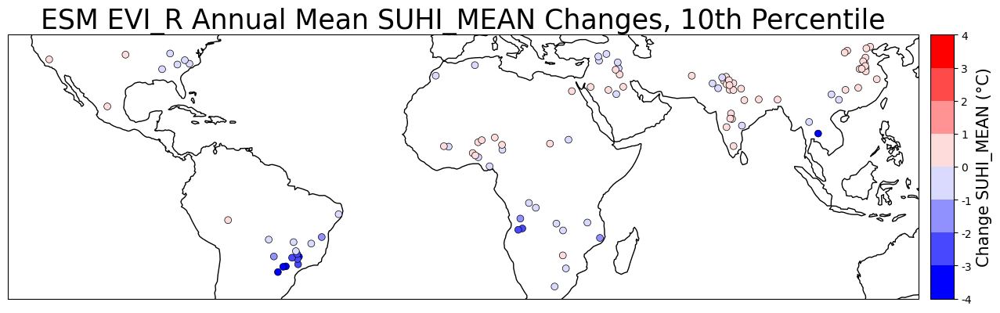

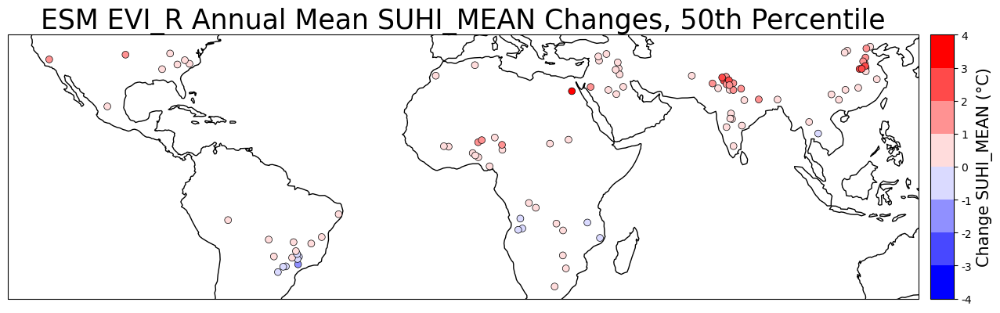

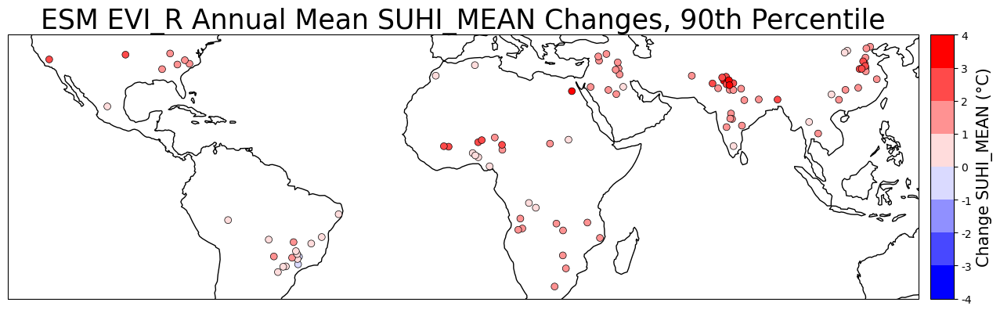

In [79]:
############################################################################
######## MODEL SPREAD: 10th, 50th, 90th Percentiles ########################
############################################################################

# get the median, 10th and 90th percentile changes
spread_df = pd.DataFrame ()
for i in range(len(CITY_COUNTRY_list)):
    CITY_COUNTRY = CITY_COUNTRY_list[i]
    var_changes = (model_annual_mean_pred_df[model_annual_mean_pred_df['CITY_COUNTRY'] == CITY_COUNTRY].
                Annual_Mean_SUHI_MEAN_change)
    lat = (model_annual_mean_pred_df[model_annual_mean_pred_df['CITY_COUNTRY'] == CITY_COUNTRY].Lat.values[0])
    lon = (model_annual_mean_pred_df[model_annual_mean_pred_df['CITY_COUNTRY'] == CITY_COUNTRY].Lon.values[0])

    df = pd.DataFrame({'CITY_COUNTRY': [CITY_COUNTRY], 'Lat':[lat], 'Lon':[lon], 
              'median_var_change':[np.percentile(var_changes, 50)],
              'ten_percentile_var_change':[np.percentile(var_changes, 10)],
              'ninety_percentile_var_change':[np.percentile(var_changes, 90)]}, index = [i])

    spread_df = pd.concat([spread_df, df])

# create the colormap
scale_min = -4
scale_max = 4
cmap = plt.cm.bwr  # define the colormap
# extract all colors from the .bwr map
cmaplist = [cmap(i) for i in range(cmap.N)]

# create the new map
cmap = mpl.colors.LinearSegmentedColormap.from_list(
    'Custom cmap', cmaplist, cmap.N)

bounds = np.linspace(scale_min, scale_max, 9)
norm = mpl.colors.BoundaryNorm(bounds, cmap.N)

city_lats = spread_df.Lat.values
city_lons = spread_df.Lon.values
median_var_change = spread_df.median_var_change.values
ten_percentile_var_change = spread_df.ten_percentile_var_change.values
ninety_percentile_var_change = spread_df.ninety_percentile_var_change.values

####################################
fig = plt.figure(figsize=(15,10))
ax = plt.axes(projection=ccrs.PlateCarree(), 
              title='ESM {} Annual Mean SUHI_MEAN Changes, 10th Percentile'.format(climate_var))
ax.coastlines()

im = ax.scatter(city_lons, city_lats, zorder=5, c=ten_percentile_var_change, linewidths = 0.5, s =40,edgecolor = 'black',
               cmap= cmap, norm=norm)

#get size and extent of axes:
axpos = ax.get_position()
pos_x = axpos.x0 + axpos.width + 0.01 #+ 0.25*axpos.width
pos_y = axpos.y0  
cax_width = 0.02
cax_height = axpos.height
#create new axes where the colorbar should go.
#it should be next to the original axes and have the same height
pos_cax = fig.add_axes([pos_x,pos_y,cax_width,cax_height])

plt.colorbar(im, cax=pos_cax, label = 'Change SUHI_MEAN (\u00b0C)', cmap= cmap, norm=norm
            ,spacing='proportional', ticks=bounds, boundaries=bounds, format='%1i')

#save figure as png
os.chdir(os.path.join(et.io.HOME, 'Documents', 'Python_Scripts', 'PROJECT','Chapter_6','climate_projection_plots',
                     'SUHI_MEAN_changes'))   
plt.savefig('esm_{}_suhi_mean_change_10_percentile.png'.format(climate_var), bbox_inches = 'tight')
####################################

fig = plt.figure(figsize=(15,10))
ax = plt.axes(projection=ccrs.PlateCarree(), 
              title='ESM {} Annual Mean SUHI_MEAN Changes, 50th Percentile'.format(climate_var))
ax.coastlines()

im = ax.scatter(city_lons, city_lats, zorder=5, c=median_var_change, linewidths = 0.5, s =40,edgecolor = 'black',
               cmap= cmap, norm=norm)

#get size and extent of axes:
axpos = ax.get_position()
pos_x = axpos.x0 + axpos.width + 0.01 #+ 0.25*axpos.width
pos_y = axpos.y0  
cax_width = 0.02
cax_height = axpos.height
#create new axes where the colorbar should go.
#it should be next to the original axes and have the same height
pos_cax = fig.add_axes([pos_x,pos_y,cax_width,cax_height])

plt.colorbar(im, cax=pos_cax, label = 'Change SUHI_MEAN (\u00b0C)', cmap= cmap, norm=norm
            ,spacing='proportional', ticks=bounds, boundaries=bounds, format='%1i')

#save figure as png
os.chdir(os.path.join(et.io.HOME, 'Documents', 'Python_Scripts', 'PROJECT','Chapter_6','climate_projection_plots',
                     'SUHI_MEAN_changes'))   
plt.savefig('esm_{}_suhi_mean_change_50_percentile.png'.format(climate_var), bbox_inches = 'tight')
####################################

fig = plt.figure(figsize=(15,10))
ax = plt.axes(projection=ccrs.PlateCarree(), 
              title='ESM {} Annual Mean SUHI_MEAN Changes, 90th Percentile'.format(climate_var))
ax.coastlines()

im = ax.scatter(city_lons, city_lats, zorder=5, c=ninety_percentile_var_change, linewidths = 0.5, s =40,edgecolor = 'black',
               cmap= cmap, norm=norm)

#get size and extent of axes:
axpos = ax.get_position()
pos_x = axpos.x0 + axpos.width + 0.01 #+ 0.25*axpos.width
pos_y = axpos.y0  
cax_width = 0.02
cax_height = axpos.height
#create new axes where the colorbar should go.
#it should be next to the original axes and have the same height
pos_cax = fig.add_axes([pos_x,pos_y,cax_width,cax_height])

plt.colorbar(im, cax=pos_cax, label = 'Change SUHI_MEAN (\u00b0C)', cmap= cmap, norm=norm
            ,spacing='proportional', ticks=bounds, boundaries=bounds, format='%1i')

#save figure as png
os.chdir(os.path.join(et.io.HOME, 'Documents', 'Python_Scripts', 'PROJECT','Chapter_6','climate_projection_plots',
                     'SUHI_MEAN_changes'))   
plt.savefig('esm_{}_suhi_mean_change_90_percentile.png'.format(climate_var), bbox_inches = 'tight')

In [80]:
spread_df.ten_percentile_var_change.min(), spread_df.ninety_percentile_var_change.max()

(-3.5762839009271503, 3.796244041216491)

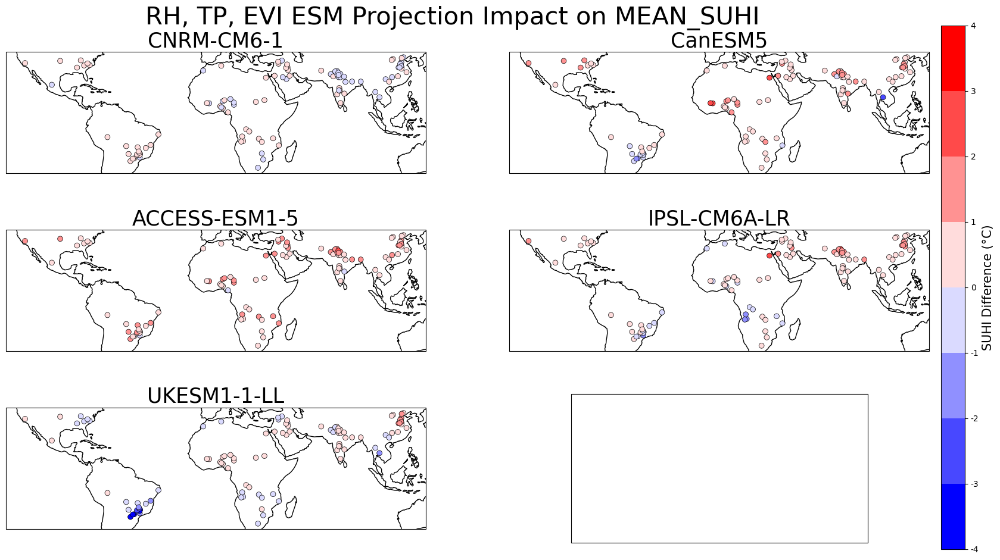

In [75]:
##############################################################
############ IMPACT OF ESM RH, TP, EVI CHANGES ###############
##############################################################

# make sure the normalisation is based on the training data 
X_train_norm = pd.DataFrame(scaler.fit_transform(X_train), columns = X_train.columns) #fit and transform

var_max_threshold_evi = 1
var_min_threshold_evi = 0

var_max_threshold_rh_tp = 100
var_min_threshold_rh_tp = 0

# create the colormap
SUHI_MEAN_min = -4
SUHI_MEAN_max = 4
cmap = plt.cm.bwr  # define the colormap
# extract all colors from the .bwr map
cmaplist = [cmap(i) for i in range(cmap.N)]

# create the new map
cmap = mpl.colors.LinearSegmentedColormap.from_list(
    'Custom cmap', cmaplist, cmap.N)

#cmap.set_under(color = 'black')

bounds = np.linspace(SUHI_MEAN_min, SUHI_MEAN_max, 9)
norm = mpl.colors.BoundaryNorm(bounds, cmap.N)


#create the axes
fig, axes = plt.subplots(3,2 ,figsize=(20,11), subplot_kw={"projection": ccrs.PlateCarree()})

plt.suptitle('RH, TP, EVI ESM Projection Impact on MEAN_SUHI', y = 0.93, fontsize = 30)

row_num = 0
col_num = 0
min_change = []
max_change = []
#max_var_value_evi_r = []
#min_var_value_evi_r = []
#max_var_value_evi_u = []
#min_var_value_evi_u = []
#max_var_value_evi_d = []
#min_var_value_evi_d = []

model_annual_mean_pred_df = pd.DataFrame()

for model in list(set(LAI_Proj_df3.Model)):
    
    model_df = LAI_Proj_df3[LAI_Proj_df3.Model == model].copy()
    # data for the 2 degC climate change projections 
    climate_change_df = all_monthly_data_df2.copy()

    # merge and add in new RH and TP
    climate_change_df = pd.merge(climate_change_df, model_df, how = 'left', on = ['CITY_COUNTRY', 'month'])
    # copy the df to get the changes for RH and TP separately
    var_climate_change_df = climate_change_df.copy()

    var_climate_change_df['EVI_R'] = (var_climate_change_df['EVI_R'] 
                                          + var_climate_change_df['EVI_R_Change'])

        
    var_climate_change_df['EVI_U'] = (var_climate_change_df['EVI_U'] 
                                          + var_climate_change_df['EVI_U_Change'])
        
    var_climate_change_df['EVI_D'] = (var_climate_change_df['EVI_D'] 
                                          + var_climate_change_df['EVI_D_Change']) 
        
    var_climate_change_df['RH'] = (var_climate_change_df['RH'] 
                                          + var_climate_change_df['RH_Change'])
    
    var_climate_change_df['TP'] = (var_climate_change_df['TP'] 
                                          + var_climate_change_df['TP_Change'])
    
    #replace the values which go over the threshold amounts
    for climate_var in ['EVI_R','EVI_U']:
        var_climate_change_df.loc[var_climate_change_df[climate_var] > var_max_threshold_evi, climate_var] = var_max_threshold_evi
        var_climate_change_df.loc[var_climate_change_df[climate_var] < var_min_threshold_evi, climate_var] = var_min_threshold_evi       

    for climate_var in ['RH','TP']:
        var_climate_change_df.loc[var_climate_change_df[climate_var] > var_max_threshold_rh_tp, climate_var] = var_max_threshold_rh_tp
        var_climate_change_df.loc[var_climate_change_df[climate_var] < var_min_threshold_rh_tp, climate_var] = var_min_threshold_rh_tp       

    #calculate EVI_D again incase EVI_R has gone over 1 
    var_climate_change_df['EVI_D'] = var_climate_change_df['EVI_U'] - var_climate_change_df['EVI_R']
    
    
    #all evi changes
    X_cc_all_data = var_climate_change_df[predictor_variables]
    
    X_cc_all_data_norm = pd.DataFrame(scaler.transform(X_cc_all_data), 
                                         columns = X_cc_all_data.columns) #transform only
    
    var_climate_change_df['CC_PREDICTION'] = RERF_SUHI_MEAN.predict(X_cc_all_data_norm)
    
    var_climate_change_df['SUHI_CHANGE'] = (var_climate_change_df['CC_PREDICTION'] 
                                            - var_climate_change_df['RERF_SUHI_MEAN'])
     
    df = var_climate_change_df.groupby(['CITY_COUNTRY','Lat','Lon']).mean(numeric_only = True).reset_index()
    CITY_COUNTRY_list = df.CITY_COUNTRY.values
    city_lats = df.Lat.values
    city_lons = df.Lon.values
    SUHI_CHANGE = df.SUHI_CHANGE.values
    CC_PREDICTION = df.CC_PREDICTION.values
    
    model_annual_df = pd.DataFrame({'CITY_COUNTRY': CITY_COUNTRY_list, 'Lat':city_lats, 'Lon':city_lons,
                                   'Annual_Mean_SUHI_MEAN_change': SUHI_CHANGE,
                                    'Annual_Mean_SUHI_MEAN_CC': CC_PREDICTION})
    model_annual_df['Model'] = model
    model_annual_mean_pred_df = pd.concat([model_annual_mean_pred_df, model_annual_df])
    
    axes[row_num,col_num].coastlines()
    im = axes[row_num,col_num].scatter(city_lons, city_lats, zorder=5, c=SUHI_CHANGE, linewidths = 0.5,
                                        s =40,edgecolor = 'black',cmap= cmap, norm = norm)
    
    
    axes[row_num,col_num].set(title = model)
    
    min_change.append(SUHI_CHANGE.min())
    max_change.append(SUHI_CHANGE.max())            
    
    # move the col and row nums on for the next plot
    if col_num == 1:
        col_num = 0
        row_num = row_num + 1
    
    elif col_num == 0:
        col_num = 1

#get size and extent of axes:
axpos = ax.get_position()
pos_x = axpos.x0 + axpos.width +0.01  #+ 0.25*axpos.width
pos_y = 0.1
cax_width = 0.02
cax_height = 0.8 #2*axpos.height
#create new axes where the colorbar should go.
#it should be next to the original axes and have the same height
pos_cax = fig.add_axes([pos_x,pos_y,cax_width,cax_height])

fig.colorbar(im, cax = pos_cax,  label = 'SUHI Difference (\u00b0C)', cmap= cmap, norm=norm
            ,spacing='proportional', ticks=bounds, boundaries=bounds, format='%1i')   

In [76]:
model_annual_mean_pred_df.Annual_Mean_SUHI_MEAN_change.min(),model_annual_mean_pred_df.Annual_Mean_SUHI_MEAN_change.max()

(-3.562466356083551, 2.624218248106599)

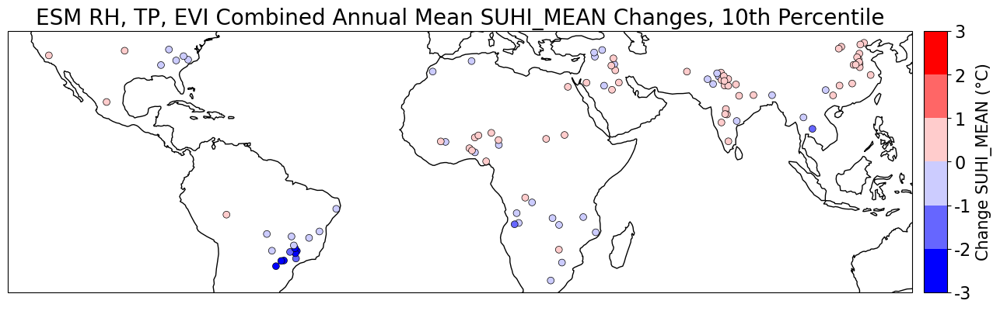

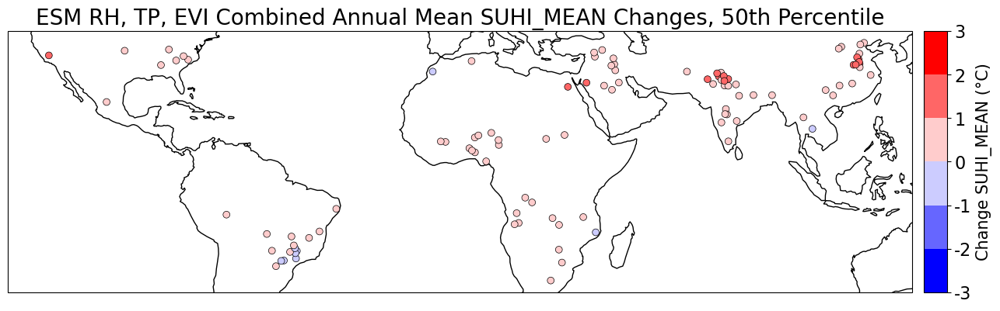

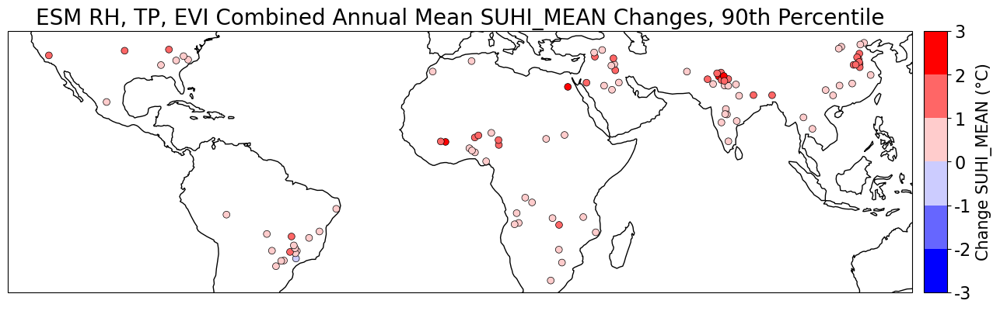

In [196]:
############################################################################
######## MODEL SPREAD: 10th, 50th, 90th Percentiles ########################
############################################################################
#plt.rc('font', size=15)          # controls default text sizes
plt.rc('axes', titlesize=20)     # fontsize of the axes title
plt.rc('axes', labelsize=15)    # fontsize of the x and y labels
#plt.rc('xtick', labelsize=15)    # fontsize of the tick labels
#plt.rc('ytick', labelsize=15)    # fontsize of the tick labels
#plt.rc('legend', fontsize=20)    # legend fontsize
plt.rc('figure', titlesize=20)  # fontsize of the figure title

# get the median, 10th and 90th percentile changes
spread_df = pd.DataFrame ()
for i in range(len(CITY_COUNTRY_list)):
    CITY_COUNTRY = CITY_COUNTRY_list[i]
    var_changes = (model_annual_mean_pred_df[model_annual_mean_pred_df['CITY_COUNTRY'] == CITY_COUNTRY].
                Annual_Mean_SUHI_MEAN_change)
    
    lat = (model_annual_mean_pred_df[model_annual_mean_pred_df['CITY_COUNTRY'] == CITY_COUNTRY].Lat.values[0])
    lon = (model_annual_mean_pred_df[model_annual_mean_pred_df['CITY_COUNTRY'] == CITY_COUNTRY].Lon.values[0])

    df = pd.DataFrame({'CITY_COUNTRY': [CITY_COUNTRY], 'Lat':[lat], 'Lon':[lon], 
              'median_var_change':[np.percentile(var_changes, 50)],
              'ten_percentile_var_change':[np.percentile(var_changes, 10)],
              'ninety_percentile_var_change':[np.percentile(var_changes, 90)]}, index = [i])

    spread_df = pd.concat([spread_df, df])

# create the colormap
scale_min = -3
scale_max = 3
cmap = plt.cm.bwr  # define the colormap
# extract all colors from the .bwr map
cmaplist = [cmap(i) for i in range(cmap.N)]

# create the new map
cmap = mpl.colors.LinearSegmentedColormap.from_list(
    'Custom cmap', cmaplist, cmap.N)

bounds = np.linspace(scale_min, scale_max, 7)
norm = mpl.colors.BoundaryNorm(bounds, cmap.N)

city_lats = spread_df.Lat.values
city_lons = spread_df.Lon.values
median_var_change = spread_df.median_var_change.values
ten_percentile_var_change = spread_df.ten_percentile_var_change.values
ninety_percentile_var_change = spread_df.ninety_percentile_var_change.values

####################################
fig = plt.figure(figsize=(15,10))
ax = plt.axes(projection=ccrs.PlateCarree(), 
              title='ESM RH, TP, EVI Combined Annual Mean SUHI_MEAN Changes, 10th Percentile')
ax.coastlines()

im = ax.scatter(city_lons, city_lats, zorder=5, c=ten_percentile_var_change, linewidths = 0.5, s =40,edgecolor = 'black',
               cmap= cmap, norm=norm)

#get size and extent of axes:
axpos = ax.get_position()
pos_x = axpos.x0 + axpos.width + 0.01 #+ 0.25*axpos.width
pos_y = axpos.y0  
cax_width = 0.02
cax_height = axpos.height
#create new axes where the colorbar should go.
#it should be next to the original axes and have the same height
pos_cax = fig.add_axes([pos_x,pos_y,cax_width,cax_height])

plt.colorbar(im, cax=pos_cax, label = 'Change SUHI_MEAN (\u00b0C)', cmap= cmap, norm=norm
            ,spacing='proportional', ticks=bounds, boundaries=bounds, format='%1i')

#save figure as png
os.chdir(os.path.join(et.io.HOME, 'Documents', 'Python_Scripts', 'PROJECT','Chapter_6','climate_projection_plots',
                     'SUHI_MEAN_changes'))   
plt.savefig('esm_rh_tp_evi_suhi_mean_change_10_percentile.png'.format(climate_var), bbox_inches = 'tight')
####################################

fig = plt.figure(figsize=(15,10))
ax = plt.axes(projection=ccrs.PlateCarree(), 
              title='ESM RH, TP, EVI Combined Annual Mean SUHI_MEAN Changes, 50th Percentile')
ax.coastlines()

im = ax.scatter(city_lons, city_lats, zorder=5, c=median_var_change, linewidths = 0.5, s =40,edgecolor = 'black',
               cmap= cmap, norm=norm)

#get size and extent of axes:
axpos = ax.get_position()
pos_x = axpos.x0 + axpos.width + 0.01 #+ 0.25*axpos.width
pos_y = axpos.y0  
cax_width = 0.02
cax_height = axpos.height
#create new axes where the colorbar should go.
#it should be next to the original axes and have the same height
pos_cax = fig.add_axes([pos_x,pos_y,cax_width,cax_height])

plt.colorbar(im, cax=pos_cax, label = 'Change SUHI_MEAN (\u00b0C)', cmap= cmap, norm=norm
            ,spacing='proportional', ticks=bounds, boundaries=bounds, format='%1i')

#save figure as png
os.chdir(os.path.join(et.io.HOME, 'Documents', 'Python_Scripts', 'PROJECT','Chapter_6','climate_projection_plots',
                     'SUHI_MEAN_changes'))   
plt.savefig('esm_rh_tp_evi_suhi_mean_change_50_percentile.png'.format(climate_var), bbox_inches = 'tight')
####################################

fig = plt.figure(figsize=(15,10))
ax = plt.axes(projection=ccrs.PlateCarree(), 
              title='ESM RH, TP, EVI Combined Annual Mean SUHI_MEAN Changes, 90th Percentile')
ax.coastlines()

im = ax.scatter(city_lons, city_lats, zorder=5, c=ninety_percentile_var_change, linewidths = 0.5, s =40,edgecolor = 'black',
               cmap= cmap, norm=norm)

#get size and extent of axes:
axpos = ax.get_position()
pos_x = axpos.x0 + axpos.width + 0.01 #+ 0.25*axpos.width
pos_y = axpos.y0  
cax_width = 0.02
cax_height = axpos.height
#create new axes where the colorbar should go.
#it should be next to the original axes and have the same height
pos_cax = fig.add_axes([pos_x,pos_y,cax_width,cax_height])

plt.colorbar(im, cax=pos_cax, label = 'Change SUHI_MEAN (\u00b0C)', cmap= cmap, norm=norm
            ,spacing='proportional', ticks=bounds, boundaries=bounds, format='%1i')

#save figure as png
os.chdir(os.path.join(et.io.HOME, 'Documents', 'Python_Scripts', 'PROJECT','Chapter_6','climate_projection_plots',
                     'SUHI_MEAN_changes'))   
plt.savefig('esm_rh_tp_evi_suhi_mean_change_90_percentile.png', bbox_inches = 'tight')

In [197]:
spread_df.ten_percentile_var_change.min(), spread_df.ninety_percentile_var_change.max()

(-2.672442804714769, 2.3057566882331915)

In [205]:
all_monthly_data_df2#.groupby(['CITY_COUNTRY', 'year']).mean(numeric_only = True).reset_index()

,EVI_U,EVI_D,LOG_AREA,WSA_D,ELEVATION_D,RH,TP,STD_ELEVATION_U,SUHI_MEAN,Overpass,month,year,CITY_COUNTRY,City,EVI_R,T2M,RERF_SUHI_MEAN,Season
0,0.174813,0.010057,1.545101,0.015964,24.251064,32.659958,0.000004,24.476705,-1.461481,13:30,7,2002,HUAMBO_ANGOLA,Huambo,0.164755,291.976410,-1.205886,JJA
1,0.163986,0.003686,1.546131,0.016138,24.251064,35.970322,0.000215,24.476705,-1.388989,13:30,8,2002,HUAMBO_ANGOLA,Huambo,0.160300,293.212769,-1.132758,JJA
2,0.172454,-0.026259,1.547159,0.014460,24.251064,38.924397,0.000651,24.476705,-0.144017,13:30,9,2002,HUAMBO_ANGOLA,Huambo,0.198712,294.594177,-0.345515,SON
3,0.286211,-0.038707,1.550228,0.007466,24.251064,83.382210,0.007687,24.476705,-0.155518,13:30,12,2002,HUAMBO_ANGOLA,Huambo,0.324918,291.866333,0.933958,DJF
4,0.378984,0.023308,1.551247,0.007449,24.251064,85.686295,0.009462,24.476705,0.603956,13:30,1,2003,HUAMBO_ANGOLA,Huambo,0.355676,291.865997,0.677440,DJF
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15413,0.428870,-0.113862,2.408240,0.001667,-60.369797,71.317200,0.005051,48.250392,5.432030,13:30,5,2020,GREENVILLE_USA,Greenville,0.542733,290.923340,5.570883,MAM
15414,0.417012,-0.120490,2.408240,-0.002854,-60.369797,71.337242,0.002981,48.250392,6.260467,13:30,7,2020,GREENVILLE_USA,Greenville,0.537502,299.510437,5.547204,JJA
15415,0.360948,-0.091001,2.408240,0.003838,-60.369797,74.295181,0.007240,48.250392,4.402636,13:30,9,2020,GREENVILLE_USA,Greenville,0.451950,294.176514,4.398217,SON
15416,0.310736,-0.072330,2.408240,0.005974,-60.369797,75.925438,0.005163,48.250392,2.365286,13:30,10,2020,GREENVILLE_USA,Greenville,0.383066,290.422638,3.327494,SON


In [198]:
#spread_df[(spread_df.Lat <15)& (spread_df.Lon >-7)& (spread_df.Lon <45)]
spread_df

,CITY_COUNTRY,Lat,Lon,median_var_change,ten_percentile_var_change,ninety_percentile_var_change
0,AKOLA_INDIA,20.733330,77.000000,0.095230,0.005127,0.486523
1,ALWAR_INDIA,27.562460,76.625000,0.154133,0.009174,0.795390
2,AL_OBEID_SUDAN,13.184167,30.216667,0.027929,0.008781,0.672691
3,AL_RAQQA_SYRIA,35.950000,39.016670,0.286938,-0.104994,1.148875
4,ANAPOLIS_BRAZIL,-16.326670,-48.952780,0.323612,-0.220029,1.175433
...,...,...,...,...,...,...
99,YULIN_SHAANXI_CHINA,38.283840,109.731486,0.444767,0.146676,0.566735
100,ZACATECAS_MEXICO,22.775590,-102.572180,0.232829,0.069748,0.404286
101,ZHOUKOU_CHINA,33.617368,114.646126,1.188888,0.360123,1.575808
102,ZHUOZHOU_CHINA,39.484559,115.978268,0.789790,0.197351,0.961681


In [ ]:
###########################################################
############## Model Significance #########################
###########################################################

# get an ideal of the significance of the model predicted changes by comparing 
# a) change between the current observations and if the model predictions made are at bottom of the 68% confidence interval
# b) change between the current observations and model prediction
# c) change between the current observations and if the model predictions made are at top of the 68% confidence interval


# model prediction minus error - diff if model predicts at lower end

# observations minus prediction (actual) 

# plus error - diff if model predicts at higher end


In [87]:
spread_df

,CITY_COUNTRY,Lat,Lon,median_var_change,ten_percentile_var_change,ninety_percentile_var_change
0,AKOLA_INDIA,20.733330,77.000000,0.095230,0.005127,0.486523
1,ALWAR_INDIA,27.562460,76.625000,0.154133,0.009174,0.795390
2,AL_OBEID_SUDAN,13.184167,30.216667,0.027929,0.008781,0.672691
3,AL_RAQQA_SYRIA,35.950000,39.016670,0.286938,-0.104994,1.148875
4,ANAPOLIS_BRAZIL,-16.326670,-48.952780,0.323612,-0.220029,1.175433
...,...,...,...,...,...,...
99,YULIN_SHAANXI_CHINA,38.283840,109.731486,0.444767,0.146676,0.566735
100,ZACATECAS_MEXICO,22.775590,-102.572180,0.232829,0.069748,0.404286
101,ZHOUKOU_CHINA,33.617368,114.646126,1.188888,0.360123,1.575808
102,ZHUOZHOU_CHINA,39.484559,115.978268,0.789790,0.197351,0.961681


In [183]:
group = all_monthly_data_df2[all_monthly_data_df2.year > 2002].groupby(['CITY_COUNTRY']).mean(numeric_only = True).reset_index(
                )[['CITY_COUNTRY','T2M','SUHI_MEAN']]

suhi_t2m_clim_proj_df = pd.merge(group, spread_df, on = ['CITY_COUNTRY'],how = 'left')

In [187]:
print ('change averaged across cities')
print('ten percentile:',suhi_t2m_clim_proj_df.ten_percentile_var_change.mean())
print('median:',suhi_t2m_clim_proj_df.median_var_change.mean())
print('ninety percentile:',suhi_t2m_clim_proj_df.ninety_percentile_var_change.mean())

change averaged across cities
ten percentile: -0.23191531400145773
median: 0.4124518670620834
ninety percentile: 0.9097632730431319


In [190]:
suhi_t2m_clim_proj_df.median_var_change.min()

-0.8271267582312938

In [194]:
suhi_t2m_clim_proj_df[suhi_t2m_clim_proj_df.median_var_change < 0]

,CITY_COUNTRY,T2M,SUHI_MEAN,Lat,Lon,median_var_change,ten_percentile_var_change,ninety_percentile_var_change
30,FRANCA_BRAZIL,294.753296,3.935372,-20.53861,-47.40083,-0.340408,-2.307480,0.105397
53,LONDRINA_BRAZIL,294.595398,3.661442,-23.31028,-51.16278,-0.081480,-2.672443,0.460053
56,MARINGA_BRAZIL,295.016510,2.879566,-23.42528,-51.93861,-0.030656,-2.477534,0.452218
57,MARRARECH_MOROCCO,290.908142,-0.366322,31.63148,-8.00828,-0.032956,-0.215434,0.561222
62,NAKHON_RATCHASIMA_THAILAND,298.761932,1.807307,14.97066,102.10196,-0.044135,-1.905385,0.635787
63,NAMPULA_MOZAMBIQUE,297.043060,1.286364,-15.11646,39.26660,-0.404526,-0.798295,0.843387
72,PIRACICABA_BRAZIL,294.894745,3.709343,-22.72528,-47.64917,-0.827127,-1.572781,-0.263185
76,RIBEIRAO_BRAZIL,295.960541,4.826143,-21.17750,-47.81028,-0.554106,-2.164731,0.104506
92,UBERABA_BRAZIL,295.713989,3.940792,-19.74833,-47.93194,-0.454641,-2.016611,0.142730


In [195]:
9/104

0.08653846153846154

In [161]:
#### Getting the data into the right format for the horizontal bar chart showing before/ after 2 degC warming

group = all_monthly_data_df2[all_monthly_data_df2.year > 2002].groupby(['CITY_COUNTRY']).mean(numeric_only = True).reset_index(
                )[['CITY_COUNTRY','T2M','SUHI_MEAN']]

suhi_t2m_clim_proj_df = pd.merge(group, spread_df, on = ['CITY_COUNTRY'],how = 'left')

#sort by SUHI MEAN
suhi_t2m_clim_proj_df = suhi_t2m_clim_proj_df.sort_values(by = 'SUHI_MEAN', ascending=False)

#add name for plotting
for i in range(len(CITY_COUNTRY_lat_lon)):
    CITY_COUNTRY = CITY_COUNTRY_lat_lon['CITY_COUNTRY'][i] 
    city_lab = CITY_COUNTRY_lat_lon['City'][i]  + ', ' + CITY_COUNTRY_lat_lon['Country'][i] 
    suhi_t2m_clim_proj_df.loc[suhi_t2m_clim_proj_df.CITY_COUNTRY == CITY_COUNTRY, 'City, Country']=city_lab



suhi_t2m_clim_proj_df['SUHI_MEAN with Climate Change'] = (suhi_t2m_clim_proj_df['SUHI_MEAN']+
                                                          suhi_t2m_clim_proj_df['median_var_change'])

for CITY_COUNTRY in suhi_t2m_clim_proj_df.CITY_COUNTRY:
    suhi_before_cc = suhi_t2m_clim_proj_df[suhi_t2m_clim_proj_df.CITY_COUNTRY == CITY_COUNTRY]['SUHI_MEAN'].values[0]
    
    if suhi_before_cc < 0:
        suhi_t2m_clim_proj_df.loc[suhi_t2m_clim_proj_df.CITY_COUNTRY == CITY_COUNTRY,
                              'SUHI_MEAN before Climate Change2'] = suhi_before_cc
    else:
        suhi_t2m_clim_proj_df.loc[suhi_t2m_clim_proj_df.CITY_COUNTRY == CITY_COUNTRY,'SUHI_MEAN before Climate Change2'] = 0
        
for CITY_COUNTRY in suhi_t2m_clim_proj_df.CITY_COUNTRY:
    suhi_before_cc = suhi_t2m_clim_proj_df[suhi_t2m_clim_proj_df.CITY_COUNTRY == CITY_COUNTRY]['SUHI_MEAN'].values[0]
    
    if suhi_before_cc > 0:
        suhi_t2m_clim_proj_df.loc[suhi_t2m_clim_proj_df.CITY_COUNTRY == CITY_COUNTRY,
                              'SUHI_MEAN before Climate Change3'] = suhi_before_cc
    else:
        suhi_t2m_clim_proj_df.loc[suhi_t2m_clim_proj_df.CITY_COUNTRY == CITY_COUNTRY,'SUHI_MEAN before Climate Change3'] = 0

# postive suhis which have a decrease in suhi with cc
for CITY_COUNTRY in suhi_t2m_clim_proj_df.CITY_COUNTRY:
    suhi_after_cc = suhi_t2m_clim_proj_df[suhi_t2m_clim_proj_df.CITY_COUNTRY == CITY_COUNTRY]['SUHI_MEAN with Climate Change'].values[0]
    med_change = suhi_t2m_clim_proj_df[suhi_t2m_clim_proj_df.CITY_COUNTRY == CITY_COUNTRY]['median_var_change'].values[0]
    
    if med_change < 0:
        suhi_t2m_clim_proj_df.loc[suhi_t2m_clim_proj_df.CITY_COUNTRY == CITY_COUNTRY,
                              'SUHI_MEAN med change neg'] = suhi_after_cc
    else:
        suhi_t2m_clim_proj_df.loc[suhi_t2m_clim_proj_df.CITY_COUNTRY == CITY_COUNTRY,'SUHI_MEAN med change neg'] = 0        

In [179]:
import seaborn as sns

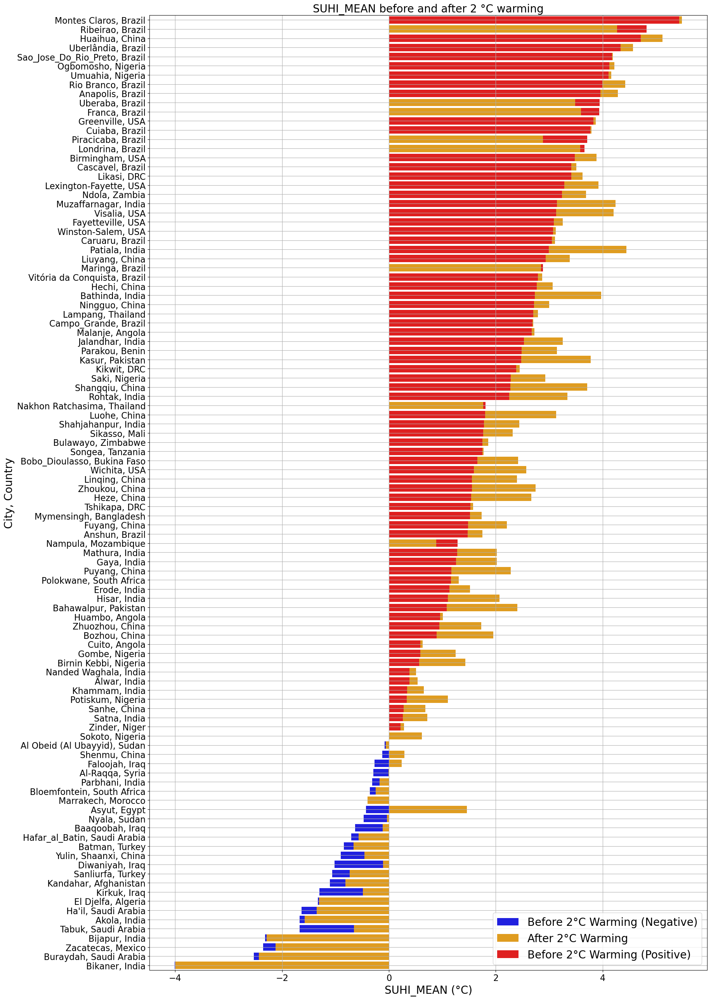

In [182]:
# Box plots

#set the font sizes
plt.rc('font', size=12)          # controls default text sizes
plt.rc('axes', titlesize=20)     # fontsize of the axes title
plt.rc('axes', labelsize=20)    # fontsize of the x and y labels
plt.rc('xtick', labelsize=16)    # fontsize of the tick labels
plt.rc('ytick', labelsize=16)    # fontsize of the tick labels
plt.rc('legend', fontsize=20)    # legend fontsize
plt.rc('figure', titlesize=30)  # fontsize of the figure title

fig, axes = plt.subplots(1,1, figsize = (20, 30))
fig.tight_layout(pad=15.0)
#fig.suptitle("Peak Magnitude")
#plt.subplots_adjust(top=0.94) # move subplot title position

#import the required package for normalising 
from sklearn import preprocessing
min_max_scaler = preprocessing.MinMaxScaler()

clrs = ['grey' if (x < 0) else 'red' for x in suhi_t2m_clim_proj_df['SUHI_MEAN'] ]

clrs2 = ['blue' if (x < 0) else 'red' for x in suhi_t2m_clim_proj_df['SUHI_MEAN'] ]

# again for change in neg suhi
sns.set_color_codes("pastel")
sns.barplot(x='SUHI_MEAN before Climate Change2', y='City, Country', 
            data=suhi_t2m_clim_proj_df,
            label="Before 2\u00b0C Warming (Negative)", color='blue')

# positive changes due to cc
sns.set_color_codes("pastel")
sns.barplot(x='SUHI_MEAN with Climate Change', y='City, Country', 
            data=suhi_t2m_clim_proj_df,
            label="After 2\u00b0C Warming", color='orange')

sns.set_color_codes("pastel")
sns.barplot(x='SUHI_MEAN before Climate Change3', y='City, Country', 
            data=suhi_t2m_clim_proj_df,
            label="Before 2\u00b0C Warming (Positive)", color='red')

sns.barplot(x='SUHI_MEAN med change neg', y='City, Country', 
            data=suhi_t2m_clim_proj_df,
             color='orange')



axes.set(xlabel = 'SUHI_MEAN (\u00b0C)', title = 'SUHI_MEAN before and after 2 \u00b0C warming')
axes.legend(loc = 4)
axes.grid()
#save plot
os.chdir(os.path.join(et.io.HOME, 'Documents', 'Python_Scripts', 'PROJECT','Chapter_6','climate_projection_plots',
                     'SUHI_MEAN_changes')) 
plt.savefig('suhi_w_cc_all_cities.png', bbox_inches = 'tight')

In [206]:
suhi_t2m_clim_proj_df

,CITY_COUNTRY,T2M,SUHI_MEAN,Lat,Lon,median_var_change,ten_percentile_var_change,ninety_percentile_var_change
0,AKOLA_INDIA,299.485046,-1.673250,20.733330,77.000000,0.095230,0.005127,0.486523
1,ALWAR_INDIA,296.920074,0.384180,27.562460,76.625000,0.154133,0.009174,0.795390
2,AL_OBEID_SUDAN,299.820831,-0.084193,13.184167,30.216667,0.027929,0.008781,0.672691
3,AL_RAQQA_SYRIA,293.018158,-0.291661,35.950000,39.016670,0.286938,-0.104994,1.148875
4,ANAPOLIS_BRAZIL,295.571381,3.959029,-16.326670,-48.952780,0.323612,-0.220029,1.175433
...,...,...,...,...,...,...,...,...
99,YULIN_SHAANXI_CHINA,283.959747,-0.902986,38.283840,109.731486,0.444767,0.146676,0.566735
100,ZACATECAS_MEXICO,289.250275,-2.353564,22.775590,-102.572180,0.232829,0.069748,0.404286
101,ZHOUKOU_CHINA,288.855682,1.553278,33.617368,114.646126,1.188888,0.360123,1.575808
102,ZHUOZHOU_CHINA,286.388824,0.940489,39.484559,115.978268,0.789790,0.197351,0.961681


In [208]:
all_monthly_data_df2

,EVI_U,EVI_D,LOG_AREA,WSA_D,ELEVATION_D,RH,TP,STD_ELEVATION_U,SUHI_MEAN,Overpass,month,year,CITY_COUNTRY,City,EVI_R,T2M,RERF_SUHI_MEAN,Season
0,0.174813,0.010057,1.545101,0.015964,24.251064,32.659958,0.000004,24.476705,-1.461481,13:30,7,2002,HUAMBO_ANGOLA,Huambo,0.164755,291.976410,-1.205886,JJA
1,0.163986,0.003686,1.546131,0.016138,24.251064,35.970322,0.000215,24.476705,-1.388989,13:30,8,2002,HUAMBO_ANGOLA,Huambo,0.160300,293.212769,-1.132758,JJA
2,0.172454,-0.026259,1.547159,0.014460,24.251064,38.924397,0.000651,24.476705,-0.144017,13:30,9,2002,HUAMBO_ANGOLA,Huambo,0.198712,294.594177,-0.345515,SON
3,0.286211,-0.038707,1.550228,0.007466,24.251064,83.382210,0.007687,24.476705,-0.155518,13:30,12,2002,HUAMBO_ANGOLA,Huambo,0.324918,291.866333,0.933958,DJF
4,0.378984,0.023308,1.551247,0.007449,24.251064,85.686295,0.009462,24.476705,0.603956,13:30,1,2003,HUAMBO_ANGOLA,Huambo,0.355676,291.865997,0.677440,DJF
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15413,0.428870,-0.113862,2.408240,0.001667,-60.369797,71.317200,0.005051,48.250392,5.432030,13:30,5,2020,GREENVILLE_USA,Greenville,0.542733,290.923340,5.570883,MAM
15414,0.417012,-0.120490,2.408240,-0.002854,-60.369797,71.337242,0.002981,48.250392,6.260467,13:30,7,2020,GREENVILLE_USA,Greenville,0.537502,299.510437,5.547204,JJA
15415,0.360948,-0.091001,2.408240,0.003838,-60.369797,74.295181,0.007240,48.250392,4.402636,13:30,9,2020,GREENVILLE_USA,Greenville,0.451950,294.176514,4.398217,SON
15416,0.310736,-0.072330,2.408240,0.005974,-60.369797,75.925438,0.005163,48.250392,2.365286,13:30,10,2020,GREENVILLE_USA,Greenville,0.383066,290.422638,3.327494,SON


In [ ]:
#city_year_group = all_monthly_data_df2[all_monthly_data_df2.year > 2002].copy()

def calc_pred_error_unknown_obvs(y_obs, y_pred_obs, y0):
    mse = mean_squared_error(y_obs, y_pred_obs) # calculate the mean squared error
    n = len(y_pred_obs)
    mean_pred = np.mean(y_pred_obs)
    
    stderr = mse*(1+1/float(n)+(y0 - mean_pred)**2/np.sum((y_pred_obs - mean_pred)**2))
    pred_interval = np.sqrt(stderr)
    return pred_interval

# calculate prediction error by city
for CITY_COUNTRY in CITY_COUNTRY_lat_lon.CITY_COUNTRY:
    
    obs = city_year_group[city_year_group.CITY_COUNTRY == CITY_COUNTRY].SUHI_MEAN
    preds = city_year_group[city_year_group.CITY_COUNTRY == CITY_COUNTRY].SUHI_MEAN_pred 

    city_pred_err = calc_pred_error(obs,preds)

In [210]:
all_monthly_data_df2.SUHI_MEAN.values

array([-1.46148123, -1.38898855, -0.1440174 , ...,  4.40263568,
        2.3652857 ,  1.96294661])

In [214]:
from sklearn.metrics import mean_squared_error

def calc_pred_error_unknown_obvs(y_obs, y_pred_obs, y0):
    mse = mean_squared_error(y_obs, y_pred_obs) # calculate the mean squared error
    n = len(y_pred_obs)
    mean_pred = np.mean(y_pred_obs)
    
    stderr = mse*(1+1/float(n)+(y0 - mean_pred)**2/np.sum((y_pred_obs - mean_pred)**2))
    pred_interval = np.sqrt(stderr)
    return pred_interval

In [249]:
def calc_pred_error(y, y_pred):                                       
    mse = mean_squared_error(y, y_pred) # calculate the mean squared error
    n = len(y_pred)
    mean_pred = np.mean(y_pred)
    y_pred_interval = []
    for y0 in y_pred:
        stderr = mse*(1+1/float(n)+(y0 - mean_pred)**2/np.sum((y_pred - mean_pred)**2))
        pred_interval = np.sqrt(stderr)
        y_pred_interval.append(pred_interval)
    return y_pred_interval

In [226]:
# annual pred errors
year_group = all_monthly_data_df2[all_monthly_data_df2.year > 2002].groupby(['CITY_COUNTRY','year']
                                                                ).mean(numeric_only=True).reset_index()

pred_intervals = []
y_obs = year_group.SUHI_MEAN.values
y_pred_obs = year_group.RERF_SUHI_MEAN.values

for y0 in year_group.SUHI_MEAN.values:
    pred_err_calc = calc_pred_error_unknown_obvs(y_obs, y_pred_obs, y0)
    pred_intervals.append(pred_err_calc)

In [227]:
min(pred_intervals),max(pred_intervals)

(0.5605909167157079, 0.5625394081278361)

In [251]:
# city specific
city_mean_pi = []
city_pi2 = []
city = []

for CITY_COUNTRY in CITY_COUNTRY_lat_lon.CITY_COUNTRY: 

    pred_intervals = []
    y_obs = all_monthly_data_df2[all_monthly_data_df2.CITY_COUNTRY == CITY_COUNTRY].SUHI_MEAN.values
    y_pred_obs = all_monthly_data_df2[all_monthly_data_df2.CITY_COUNTRY == CITY_COUNTRY].RERF_SUHI_MEAN.values

    for y0 in all_monthly_data_df2[all_monthly_data_df2.CITY_COUNTRY == CITY_COUNTRY].SUHI_MEAN.values:
        pred_err_calc = calc_pred_error_unknown_obvs(y_obs, y_pred_obs, y0)
        pred_intervals.append(pred_err_calc)
        
    pred_error1 = calc_pred_error(y_obs,y_pred_obs)
        
    city_mean_pi.append(np.mean(pred_intervals))
    city_pi2.append(np.mean(pred_error1))
    city.append(CITY_COUNTRY)

In [257]:
# city specific
city_mean_pi = []
city_pi2 = []
city = []

for CITY_COUNTRY in CITY_COUNTRY_lat_lon.CITY_COUNTRY: 

    pred_intervals = []
    y_obs = year_group[year_group.CITY_COUNTRY == CITY_COUNTRY].SUHI_MEAN.values
    y_pred_obs = year_group[year_group.CITY_COUNTRY == CITY_COUNTRY].RERF_SUHI_MEAN.values

    for y0 in year_group[year_group.CITY_COUNTRY == CITY_COUNTRY].SUHI_MEAN.values:
        pred_err_calc = calc_pred_error_unknown_obvs(y_obs, y_pred_obs, y0)
        pred_intervals.append(pred_err_calc)
        
    pred_error1 = calc_pred_error(y_obs,y_pred_obs)
        
    city_mean_pi.append(np.mean(pred_intervals))
    city_pi2.append(np.mean(pred_error1))
    city.append(CITY_COUNTRY)

In [259]:
pi_df = pd.DataFrame({'CITY_COUNTRY':city, 'Mean_PI':city_mean_pi, 'Mean_PI_2':city_pi2})

In [267]:
pi_df[pi_df.Mean_PI_2>2]

,CITY_COUNTRY,Mean_PI,Mean_PI_2
75,UMUAHIA_NIGERIA,2.86084,2.039858


In [270]:
pi_df = pd.merge(pi_df, CITY_COUNTRY_lat_lon[['CITY_COUNTRY','Lat','Lon']], on = 'CITY_COUNTRY')

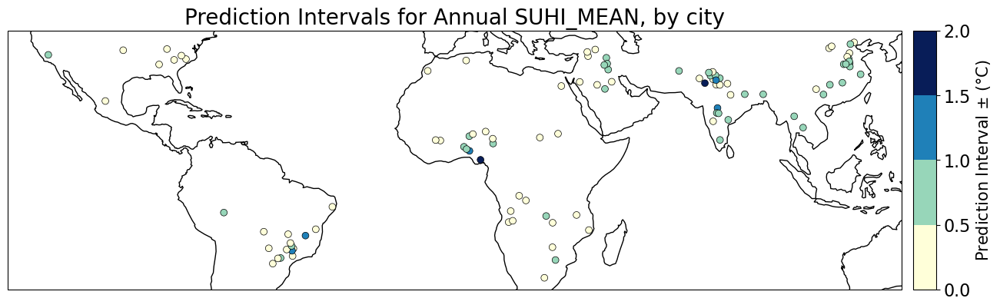

In [276]:
# create the colormap
scale_min = 0
scale_max = 2
cmap = plt.cm.YlGnBu  # define the colormap
# extract all colors from the .bwr map
cmaplist = [cmap(i) for i in range(cmap.N)]

# create the new map
cmap = mpl.colors.LinearSegmentedColormap.from_list(
    'Custom cmap', cmaplist, cmap.N)

bounds = np.linspace(scale_min, scale_max, 5)
norm = mpl.colors.BoundaryNorm(bounds, cmap.N)

city_lats = pi_df.Lat.values
city_lons = pi_df.Lon.values
pred_interval = pi_df.Mean_PI_2.values

####################################
fig = plt.figure(figsize=(15,10))
ax = plt.axes(projection=ccrs.PlateCarree(), 
              title='Prediction Intervals for Annual SUHI_MEAN, by city')
ax.coastlines()

im = ax.scatter(city_lons, city_lats, zorder=5, c=pred_interval, linewidths = 0.5, s =40,edgecolor = 'black',
               cmap= cmap, norm=norm)

#get size and extent of axes:
axpos = ax.get_position()
pos_x = axpos.x0 + axpos.width + 0.01 #+ 0.25*axpos.width
pos_y = axpos.y0  
cax_width = 0.02
cax_height = axpos.height
#create new axes where the colorbar should go.
#it should be next to the original axes and have the same height
pos_cax = fig.add_axes([pos_x,pos_y,cax_width,cax_height])

plt.colorbar(im, cax=pos_cax, label = 'Prediction Interval $\pm$ (\u00b0C)', cmap= cmap, norm=norm
            ,spacing='proportional', ticks=bounds, boundaries=bounds, format='%0.1f')


In [97]:
spread_df[spread_df.CITY_COUNTRY.isin(cols)]#.median_var_change.mean()

,CITY_COUNTRY,Lat,Lon,median_var_change,ten_percentile_var_change,ninety_percentile_var_change
5,ANSHUN_CHINA,26.244410,105.932401,0.271640,-0.166354,0.424480
17,BOZHOU_CHINA,33.870279,115.776985,1.059938,0.344774,1.371134
31,FUYANG_CHINA,32.889497,115.815213,0.726794,0.213930,1.040811
37,HECHI_CHINA,24.697683,108.080828,0.295223,0.001613,0.690738
38,HEZE_CHINA,35.245103,115.459799,1.128844,0.292557,1.433029
40,HUAIHUA_CHINA,27.549440,109.959170,0.412184,0.002614,0.945814
51,LINQING_CHINA,36.845560,115.711670,0.840932,0.207413,1.098735
52,LIUYANG_CHINA,28.150000,113.633330,0.456105,0.039299,0.705558
54,LUOHE_CHINA,33.573149,114.024063,1.324883,0.360387,1.832597
66,NINGGUO_CHINA,30.620899,118.979636,0.289999,0.123105,0.762368


In [99]:
print('ten_perc',spread_df[spread_df.CITY_COUNTRY.isin(cols)].ten_percentile_var_change.mean()),
print('median', spread_df[spread_df.CITY_COUNTRY.isin(cols)].median_var_change.mean()),
print('ninety_perc', spread_df[spread_df.CITY_COUNTRY.isin(cols)].ninety_percentile_var_change.mean())

ten_perc 0.18461559622292953
mediam 0.7410536947471591
ninety_perc 1.0523554608449803


In [100]:
spread_df

,CITY_COUNTRY,Lat,Lon,median_var_change,ten_percentile_var_change,ninety_percentile_var_change
0,AKOLA_INDIA,20.733330,77.000000,0.095230,0.005127,0.486523
1,ALWAR_INDIA,27.562460,76.625000,0.154133,0.009174,0.795390
2,AL_OBEID_SUDAN,13.184167,30.216667,0.027929,0.008781,0.672691
3,AL_RAQQA_SYRIA,35.950000,39.016670,0.286938,-0.104994,1.148875
4,ANAPOLIS_BRAZIL,-16.326670,-48.952780,0.323612,-0.220029,1.175433
...,...,...,...,...,...,...
99,YULIN_SHAANXI_CHINA,38.283840,109.731486,0.444767,0.146676,0.566735
100,ZACATECAS_MEXICO,22.775590,-102.572180,0.232829,0.069748,0.404286
101,ZHOUKOU_CHINA,33.617368,114.646126,1.188888,0.360123,1.575808
102,ZHUOZHOU_CHINA,39.484559,115.978268,0.789790,0.197351,0.961681


In [162]:
#############################################################################
############# Look at the changes in the warmest 3 months ###################
#############################################################################

# first get the median, 10th and 90th percentile changes for each season 
seasons = ['MAM','JJA','SON','DJF']
season_spread_df = pd.DataFrame ()

for i in range(len(CITY_COUNTRY_list)):
    CITY_COUNTRY = CITY_COUNTRY_list[i]
    lat = (model_annual_mean_pred_df[model_annual_mean_pred_df['CITY_COUNTRY'] == CITY_COUNTRY].Lat.values[0])
    lon = (model_annual_mean_pred_df[model_annual_mean_pred_df['CITY_COUNTRY'] == CITY_COUNTRY].Lon.values[0])
        
    for season in seasons:
        var_changes = (model_season_mean_pred_df[(model_season_mean_pred_df['CITY_COUNTRY'] == CITY_COUNTRY)&
                                   (model_season_mean_pred_df['Season'] == season)].SUHI_CHANGE)

        if var_changes.size == 0:
            df = pd.DataFrame({'CITY_COUNTRY': [CITY_COUNTRY], 'Lat':[lat], 'Lon':[lon],'Season':[season], 
                  'median_change':[np.nan],
                  'ten_percentile_change':[np.nan],
                  'ninety_percentile_change':[np.nan]}, index = [i])
        else:
            
            df = pd.DataFrame({'CITY_COUNTRY': [CITY_COUNTRY], 'Lat':[lat], 'Lon':[lon],'Season':[season],
                  'median_change':[np.percentile(var_changes, 50)],
                  'ten_percentile_change':[np.percentile(var_changes, 10)],
                  'ninety_percentile_change':[np.percentile(var_changes, 90)]}, index = [i])

        season_spread_df = pd.concat([season_spread_df, df])

# note: UMUAHIA_NIGERIA has no data for MAM and JJA

#for col in all_monthly_data_df2.columns:
#    print(col)

In [163]:
# get the warmest month for each city
mon_mean_t2m = all_monthly_data_df2.groupby(['CITY_COUNTRY','Season']).mean(numeric_only = True).reset_index(
                )[['CITY_COUNTRY','Season','T2M','SUHI_MEAN']]

max_t2m_seasons_df = pd.DataFrame ()
for CITY_COUNTRY in CITY_COUNTRY_lat_lon.CITY_COUNTRY:
    max_t2m = mon_mean_t2m[mon_mean_t2m.CITY_COUNTRY == CITY_COUNTRY].T2M.max()
    max_season = mon_mean_t2m[(mon_mean_t2m.CITY_COUNTRY == CITY_COUNTRY)&(mon_mean_t2m.T2M == max_t2m)].copy()
    max_t2m_seasons_df = pd.concat([max_t2m_seasons_df,max_season])

max_t2m_seasons_df = max_t2m_seasons_df.reset_index(drop = True)

# add in the changes in SUHI_MEAN, by percentile
max_t2m_seasons_df = pd.merge(max_t2m_seasons_df, season_spread_df, on = ['CITY_COUNTRY','Season'],how = 'left')

In [164]:
max_t2m_seasons_df

,CITY_COUNTRY,Season,T2M,SUHI_MEAN,Lat,Lon,median_change,ten_percentile_change,ninety_percentile_change
0,HUAMBO_ANGOLA,SON,292.590179,0.159207,-12.776110,15.739170,-5.298191e-08,-0.954901,0.378855
1,ANAPOLIS_BRAZIL,SON,297.282074,3.091597,-16.326670,-48.952780,2.509669e-07,-1.134775,1.552593
2,FRANCA_BRAZIL,SON,296.258759,3.227755,-20.538610,-47.400830,-1.715960e+00,-2.797298,0.743430
3,PIRACICABA_BRAZIL,DJF,297.262390,5.431035,-22.725280,-47.649170,-9.346159e-02,-1.689964,0.145177
4,RIBEIRAO_BRAZIL,DJF,297.524567,6.862342,-21.177500,-47.810280,2.442574e-06,-2.330877,1.166488
...,...,...,...,...,...,...,...,...,...
99,BAAQOOBAH_IRAQ,JJA,310.776001,-0.569629,33.750000,44.641111,2.578678e-01,-0.019408,0.955407
100,FALOOJAH_IRAQ,JJA,309.400146,0.633605,33.355810,43.786120,-1.882252e-07,-0.113951,0.183821
101,POLOKWANE_SOUTH_AFRICA,DJF,294.636597,1.973903,-23.904480,29.468850,3.012245e-01,-0.215951,0.876922
102,BATMAN_TURKEY,JJA,302.732025,-1.085841,37.887380,41.132210,4.780391e-01,-0.019215,0.934865


In [109]:
t2m.max()

NameError: name 't2m' is not defined

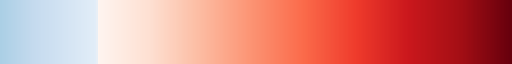

In [165]:
# Custom colormaps for the MEAN_SUHI during warm season, as it goes from -4 to 8 


# creation of custom colormap so the white part is still centered on zero
cmap = plt.cm.Reds # define the colormap
# extract all colors from the .bwr map
cmaplist = [cmap(i) for i in range(cmap.N)]

# create the new map
cmap = mpl.colors.LinearSegmentedColormap.from_list(
    'Custom cmap', cmaplist, cmap.N)

cmap_low = plt.cm.Blues_r # define the colormap
# extract all colors from the .bwr map
cmaplist_low = [cmap_low(i) for i in range(cmap_low.N)]

# create the new map
cmap_low = mpl.colors.LinearSegmentedColormap.from_list(
    'Custom cmap', cmaplist_low, cmap_low.N)

length_colormap_low = int((256/0.6)-256)    

cmaplist_low2 = cmaplist_low[length_colormap_low:230]

lengthlow2 = length_colormap_low - (256-230)

# create the new map
#cmap_low2 = mpl.colors.LinearSegmentedColormap.from_list(
#    'Custom cmap', cmaplist_low2, cmap_low2.N)

cmaplist_all = (cmaplist_low2 + cmaplist)

cmap_all = mpl.colors.LinearSegmentedColormap.from_list(
    'Custom cmap', cmaplist_all, (lengthlow2 +cmap.N))

cmap_all

In [166]:
seasons

['MAM', 'JJA', 'SON', 'DJF']

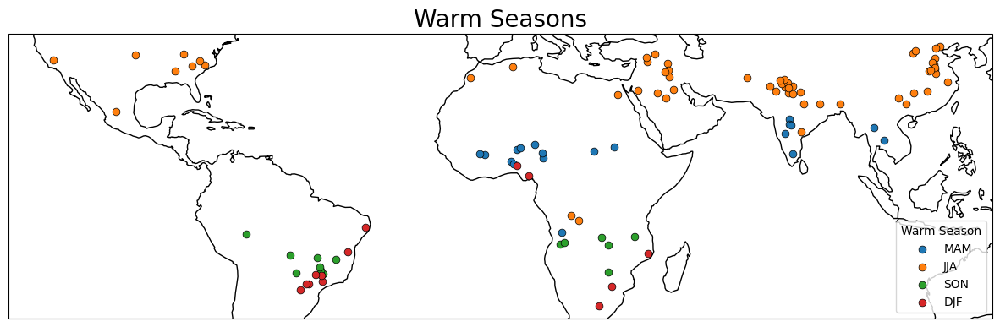

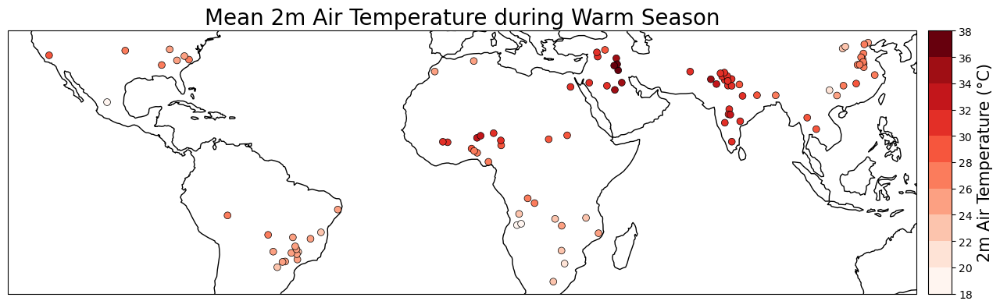

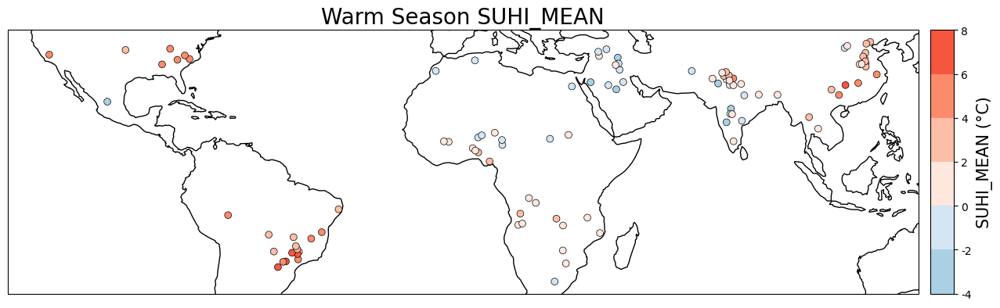

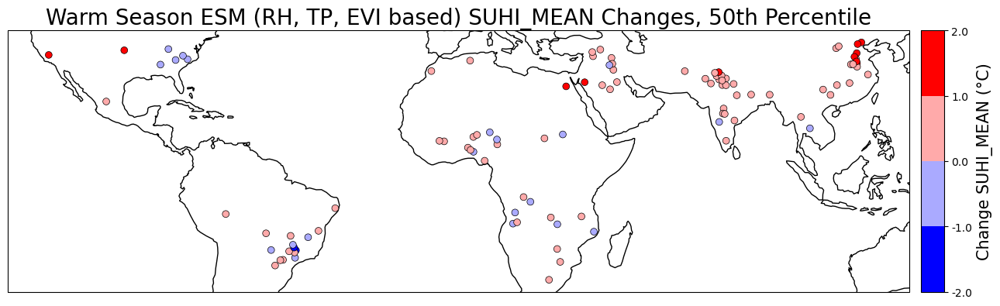

In [167]:
### Plot with the warm season
######################################################
fig = plt.figure(figsize=(15,10))
ax = plt.axes(projection=ccrs.PlateCarree(), 
              title='Warm Seasons')
ax.coastlines()

for season in seasons:
    df = max_t2m_seasons_df[max_t2m_seasons_df.Season == season]
    city_lons = df.Lon
    city_lats = df.Lat
    ax.scatter(city_lons, city_lats, zorder=5, label = season, linewidths = 0.5, s =40,edgecolor = 'black')
    
ax.legend(title = 'Warm Season', loc = 4)
#save figure as png
os.chdir(os.path.join(et.io.HOME, 'Documents', 'Python_Scripts', 'PROJECT','Chapter_6','climate_projection_plots',
                     'SUHI_MEAN_changes'))   
plt.savefig('warm_season_month.png'.format(climate_var), bbox_inches = 'tight')
######################################################

## plots with colorscales

city_lats = max_t2m_seasons_df.Lat.values
city_lons = max_t2m_seasons_df.Lon.values
t2m = max_t2m_seasons_df.T2M.values - 273.15
suhi = max_t2m_seasons_df.SUHI_MEAN.values
median_change = max_t2m_seasons_df.median_change.values
ten_percentile_change = max_t2m_seasons_df.ten_percentile_change.values
ninety_percentile_change = max_t2m_seasons_df.ninety_percentile_change.values

### Plot with the air temp during the warm season 
######################################################
# create the colormap
scale_min = 18
scale_max = 38
cmap = plt.cm.Reds # define the colormap
# extract all colors from the map
cmaplist = [cmap(i) for i in range(cmap.N)]

# create the new map
cmap = mpl.colors.LinearSegmentedColormap.from_list(
    'Custom cmap', cmaplist, cmap.N)

bounds = np.linspace(scale_min, scale_max, 11)
norm = mpl.colors.BoundaryNorm(bounds, cmap.N)

fig = plt.figure(figsize=(15,10))
ax = plt.axes(projection=ccrs.PlateCarree(), 
              title='Mean 2m Air Temperature during Warm Season')
ax.coastlines()

im = ax.scatter(city_lons, city_lats, zorder=5, c=t2m, linewidths = 0.5, s =40,edgecolor = 'black',
               cmap= cmap, norm=norm)

#get size and extent of axes:
axpos = ax.get_position()
pos_x = axpos.x0 + axpos.width + 0.01 #+ 0.25*axpos.width
pos_y = axpos.y0  
cax_width = 0.02
cax_height = axpos.height
#create new axes where the colorbar should go.
#it should be next to the original axes and have the same height
pos_cax = fig.add_axes([pos_x,pos_y,cax_width,cax_height])

plt.colorbar(im, cax=pos_cax, label = '2m Air Temperature (\u00b0C)', cmap= cmap, norm=norm
            ,spacing='proportional', ticks=bounds, boundaries=bounds, format='%1i')

#save figure as png
os.chdir(os.path.join(et.io.HOME, 'Documents', 'Python_Scripts', 'PROJECT','Chapter_6','climate_projection_plots',
                     'SUHI_MEAN_changes'))   
plt.savefig('warm_season_2m_air_temp.png'.format(climate_var), bbox_inches = 'tight')
######################################################
### Plot of the SUHI_MEAN during the warm season

# create the colormap
scale_min = -4
scale_max = 8
cmap = plt.cm.bwr  # define the colormap
# extract all colors from the .bwr map
cmaplist = [cmap(i) for i in range(cmap.N)]

# create the new map
cmap = mpl.colors.LinearSegmentedColormap.from_list(
    'Custom cmap', cmaplist, cmap.N)

bounds = np.linspace(scale_min, scale_max, 7)
norm = mpl.colors.BoundaryNorm(bounds, cmap.N)

fig = plt.figure(figsize=(15,10))
ax = plt.axes(projection=ccrs.PlateCarree(), 
              title='Warm Season SUHI_MEAN')
ax.coastlines()

im = ax.scatter(city_lons, city_lats, zorder=5, c=suhi, linewidths = 0.5, s =40,edgecolor = 'black',
               cmap= cmap_all, norm=norm)

#get size and extent of axes:
axpos = ax.get_position()
pos_x = axpos.x0 + axpos.width + 0.01 #+ 0.25*axpos.width
pos_y = axpos.y0  
cax_width = 0.02
cax_height = axpos.height
#create new axes where the colorbar should go.
#it should be next to the original axes and have the same height
pos_cax = fig.add_axes([pos_x,pos_y,cax_width,cax_height])

plt.colorbar(im, cax=pos_cax, label = 'SUHI_MEAN (\u00b0C)', cmap= cmap, norm=norm
            ,spacing='proportional', ticks=bounds, boundaries=bounds, format='%1i')

#save figure as png
os.chdir(os.path.join(et.io.HOME, 'Documents', 'Python_Scripts', 'PROJECT','Chapter_6','climate_projection_plots',
                     'SUHI_MEAN_changes'))   
plt.savefig('warm_season_suhi_mean.png'.format(climate_var), bbox_inches = 'tight')
######################################################
### Plot of the median SUHI_MEAN change during the warm season 

# create the colormap
scale_min = -2
scale_max = 2
cmap = plt.cm.bwr  # define the colormap
# extract all colors from the .bwr map
cmaplist = [cmap(i) for i in range(cmap.N)]

# create the new map
cmap = mpl.colors.LinearSegmentedColormap.from_list(
    'Custom cmap', cmaplist, cmap.N)

bounds = np.linspace(scale_min, scale_max, 5)
norm = mpl.colors.BoundaryNorm(bounds, cmap.N)

fig = plt.figure(figsize=(15,10))
ax = plt.axes(projection=ccrs.PlateCarree(), 
              title='Warm Season ESM (RH, TP, EVI based) SUHI_MEAN Changes, 50th Percentile')
ax.coastlines()

im = ax.scatter(city_lons, city_lats, zorder=5, c=median_change, linewidths = 0.5, s =40,edgecolor = 'black',
               cmap= cmap, norm=norm)

#get size and extent of axes:
axpos = ax.get_position()
pos_x = axpos.x0 + axpos.width + 0.01 #+ 0.25*axpos.width
pos_y = axpos.y0  
cax_width = 0.02
cax_height = axpos.height
#create new axes where the colorbar should go.
#it should be next to the original axes and have the same height
pos_cax = fig.add_axes([pos_x,pos_y,cax_width,cax_height])

plt.colorbar(im, cax=pos_cax, label = 'Change SUHI_MEAN (\u00b0C)', cmap= cmap, norm=norm
            ,spacing='proportional', ticks=bounds, boundaries=bounds, format='%0.1f')

#save figure as png
os.chdir(os.path.join(et.io.HOME, 'Documents', 'Python_Scripts', 'PROJECT','Chapter_6','climate_projection_plots',
                     'SUHI_MEAN_changes'))   
plt.savefig('warm_season_suhi_change.png'.format(climate_var), bbox_inches = 'tight')
####################################

In [168]:
t2m.min()

18.7901

In [169]:
suhi.max()

7.312386791235845

In [115]:
len(median_change[median_change <0]), len(median_change[median_change >0])

(23, 78)

In [121]:
cols = [col for col in spread_df.CITY_COUNTRY if 'CHINA' in col]

In [126]:
print('ten_perc',max_t2m_seasons_df[max_t2m_seasons_df.CITY_COUNTRY.isin(cols)].ten_percentile_change.mean()),
print('median', max_t2m_seasons_df[max_t2m_seasons_df.CITY_COUNTRY.isin(cols)].median_change.mean()),
print('ninety_perc', max_t2m_seasons_df[max_t2m_seasons_df.CITY_COUNTRY.isin(cols)].ninety_percentile_change.mean())

ten_perc 0.20144394636523785
median 0.7696209831349529
ninety_perc 1.1499166039305833


In [171]:
max_t2m_seasons_df[max_t2m_seasons_df.median_change > 1]

,CITY_COUNTRY,Season,T2M,SUHI_MEAN,Lat,Lon,median_change,ten_percentile_change,ninety_percentile_change
6,LINQING_CHINA,JJA,300.008484,2.981082,36.845560,115.711670,1.414466,0.408023,1.763707
30,TABUK_SAUDI_ARABIA,JJA,303.188507,-2.056018,28.383330,36.583330,1.090423,0.002279,1.523534
49,BOZHOU_CHINA,JJA,299.984497,2.383942,33.870279,115.776985,1.165498,0.449093,1.544156
57,PUYANG_CHINA,JJA,300.412323,2.060721,35.770510,115.043769,1.027185,0.394877,1.338616
58,SANHE_CHINA,JJA,298.960724,2.049306,39.981938,117.071330,1.052508,0.223487,1.573626
59,SHANGQIU_CHINA,JJA,300.188812,3.220012,34.424422,115.651378,1.209776,0.463577,1.623875
62,ZHUOZHOU_CHINA,JJA,299.162842,2.517380,39.484559,115.978268,1.203439,0.427992,1.523508
68,JALANDHAR_INDIA,JJA,303.748077,2.808349,31.325556,75.579167,1.245265,0.274867,1.395924
86,VISALIA_USA,JJA,301.492310,4.593855,36.324100,-119.307347,1.573887,0.318519,1.875179
87,WICHITA_USA,JJA,299.560150,2.193190,37.688848,-97.336226,1.124348,0.131546,1.920550


In [179]:
print(' china, over 1 deg',
len(max_t2m_seasons_df[(max_t2m_seasons_df.CITY_COUNTRY.isin(cols))&(max_t2m_seasons_df.median_change > 1)])/
    len(max_t2m_seasons_df[(max_t2m_seasons_df.CITY_COUNTRY.isin(cols))]))

print(' china, over 0.5 deg',
len(max_t2m_seasons_df[(max_t2m_seasons_df.CITY_COUNTRY.isin(cols))&(max_t2m_seasons_df.median_change > 0.5)])/
    len(max_t2m_seasons_df[(max_t2m_seasons_df.CITY_COUNTRY.isin(cols))]))



 china, over 1 deg 0.35294117647058826
 china, over 0.5 deg 0.6470588235294118


In [136]:
max_t2m_seasons_df[(max_t2m_seasons_df.CITY_COUNTRY.isin(cols))&(max_t2m_seasons_df.Lat > 33)].median_change.mean()

1.0049883561381334

In [129]:
max_t2m_seasons_df[max_t2m_seasons_df.median_change > 1.5]

,CITY_COUNTRY,Season,T2M,SUHI_MEAN,Lat,Lon,median_change,ten_percentile_change,ninety_percentile_change
86,VISALIA_USA,JJA,301.492310,4.593855,36.32410,-119.307347,1.573887,0.318519,1.875179
96,ASYUT_EGYPT,JJA,304.792389,-0.044104,27.18096,31.183680,1.700661,0.001557,1.774660


In [116]:
CITY_COUNTRY_lat_lon.CITY_COUNTRY.values

array(['HUAMBO_ANGOLA', 'ANAPOLIS_BRAZIL', 'FRANCA_BRAZIL',
       'PIRACICABA_BRAZIL', 'RIBEIRAO_BRAZIL',
       'SAO_JOSE_DO_RIO_PRETO_BRAZIL', 'LINQING_CHINA', 'AKOLA_INDIA',
       'HISAR_INDIA', 'PARBHANI_INDIA', 'BULAWAYO_ZIMBABWE',
       'MALANJE_ANGOLA', 'PARAKOU_BENIN', 'CAMPO_GRANDE_BRAZIL',
       'CASCAVEL_BRAZIL', 'BOBO_DIOULASSO_BURKINA_FASO', 'ALWAR_INDIA',
       'BATHINDA_INDIA', 'BIKANER_INDIA', 'MUZAFFARNAGAR_INDIA',
       'PATIALA_INDIA', 'DIWANIYAH_IRAQ', 'SIKASSO_MALI', 'ZINDER_NIGER',
       'GOMBE_NIGERIA', 'OGBOMOSHO_NIGERIA', 'POTISKUM_NIGERIA',
       'SAKI_NIGERIA', 'BURAYDAH_SAUDI_ARABIA',
       'HAFAR_AL_BATIN_SAUDI_ARABIA', 'TABUK_SAUDI_ARABIA', 'NYALA_SUDAN',
       'BLOEMFONTEIN_SOUTH_AFRICA', 'CARUARU_BRAZIL',
       'MONTES_CLAROS_BRAZIL', 'UBERABA_BRAZIL', 'UBERLANDIA_BRAZIL',
       'VITORIA_DA_CONQUISTA_BRAZIL', 'KIRKUK_IRAQ', 'ZACATECAS_MEXICO',
       'MARRARECH_MOROCCO', 'HA_IL_SAUDI_ARABIA', 'LAMPANG_THAILAND',
       'EL_DJELFA_ALGERIA', 'C

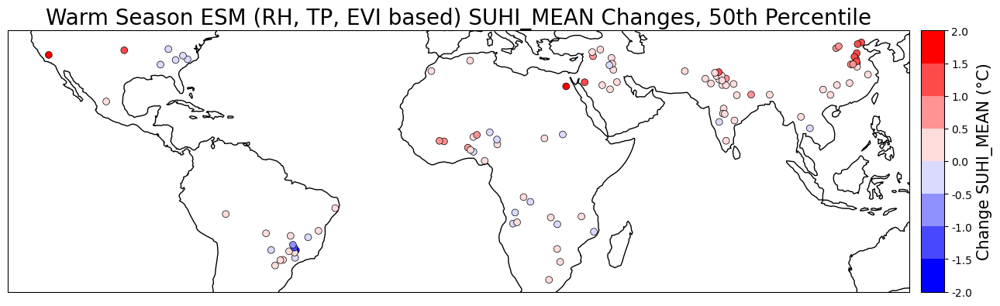

In [300]:
### Plot of the median SUHI_MEAN change during the warm season 

# create the colormap
scale_min = -2
scale_max = 2
cmap = plt.cm.bwr  # define the colormap
# extract all colors from the .bwr map
cmaplist = [cmap(i) for i in range(cmap.N)]

# create the new map
cmap = mpl.colors.LinearSegmentedColormap.from_list(
    'Custom cmap', cmaplist, cmap.N)

bounds = np.linspace(scale_min, scale_max, 9)
norm = mpl.colors.BoundaryNorm(bounds, cmap.N)

fig = plt.figure(figsize=(15,10))
ax = plt.axes(projection=ccrs.PlateCarree(), 
              title='Warm Season ESM (RH, TP, EVI based) SUHI_MEAN Changes, 50th Percentile')
ax.coastlines()

im = ax.scatter(city_lons, city_lats, zorder=5, c=median_change, linewidths = 0.5, s =40,edgecolor = 'black',
               cmap= cmap, norm=norm)

#get size and extent of axes:
axpos = ax.get_position()
pos_x = axpos.x0 + axpos.width + 0.01 #+ 0.25*axpos.width
pos_y = axpos.y0  
cax_width = 0.02
cax_height = axpos.height
#create new axes where the colorbar should go.
#it should be next to the original axes and have the same height
pos_cax = fig.add_axes([pos_x,pos_y,cax_width,cax_height])

plt.colorbar(im, cax=pos_cax, label = 'Change SUHI_MEAN (\u00b0C)', cmap= cmap, norm=norm
            ,spacing='proportional', ticks=bounds, boundaries=bounds, format='%0.1f')

In [86]:
model_annual_mean_pred_df

,CITY_COUNTRY,Lat,Lon,Annual_Mean_SUHI_MEAN_change,Annual_Mean_SUHI_MEAN_CC,Model
0,AKOLA_INDIA,20.733330,77.000000,0.095230,-0.577657,UKESM1-1-LL
1,ALWAR_INDIA,27.562460,76.625000,0.027677,0.283565,UKESM1-1-LL
2,AL_OBEID_SUDAN,13.184167,30.216667,0.027929,-0.217912,UKESM1-1-LL
3,AL_RAQQA_SYRIA,35.950000,39.016670,-0.207415,-0.690967,UKESM1-1-LL
4,ANAPOLIS_BRAZIL,-16.326670,-48.952780,-0.476409,3.098957,UKESM1-1-LL
...,...,...,...,...,...,...
99,YULIN_SHAANXI_CHINA,38.283840,109.731486,0.609488,-0.178347,CanESM5
100,ZACATECAS_MEXICO,22.775590,-102.572180,0.410504,-1.888614,CanESM5
101,ZHOUKOU_CHINA,33.617368,114.646126,1.686337,3.359516,CanESM5
102,ZHUOZHOU_CHINA,39.484559,115.978268,0.822277,1.355271,CanESM5


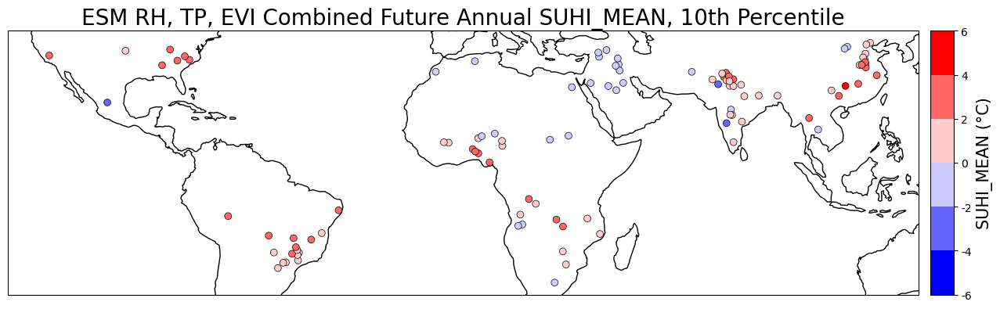

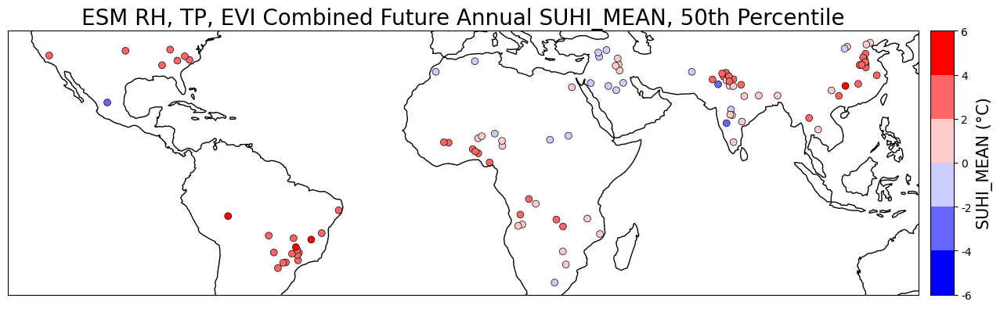

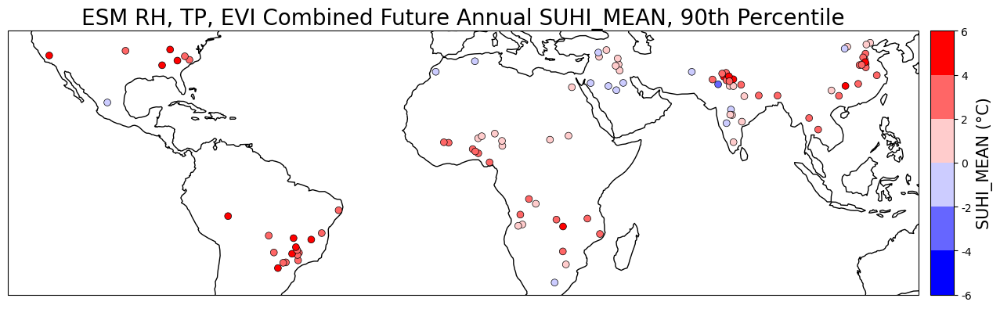

In [84]:
#################################################################
######## ACTUAL PROJECTED VALUES (RATHER THAN CHANGES) ##########
#################################################################


############################################################################
######## MODEL SPREAD: 10th, 50th, 90th Percentiles ########################
############################################################################

# get the median, 10th and 90th percentile changes
spread_df = pd.DataFrame ()
for i in range(len(CITY_COUNTRY_list)):
    CITY_COUNTRY = CITY_COUNTRY_list[i]
    var_changes = (model_annual_mean_pred_df[model_annual_mean_pred_df['CITY_COUNTRY'] == CITY_COUNTRY].
                Annual_Mean_SUHI_MEAN_CC)
    lat = (model_annual_mean_pred_df[model_annual_mean_pred_df['CITY_COUNTRY'] == CITY_COUNTRY].Lat.values[0])
    lon = (model_annual_mean_pred_df[model_annual_mean_pred_df['CITY_COUNTRY'] == CITY_COUNTRY].Lon.values[0])

    df = pd.DataFrame({'CITY_COUNTRY': [CITY_COUNTRY], 'Lat':[lat], 'Lon':[lon], 
              'median_var_change':[np.percentile(var_changes, 50)],
              'ten_percentile_var_change':[np.percentile(var_changes, 10)],
              'ninety_percentile_var_change':[np.percentile(var_changes, 90)]}, index = [i])

    spread_df = pd.concat([spread_df, df])

# create the colormap
scale_min = -6
scale_max = 6
cmap = plt.cm.bwr  # define the colormap
# extract all colors from the .bwr map
cmaplist = [cmap(i) for i in range(cmap.N)]

# create the new map
cmap = mpl.colors.LinearSegmentedColormap.from_list(
    'Custom cmap', cmaplist, cmap.N)

bounds = np.linspace(scale_min, scale_max, 7)
norm = mpl.colors.BoundaryNorm(bounds, cmap.N)

city_lats = spread_df.Lat.values
city_lons = spread_df.Lon.values
median_var_change = spread_df.median_var_change.values
ten_percentile_var_change = spread_df.ten_percentile_var_change.values
ninety_percentile_var_change = spread_df.ninety_percentile_var_change.values

####################################
fig = plt.figure(figsize=(15,10))
ax = plt.axes(projection=ccrs.PlateCarree(), 
              title='ESM RH, TP, EVI Combined Future Annual SUHI_MEAN, 10th Percentile')
ax.coastlines()

im = ax.scatter(city_lons, city_lats, zorder=5, c=ten_percentile_var_change, linewidths = 0.5, s =40,edgecolor = 'black',
               cmap= cmap, norm=norm)

#get size and extent of axes:
axpos = ax.get_position()
pos_x = axpos.x0 + axpos.width + 0.01 #+ 0.25*axpos.width
pos_y = axpos.y0  
cax_width = 0.02
cax_height = axpos.height
#create new axes where the colorbar should go.
#it should be next to the original axes and have the same height
pos_cax = fig.add_axes([pos_x,pos_y,cax_width,cax_height])

plt.colorbar(im, cax=pos_cax, label = 'SUHI_MEAN (\u00b0C)', cmap= cmap, norm=norm
            ,spacing='proportional', ticks=bounds, boundaries=bounds, format='%1i')

#save figure as png
#os.chdir(os.path.join(et.io.HOME, 'Documents', 'Python_Scripts', 'PROJECT','Chapter_6','climate_projection_plots',
#                     'SUHI_MEAN_changes'))   
#plt.savefig('esm_rh_tp_evi_suhi_mean_change_10_percentile.png'.format(climate_var), bbox_inches = 'tight')
####################################

fig = plt.figure(figsize=(15,10))
ax = plt.axes(projection=ccrs.PlateCarree(), 
              title='ESM RH, TP, EVI Combined Future Annual SUHI_MEAN, 50th Percentile')
ax.coastlines()

im = ax.scatter(city_lons, city_lats, zorder=5, c=median_var_change, linewidths = 0.5, s =40,edgecolor = 'black',
               cmap= cmap, norm=norm)

#get size and extent of axes:
axpos = ax.get_position()
pos_x = axpos.x0 + axpos.width + 0.01 #+ 0.25*axpos.width
pos_y = axpos.y0  
cax_width = 0.02
cax_height = axpos.height
#create new axes where the colorbar should go.
#it should be next to the original axes and have the same height
pos_cax = fig.add_axes([pos_x,pos_y,cax_width,cax_height])

plt.colorbar(im, cax=pos_cax, label = 'SUHI_MEAN (\u00b0C)', cmap= cmap, norm=norm
            ,spacing='proportional', ticks=bounds, boundaries=bounds, format='%1i')

#save figure as png
#os.chdir(os.path.join(et.io.HOME, 'Documents', 'Python_Scripts', 'PROJECT','Chapter_6','climate_projection_plots',
#                     'SUHI_MEAN_changes'))   
#plt.savefig('esm_rh_tp_evi_suhi_mean_change_50_percentile.png'.format(climate_var), bbox_inches = 'tight')
####################################

fig = plt.figure(figsize=(15,10))
ax = plt.axes(projection=ccrs.PlateCarree(), 
              title='ESM RH, TP, EVI Combined Future Annual SUHI_MEAN, 90th Percentile')
ax.coastlines()

im = ax.scatter(city_lons, city_lats, zorder=5, c=ninety_percentile_var_change, linewidths = 0.5, s =40,edgecolor = 'black',
               cmap= cmap, norm=norm)

#get size and extent of axes:
axpos = ax.get_position()
pos_x = axpos.x0 + axpos.width + 0.01 #+ 0.25*axpos.width
pos_y = axpos.y0  
cax_width = 0.02
cax_height = axpos.height
#create new axes where the colorbar should go.
#it should be next to the original axes and have the same height
pos_cax = fig.add_axes([pos_x,pos_y,cax_width,cax_height])

plt.colorbar(im, cax=pos_cax, label = 'SUHI_MEAN (\u00b0C)', cmap= cmap, norm=norm
            ,spacing='proportional', ticks=bounds, boundaries=bounds, format='%1i')

#save figure as png
#os.chdir(os.path.join(et.io.HOME, 'Documents', 'Python_Scripts', 'PROJECT','Chapter_6','climate_projection_plots',
#                     'SUHI_MEAN_changes'))   
#plt.savefig('esm_rh_tp_evi_suhi_mean_change_90_percentile.png', bbox_inches = 'tight')

In [85]:
spread_df.ten_percentile_var_change.min(), spread_df.ninety_percentile_var_change.max()

(-2.3112949987971385, 5.333633951790766)

NameError: name 'LAI_city_monthly_means' is not defined

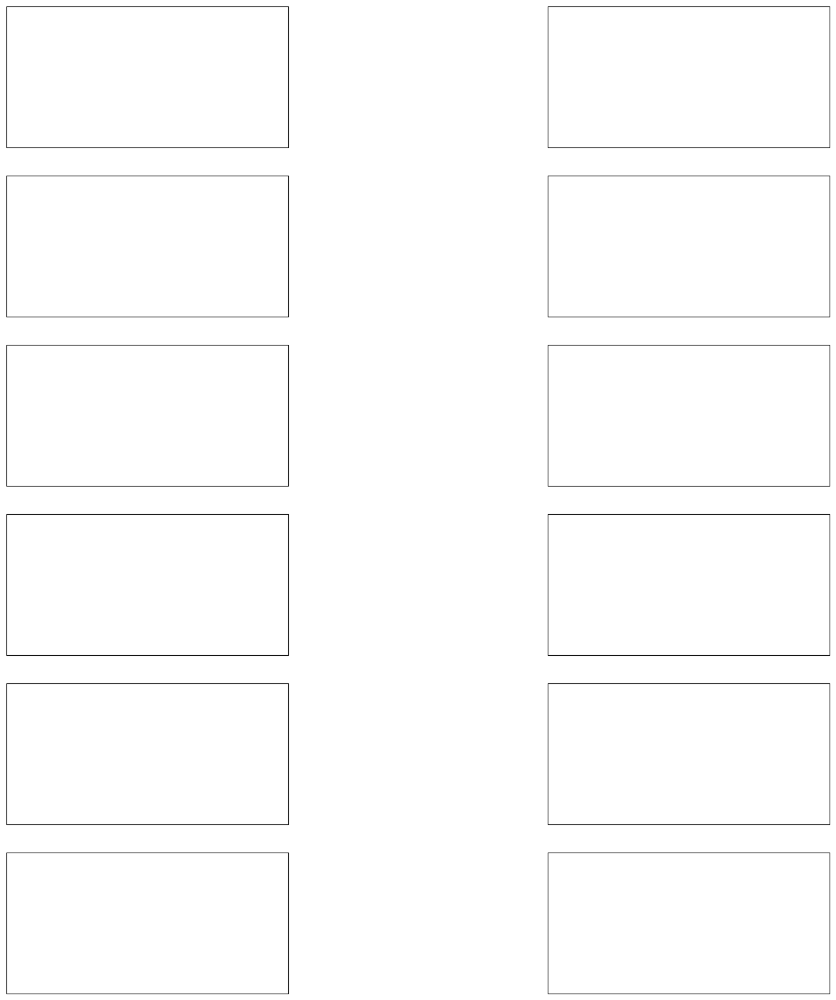

In [95]:
# look at the monthly mean percentage change

colorbar_min = -30
colorbar_max = 130
# create the custom colormap so the values are discrete
cmap = plt.cm.BrBG  # define the colormap
# extract all colors from the .bwr map
cmaplist = [cmap(i) for i in range(cmap.N)]
cmaplist = cmaplist[98:]
# create the new map
cmap = mpl.colors.LinearSegmentedColormap.from_list(
    'Custom cmap', cmaplist, cmap.N)

# define the bins and normalize
bounds = np.linspace(int(colorbar_min), int(colorbar_max), 9)
norm = mpl.colors.BoundaryNorm(bounds, cmap.N)


#title='Percentage Change from Pre-industrial and 2 degC LAI')

#create the axes
fig, axes = plt.subplots(6,2 ,figsize=(20,20), subplot_kw={"projection": ccrs.PlateCarree()})

row_num = 0
col_num = 0
for month in list(set(LAI_city_monthly_means.Month)):

    df = LAI_city_monthly_means[LAI_city_monthly_means.Month == month]
    city_lons = df.Lon
    city_lats= df.Lat
    Perc_Inc = df.Perc_Inc
    
    axes[row_num,col_num].coastlines()
    im = axes[row_num,col_num].scatter(city_lons, city_lats, zorder=5, c=Perc_Inc, linewidths = 0.5,
                                        s =40,edgecolor = 'black',cmap= cmap, norm = norm)
    
    
    axes[row_num,col_num].set(title = month)
    
    # move the col and row nums on for the next plot
    if col_num == 1:
        col_num = 0
        row_num = row_num + 1
    
    elif col_num == 0:
        col_num = 1
        
        
#get size and extent of axes:
axpos = ax.get_position()
pos_x = axpos.x0 + axpos.width +0.01  #+ 0.25*axpos.width
pos_y = 0.1
cax_width = 0.02
cax_height = 0.8 #2*axpos.height
#create new axes where the colorbar should go.
#it should be next to the original axes and have the same height
pos_cax = fig.add_axes([pos_x,pos_y,cax_width,cax_height])

fig.colorbar(im, cax = pos_cax,  label = '% Change Annual Mean LAI', cmap= cmap, norm=norm
            ,spacing='proportional', ticks=bounds, boundaries=bounds, format='%1i')    


In [372]:
LAI_annual_means[LAI_annual_means.LAI_Inc < 0]

,CITY_COUNTRY,Lat,Lon,Model,LAI_Preind,LAI_2002_2020,LAI_Proj,LAI_Proj_1deg,LAI_DIFF,LAI_Inc
2,AKOLA_INDIA,20.733330,77.000000,CNRM-CM6-1,1.674823,1.674828,1.674820,1.674820,-2.741814e-06,-1.637076e-06
8,ALWAR_INDIA,27.562460,76.625000,CNRM-CM6-1,1.316086,1.316088,1.316085,1.316085,-9.536743e-07,-7.246292e-07
11,ALWAR_INDIA,27.562460,76.625000,UKESM1-1-LL,0.598740,0.659971,0.593147,0.653318,-5.593181e-03,-9.341589e-03
14,AL_OBEID_SUDAN,13.184167,30.216667,CNRM-CM6-1,0.737155,0.737157,0.737154,0.737154,-1.072884e-06,-1.455439e-06
23,AL_RAQQA_SYRIA,35.950000,39.016670,UKESM1-1-LL,0.629439,0.604344,0.568595,0.608349,-6.084484e-02,-9.666513e-02
...,...,...,...,...,...,...,...,...,...,...
580,VITORIA_DA_CONQUISTA_BRAZIL,-14.866110,319.160560,IPSL-CM6A-LR,2.825958,2.530566,2.548259,2.569091,-2.776997e-01,-9.826745e-02
581,VITORIA_DA_CONQUISTA_BRAZIL,-14.866110,319.160560,UKESM1-1-LL,5.274057,4.387234,4.281524,4.398966,-9.925332e-01,-1.881916e-01
589,WINSTON_SALEM_USA,36.102764,279.739509,BCC-CSM2-MR,2.477757,2.836127,2.423808,2.743345,-5.394936e-02,-2.177346e-02
593,WINSTON_SALEM_USA,36.102764,279.739509,UKESM1-1-LL,3.818883,3.566493,3.621538,3.566724,-1.973450e-01,-5.167611e-02


In [111]:
LAI_diff.min(), LAI_diff.max()

(-0.42043352, 1.8590474)

In [105]:
annual_EVI_df = all_monthly_data_df.groupby(['CITY_COUNTRY']).mean(numeric_only = True).reset_index()

In [369]:
annual_EVI_df[annual_EVI_df.CITY_COUNTRY == 'TABUK_SAUDI_ARABIA'].EVI_R

90    0.088933
Name: EVI_R, dtype: float64

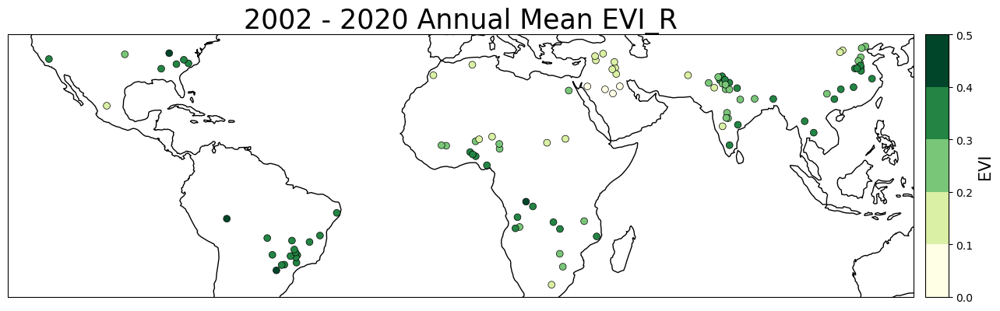

In [107]:
colorbar_min = 0
colorbar_max = 0.5
# create the custom colormap so the values are discrete
cmap = plt.cm.YlGn  # define the colormap
# extract all colors from the .bwr map
cmaplist = [cmap(i) for i in range(cmap.N)]

# create the new map
cmap = mpl.colors.LinearSegmentedColormap.from_list(
    'Custom cmap', cmaplist, cmap.N)

# define the bins and normalize
bounds = np.linspace(colorbar_min, colorbar_max, 6)
norm = mpl.colors.BoundaryNorm(bounds, cmap.N)

city_lats = city_means.Lat.values
city_lons = city_means.Lon.values
EVI_R = all_monthly_data_df.groupby(['CITY_COUNTRY']).mean(numeric_only = True).reset_index().EVI_R.values

fig = plt.figure(figsize=(15,10))
ax = plt.axes(projection=ccrs.PlateCarree(), title='2002 - 2020 Annual Mean EVI_R')
ax.coastlines()
im = ax.scatter(city_lons, city_lats, zorder=5, c=EVI_R, linewidths = 0.5, s =40,edgecolor = 'black',
               cmap= cmap, norm=norm)

#get size and extent of axes:
axpos = ax.get_position()
pos_x = axpos.x0 + axpos.width + 0.01 #+ 0.25*axpos.width
pos_y = axpos.y0  
cax_width = 0.02
cax_height = axpos.height
#create new axes where the colorbar should go.
#it should be next to the original axes and have the same height
pos_cax = fig.add_axes([pos_x,pos_y,cax_width,cax_height])

plt.colorbar(im, cax=pos_cax, label = 'EVI', cmap= cmap, norm=norm
            ,spacing='proportional', ticks=bounds, boundaries=bounds, format='%0.1f')




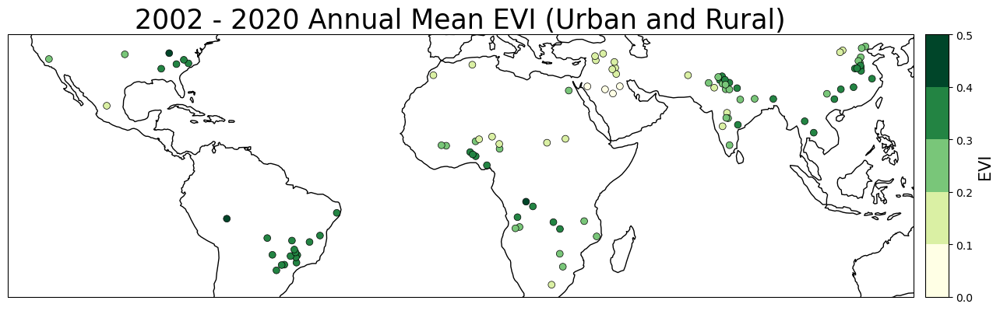

In [108]:
colorbar_min = 0
colorbar_max = 0.5
# create the custom colormap so the values are discrete
cmap = plt.cm.YlGn  # define the colormap
# extract all colors from the .bwr map
cmaplist = [cmap(i) for i in range(cmap.N)]

# create the new map
cmap = mpl.colors.LinearSegmentedColormap.from_list(
    'Custom cmap', cmaplist, cmap.N)

# define the bins and normalize
bounds = np.linspace(colorbar_min, colorbar_max, 6)
norm = mpl.colors.BoundaryNorm(bounds, cmap.N)

city_lats = city_means.Lat.values
city_lons = city_means.Lon.values
EVI_ALL = (0.9*all_monthly_data_df.groupby(['CITY_COUNTRY']).mean(numeric_only = True).reset_index().EVI_R.values 
        + 0.1 * all_monthly_data_df.groupby(['CITY_COUNTRY']).mean(numeric_only = True).reset_index().EVI_U.values)

fig = plt.figure(figsize=(15,10))
ax = plt.axes(projection=ccrs.PlateCarree(), title='2002 - 2020 Annual Mean EVI (Urban and Rural)')
ax.coastlines()
im = ax.scatter(city_lons, city_lats, zorder=5, c=EVI_ALL, linewidths = 0.5, s =40,edgecolor = 'black',
               cmap= cmap, norm=norm)

#get size and extent of axes:
axpos = ax.get_position()
pos_x = axpos.x0 + axpos.width + 0.01 #+ 0.25*axpos.width
pos_y = axpos.y0  
cax_width = 0.02
cax_height = axpos.height
#create new axes where the colorbar should go.
#it should be next to the original axes and have the same height
pos_cax = fig.add_axes([pos_x,pos_y,cax_width,cax_height])

plt.colorbar(im, cax=pos_cax, label = 'EVI', cmap= cmap, norm=norm
            ,spacing='proportional', ticks=bounds, boundaries=bounds, format='%0.1f')




In [121]:
EVI_seasonal_cycle = EVI_seasonal_cycle.rename(columns = {'month': 'Month'})
LAI_model_seasonal_cycle = LAI_Proj_df.groupby(['CITY_COUNTRY','Lat','Lon','Month']).mean(numeric_only = True).reset_index()
veg_compare_df = pd.merge(EVI_seasonal_cycle, LAI_model_seasonal_cycle, on = ['CITY_COUNTRY','Month'], how = 'inner')

In [129]:
veg_compare_df

,CITY_COUNTRY,Month,MONTH_MEAN_EVI_R,MONTH_MEAN_EVI_U,MONTH_MEAN_EVI_D,Lat,Lon,LAI_Preind,LAI_2002_2020,LAI_Proj,LAI_Proj_1deg
0,AKOLA_INDIA,1,0.210476,0.177498,-0.032978,20.73333,77.0000,0.857576,0.906215,0.953396,0.916095
1,AKOLA_INDIA,2,0.174945,0.165323,-0.009623,20.73333,77.0000,0.731737,0.805349,0.826203,0.802995
2,AKOLA_INDIA,3,0.142635,0.159688,0.017052,20.73333,77.0000,0.672997,0.773902,0.787009,0.729356
3,AKOLA_INDIA,4,0.117406,0.145579,0.028173,20.73333,77.0000,0.661540,0.732620,0.752518,0.724190
4,AKOLA_INDIA,5,0.103160,0.130983,0.027823,20.73333,77.0000,0.645649,0.674426,0.714803,0.693581
...,...,...,...,...,...,...,...,...,...,...,...
1242,ZINDER_NIGER,8,0.212179,0.169292,-0.042888,13.80716,8.9881,0.790958,1.388039,1.751362,1.391897
1243,ZINDER_NIGER,9,0.222508,0.174824,-0.047684,13.80716,8.9881,0.918555,1.682549,2.100500,1.662686
1244,ZINDER_NIGER,10,0.176088,0.136029,-0.040059,13.80716,8.9881,0.821413,1.396160,1.597943,1.327299
1245,ZINDER_NIGER,11,0.150993,0.119150,-0.031844,13.80716,8.9881,0.655513,1.017601,1.091065,0.937816


[Text(0.5, 1.0, 'MONTH_MEAN_EVI_R vs LAI_Preind'),
 Text(0.5, 0, 'MONTH_MEAN_EVI_R'),
 Text(0, 0.5, 'LAI_Preind')]

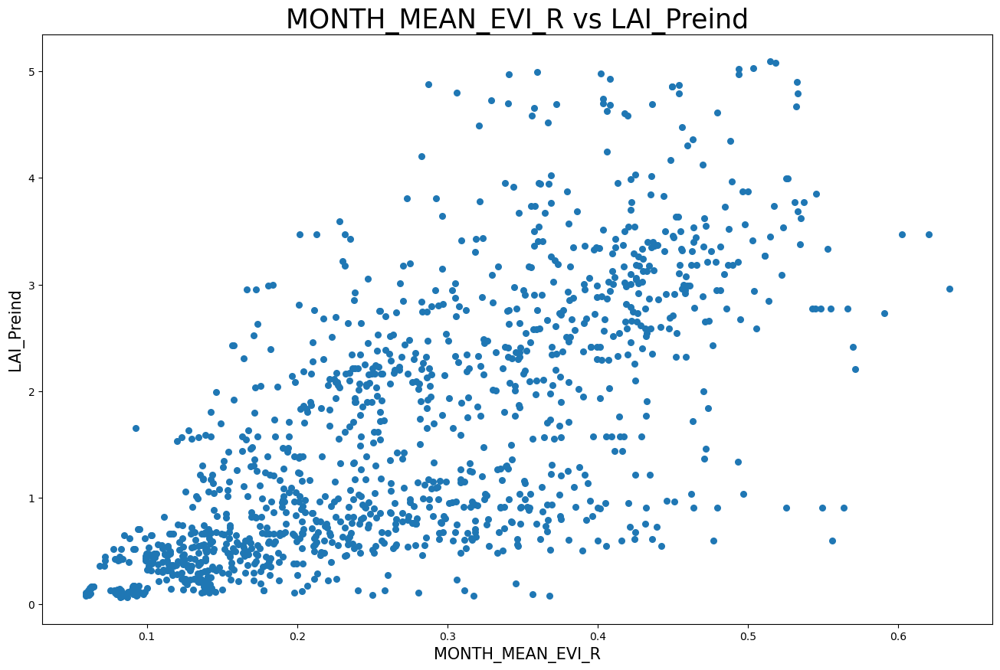

In [141]:
## Veg Comparison scatter
fig, axes = plt.subplots(1,1, figsize = (16, 10))

x_variable = 'MONTH_MEAN_EVI_R'
y_variable = 'LAI_Preind'

x = veg_compare_df[x_variable]
y = veg_compare_df[y_variable]

# EVI_R vs RH
axes.scatter(x,y, s = 30)
axes.set(title = '{} vs {}'.format(x_variable,y_variable), xlabel = x_variable, ylabel =y_variable)

[Text(0.5, 1.0, 'MONTH_MEAN_EVI_U vs LAI_Preind'),
 Text(0.5, 0, 'MONTH_MEAN_EVI_U'),
 Text(0, 0.5, 'LAI_Preind')]

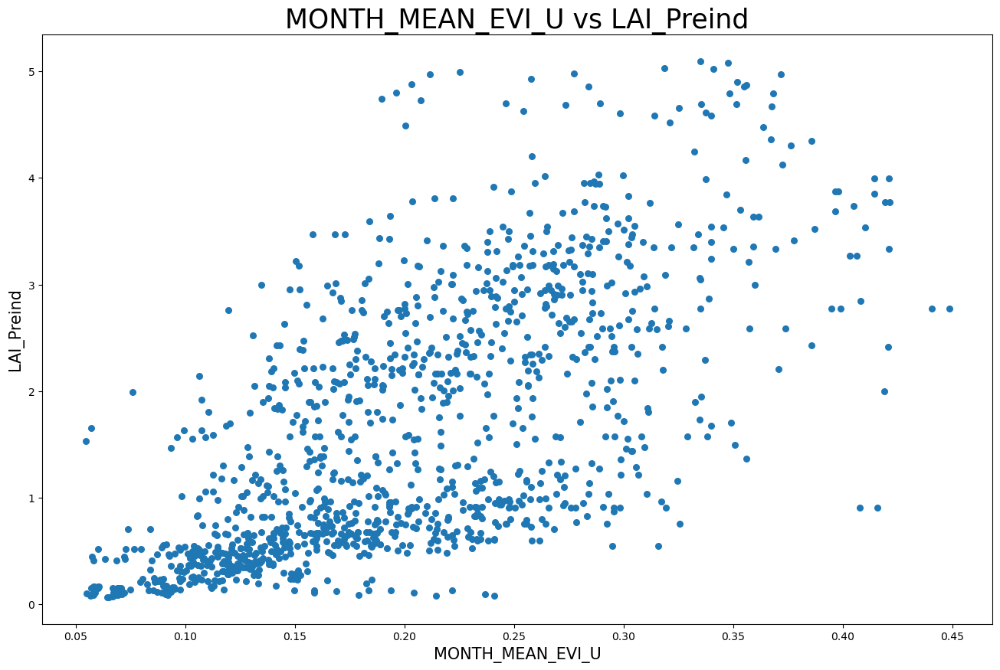

In [140]:
## Veg Comparison scatter
fig, axes = plt.subplots(1,1, figsize = (16, 10))

x_variable = 'MONTH_MEAN_EVI_U'
y_variable = 'LAI_Preind'

x = veg_compare_df[x_variable]
y = veg_compare_df[y_variable]

# EVI_R vs RH
axes.scatter(x,y, s = 30)
axes.set(title = '{} vs {}'.format(x_variable,y_variable), xlabel = x_variable, ylabel =y_variable)

[Text(0.5, 1.0, 'LAI_Preind vs LAI_Proj'),
 Text(0.5, 0, 'LAI_Preind'),
 Text(0, 0.5, 'LAI_Proj')]

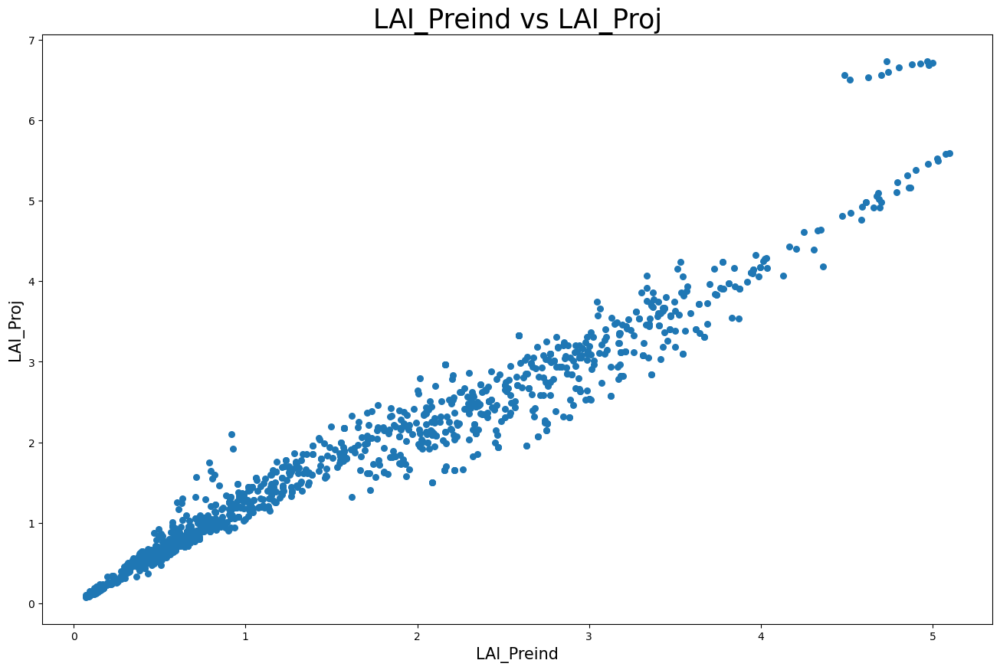

In [136]:
## Veg Comparison scatter
fig, axes = plt.subplots(1,1, figsize = (16, 10))

x_variable ='LAI_Preind'
y_variable = 'LAI_Proj'

x = veg_compare_df[x_variable]
y = veg_compare_df[y_variable]

# EVI_R vs RH
axes.scatter(x,y, s = 30)
axes.set(title = '{} vs {}'.format(x_variable,y_variable), xlabel = x_variable, ylabel =y_variable)